# FT-ICR analysis - PART 1

Created on 01 March 2020 for the Pentatrap experiment

@author: Menno Door<br>
@contact: door+fticr@mpi-k.de<br>
@license: MIT license

### Refenences :

used toolkit of Jonas Karthein for PI-ICR as template :) thank you!!<br>

For references reguarding the theory behind ft-icr detection and analysis methods, please check the references.md file.

### Introduction

This part of the analysis does the conversion of the raw data to penning trap eigenfrequency data. You will be able to group, filter and average data and then fit spectra and/or evaluate pnp phase data to determine these frequencies.

### Important remark:

This is more a visualization thing, especially for bigger data sets i would recommend to do this using a normal python script including some multiprocessing.

Please be patient with this one! Gathering information on paths in fhds structures may take a while, loading data too. So please look at the circle on the top right corner (jupyter notebook), if its filled, there is still something going on and you should just wait.

### Requirements:

The following code was written for Python 3.7/3.8. The required libraries are listed below with a rough description for their task in the code.

    fhds (inhouse data storage, https://git.mpi-hd.mpg.de/Pentatrap/fhds)
    h5py (data storage, easier to distribute)
    pandas (data organisation, calculation and visualization)
    numpy (calculation)
    matplotlib (plotting)
    scipy (chi square fitting)
    jupyter (Python notebook environment)
    ipywidgets (https://ipywidgets.readthedocs.io/en/latest/user_install.html)
    plotly (plotting, https://github.com/plotly/plotly.py#installation)
    qgrid (data visualization, https://github.com/quantopian/qgrid#installation)

### ToDo 

- check for phase correlation here with single phases, short and long phases and unwrap.

In [1]:
# standard libs
from datetime import datetime
from pathlib import Path
import os, json
from pprint import pprint

# math and data
import numpy as np
import scipy
import pandas as pd
import h5py

# visualization
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
%matplotlib inline
import matplotlib.pyplot as plt
import qgrid
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode()
plt.rcParams['figure.figsize'] = (10, 4)

%load_ext autoreload
%autoreload 2

# this package
from fhds import fhds, interface
from fticr_toolkit import *
#from trap_control import fitaxialClass

### Step 1: Load raw data and inspect

The input_data filename should be either a folder following fhds rules (append ".fhds" to the folder name please) or a hdf5 file.

In [2]:
###   P A R A M E T E R   L I S T   ( this is especially used for batch processing using the papermill package )
#measurement_folder = 'Z:/DATA_for_ANALYSIS/analysis_Menno/20_Re_Os_ratio_cancellation/187Re29+_187Os29+_187Re29+_24'
#measurement_folder = "E:\\\\local_analysis\\132Xe_208Pb\\132Xe26+_208Pb41+_132Xe26+_6"
measurement_folder = "E:\\local_analysis\\Yb170174\\170Yb42+_174Yb43+_170Yb42+_13"
measurement_folder = "E:\\local_analysis\\Yb170174\\170Yb42+_174Yb43+_170Yb42+_12"
#measurement_folder = "E:\\local_analysis\\YbMeta\\174Yb43+_1"
measurement_folder = "E:\\local_analysis\\Yb168172\\172Yb43+_168Yb42+_172Yb43+_5"
#measurement_folder = "E:\\local_analysis\\Yb172174\\174Yb42+_172Yb42+_174Yb42+_var_10"
#measurement_folder = "Z:\Measurements\\174Yb41+_unity_feedback_3khz_2"
measurement_folder = "Z:\\DATA_for_ANALYSIS\\analysis_Menno\\Yb174172\\174Yb42+_172Yb42+_174Yb42+_var_10"
#measurement_folder = "Z:\\DATA_for_ANALYSIS\\analysis_Menno\\91_Characterization_ReOsCancellation\\test_of_dipole+quad_systematics"
#measurement_folder = "Z:\Measurements\\132Xe25+_208Pb38+_132Xe25+_test"
#measurement_folder = "Z:\\Measurements\\test_magphase_trap2_3"
measurement_folder = "G:\\Yb\\172174_var3_opti\\174Yb42+_172Yb42+_174Yb42+_var3_53_opti"
measurement_folder = "G:\\Yb\\172176_var\\176Yb42+_172Yb42+_176Yb42+_var_4"
measurement_folder = "G:\\Yb\\17241+42+_binding_var\\172Yb42+_172Yb41+_172Yb42+_var_9"
measurement_folder = "G:\\Yb_dualPnPtest\\172Yb43+_dual_num_nup_test_1"
measurement_folder = "G:\\Yb\\17241+42+_binding_var_dualPnP\\172Yb42+_172Yb41+_172Yb42+_dual_3"
measurement_folder = "G:\\Yb\\YbC_ICS_num\\12C3+_172Yb43+_12C3+_num_ICS_6"
measurement_folder = "E:\\\\local_analysis\\Ne\\12C6+_20Ne10+_12C6+_15\\"
measurement_folder = "G:\\JJ_Test_2023_with_ion\\209Bi00+_209Bi41+_209Bi42+_Trap3_JJ_notransport_5"
measurement_folder = "E:\\\\local_analysis\\Ne\\12C6+_20Ne10+_12C6+_15\\"


#measurement_folder = "Z:/DATA_for_ANALYSIS/analysis_Menno/20_Re_Os_ratio_cancellation/187Re29+_187Os29+_187Re29+_24"
input_file = 'pnp_dip_unwrap.fhds'
output_folder = "./part1_data/"
use_settings_file = True
settings = {
    #"grouping": [0,-1,0,-1,0,-1,0,-1,0,-1], # use -1 to not use the axial
    #"grouping": [0,0,0,1,1,1,1,2,2,2], # use -1 to not use the axial
    #"grouping": [0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,1,1,1,1,1], # use -1 to not use the axial
    "grouping": [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], # use -1 to not use the axial
    "reuse_averages": True,
    "reuse_fitdata": False,
    "single_axial_fits": False,
    "fixed_phase_readout": False,
    "make_filter_settings_file": 'filter_settings_auto.csv',
    "filter_axial_by_phase": False,
    "input_file": False,
    "downsample": 5,
    "fit_func": 'pavel',
    "plot": True,
    "sigma": 0.1
}

In [3]:
if use_settings_file:
    settings = data_conversion.load_settings(measurement_folder, settings)
print("settings", settings)

if settings["input_file"]:
    input_file = settings["input_file"]

data, meas_config, output_folder = data_conversion.load_data(measurement_folder=measurement_folder, 
                          input_data=input_file, 
                          output_folder="part1_data",
                          measurement_script = "unwrap_n_measure_repeat"
                         )

print(os.getcwd())

#  'position_1': {   'configuration': {   'traps': {   2: {  
positions = [k for k in meas_config.keys() if k.startswith('position')]
traps = ['trap'+str(k) for k in meas_config[positions[0]]['configuration']['traps'].keys()]
print(positions)
print(traps)

pprint(meas_config)

#pprint(meas_config)
data_root = data["meas_data"]

settings {'grouping': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'reuse_averages': True, 'reuse_fitdata': False, 'single_axial_fits': False, 'fixed_phase_readout': False, 'make_filter_settings_file': 'filter_settings_auto.csv', 'filter_axial_by_phase': False, 'input_file': False, 'downsample': 5, 'fit_func': 'pavel', 'plot': True, 'sigma': 0.1}

 >>> WARNING!!! output_folder already exists! files will maybe be overwritten! <<< 


 >>> I hope you are in PART1, loading raw measurement data now... <<< 

E:\local_analysis\Ne\12C6+_20Ne10+_12C6+_15
['position_1', 'position_2']
['trap2', 'trap3']
{'accumulation_time': [{'nu_z': False, 'time': 0.1},
                       {'nu_z': True, 'time': 20.05}],
 'freq': 'nu_p',
 'max_time': '12:00',
 'mode': 'arbitrary',
 'number_of_averages': 10,
 'number_of_averages_unwrap': 5,
 'phase_freq_span': 100,
 'position_1': {'configuration': {'cooling_time': 3.0,
                                  'couple_time': 0.008,
                  

In [4]:
####
# Chech the data structure, cycles and such
#
####

mcycles = list(data_root.keys())
print("root group names / MAIN CYCLES : ", mcycles )

measurement_types = list( data_root[mcycles[0]].keys() )
print("check out first group / MEASUREMENT TYPES : ", measurement_types )
meas_name = None
for mtype in measurement_types:
    if 'unwrap' not in mtype:
        meas_name = mtype 
print(meas_name)

#pnp_subcycles = data_root[mcycles[0]][measurement_types[0]].keys()
#pnp_subcycles = data_conversion.sort_cycles(pnp_subcycles) # This is important, dont forget it!
#print("check out 2nd level of "+measurement_types[0]+" (SUBCYCLES?): ", pnp_subcycles)
pnp_subcycles = {}
for mc in mcycles:
    cycle_list = data_root[mc][meas_name].keys()
    cycle_list = data_conversion.sort_cycles(cycle_list) # This is important, dont forget it!
    pnp_subcycles[mc] = cycle_list
print("check out 2nd level of "+meas_name+" (SUBCYCLES?): ", pnp_subcycles)

def printpath(name, obj):
    print(name, obj.path)
#data_root.visititems(printpath)

pprint(meas_config)

root group names / MAIN CYCLES :  ['cycle1', 'cycle2']
check out first group / MEASUREMENT TYPES :  ['pnp_measurement', 'pre_unwrap']
pnp_measurement
check out 2nd level of pnp_measurement (SUBCYCLES?):  {'cycle1': ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9', 'cycle10', 'cycle11', 'cycle12', 'cycle13', 'cycle14', 'cycle15', 'cycle16', 'cycle17', 'cycle18', 'cycle19', 'cycle20', 'cycle21', 'cycle22', 'cycle23', 'cycle24', 'cycle25', 'cycle26', 'cycle27', 'cycle28', 'cycle29', 'cycle30', 'cycle31', 'cycle32', 'cycle33', 'cycle34', 'cycle35'], 'cycle2': ['cycle1']}
{'accumulation_time': [{'nu_z': False, 'time': 0.1},
                       {'nu_z': True, 'time': 20.05}],
 'freq': 'nu_p',
 'max_time': '12:00',
 'mode': 'arbitrary',
 'number_of_averages': 10,
 'number_of_averages_unwrap': 5,
 'phase_freq_span': 100,
 'position_1': {'configuration': {'cooling_time': 3.0,
                                  'couple_time': 0.008,
                    

In [5]:
## get the keys of the data we are intereseted in...

#raw_data_keys = data_conversion.get_data_paths( data_root, attr_type = ("amplitude", "phase") ) # super slow in fhds since all meta json files have to be read
raw_data_keys = data_conversion.get_data_paths( data_root, name_includes= ("nu_z", "phase") )
#pprint(raw_data_keys)

In [6]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.

@interact
def spectrum_plot(key=raw_data_keys, center = widgets.FloatText(0), span = widgets.FloatText(20), downsample_factor = widgets.IntText(1)):
    try:        
        spec = data_conversion.Spectrum(data_root[key])
        dep = spec.attrs["depth"]
        tr = spec.attrs["tr"]
        if center == 0:
            pos = spec.attrs["position"]
            trap = spec.attrs["trap"][-1]
            center = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
        spec.cut(center, span)
        
        ds_freqs, ds_amps = spec.downsample(downsample_factor, inplace=False)
        
        print(data_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.plot(ds_freqs, ds_amps, linewidth=4)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+spec.attrs["position"]+"    "+str(spec.attrs["trap"])+"    avg: "+str(spec.attrs["avg_num"]))
        print(spec.attrs.keys())
        print('U0', dep, 'tr', tr, 'ce', dep*tr)
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        raise
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('cycle1/pnp_measurement/cycle1/position_1/trap2/tim…

In [7]:
# Check phases to filter data

grouping = settings.get("grouping", [0,0,0,0,0,0,0,0,0,0])


phase_data = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "average_idx", "amp" ] )

for mc in mcycles:
    pnp_measurement_grp = data_root[mc]["pnp_measurement"]
    for subcycle in pnp_subcycles[mc]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        print('\n mc sc', mc, subcycle, end=' ')

        for pos in positions:
            position_grp = subcycle_grp[pos]
            
            for trap in traps:
                
                #print(trap)
                try:
                    trap_grp = position_grp[trap]
                except:
                    continue
                                    
                if trap_grp is None:
                    continue
                        
                #trap_grp.sort_values(by="time", inplace=True)
                only_attr = {"type": "phase"}
                nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
            
                for name, dset in trap_grp.items():
                    
                    # check if this is the correct type of data to average
                    skip = False
                    for attr, val in only_attr.items():
                        if dset.attrs[attr] != val:
                            skip = True
                    if skip:
                        #print('why?')
                        continue

                    #print(counter, grouping[counter])
                    
                    # NOTE: this here is sadly very important: the dset[:] has to come before
                    #       getting the attributes, due to some automated update in fhds
                    dset_data = dset[:]
                    dset_attrs = {}
                    for key, val in dset.attrs.items():
                        dset_attrs[key] = val
                        
                    freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])
                    
                    idx = (np.abs(freqs - nu_z)).argmin()
                    phase = dset_data[1][idx]
                    amp = dset_data[0][idx]
                    
                    #print("subcycle", subcycle, "pos", pos, "trap", trap, "name", name, "\tnu_z", nu_z, "\tphase", phase, "\tamp", amp, end="\n")
                    print('.', end='')
                    
                    # add they data
                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, 0, amp ] , index=phase_data.columns)
                    phase_data = phase_data.append(dset, ignore_index=True)




 mc sc cycle1 cycle1 ................................................................................
 mc sc cycle1 cycle2 ................................................................................
 mc sc cycle1 cycle3 ................................................................................
 mc sc cycle1 cycle4 ................................................................................
 mc sc cycle1 cycle5 ................................................................................
 mc sc cycle1 cycle6 ................................................................................
 mc sc cycle1 cycle7 ................................................................................
 mc sc cycle1 cycle8 ................................................................................
 mc sc cycle1 cycle9 ................................................................................
 mc sc cycle1 cycle10 ...........................................................

In [8]:
print(" >>> PHASE DATA >>> ")
phase_data["acc_time"] = phase_data["acc_time"].astype(str)
phase_data["time"] = pd.to_datetime(phase_data['time'], format='%Y%m%d_%H%M%S.%f')
fig = px.scatter(phase_data, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
fig.show()

ref_acc = phase_data['acc_time'].min()
ref_data = phase_data[phase_data.acc_time == ref_acc]

filter_settings = pd.DataFrame(columns=['mcycle','trap','position','min_cycle','max_cycle'])

std_threshold = 0.9
for gname, grp in ref_data.groupby(['mcycle','trap','position']):
    mc, t, po = gname
    ref_stds = []
    ref_meds = []
    stop = None
    start = 0
    for sc, scgrp in grp.groupby('cycle'):
        std = np.std(np.unwrap(scgrp.phase.to_numpy()))
        med = np.median(np.unwrap(scgrp.phase.to_numpy()))
        ref_stds.append(std)
        ref_meds.append(med)
        if (std > std_threshold and stop is None) or (np.abs(np.mean(ref_meds)-med) > std_threshold and stop is None):
            stop = sc - 1
        if stop is not None and std < std_threshold and (sc-stop) < 3:
            stop = None
    
    if stop is None:
        stop = 99
    if stop == 1:
        stop = 0
        
    #print(mc, t, po, ref_stds)

    #good_cycles = np.argwhere(np.asarray(ref_stds) < 1)
    #if len(good_cycles) == 0:
    #    start, stop = 0, 0
    #else:
    #    start = good_cycles.min() + 1
    #    stop = good_cycles.max() + 1
    
    row = pd.Series([mc, t, po, start, stop], index=filter_settings.columns)
    filter_settings = filter_settings.append(row, ignore_index=True)

#display(filter_settings)
for gname, grp in filter_settings.groupby(['mcycle','trap']):
    start = grp.min_cycle.max()
    stop = grp.max_cycle.min()
    filter_settings.at[grp.index, 'min_cycle'] = start
    filter_settings.at[grp.index, 'max_cycle'] = stop
    
display(filter_settings)
fname = settings["make_filter_settings_file"]
if fname:
    filter_settings.to_csv(measurement_folder+"\\"+fname)


 >>> PHASE DATA >>> 


,mcycle,trap,position,min_cycle,max_cycle
0,1,2,position_1,0,99
1,1,2,position_2,0,99
2,1,3,position_1,0,0
3,1,3,position_2,0,0
4,2,2,position_2,0,99
5,2,3,position_2,0,0


### Step 2: Fit axial dip, all 10 averages

The **structure** is main cycle / subcycle (typ. 25) / position (typ. 2) / trap (typ. 2) / spectra (typ. 10). **If this changes you have to modify the loop!**

In [9]:
# refresher:
print("MAIN CYCLES : ", mcycles )
print("MEASUREMENT TYPES : ", measurement_types )
print("SUBCYCLES : ", pnp_subcycles)
print("POSITIONS : ", positions)
print("TRAPS : ", traps)

MAIN CYCLES :  ['cycle1', 'cycle2']
MEASUREMENT TYPES :  ['pnp_measurement', 'pre_unwrap']
SUBCYCLES :  {'cycle1': ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9', 'cycle10', 'cycle11', 'cycle12', 'cycle13', 'cycle14', 'cycle15', 'cycle16', 'cycle17', 'cycle18', 'cycle19', 'cycle20', 'cycle21', 'cycle22', 'cycle23', 'cycle24', 'cycle25', 'cycle26', 'cycle27', 'cycle28', 'cycle29', 'cycle30', 'cycle31', 'cycle32', 'cycle33', 'cycle34', 'cycle35'], 'cycle2': ['cycle1']}
POSITIONS :  ['position_1', 'position_2']
TRAPS :  ['trap2', 'trap3']


In [10]:
# you can filter these datasets manually, e.g.:
#mcycles = mcycles[0] # just the first main cycle
#pnp_subcycles = pnp_subcycles[:10] # only the first 10 cycles (python indexing would make it to 9, but 0 is actually cycle1, so everything is back to normal ;) )
#pnp_subcycles = pnp_subcycles[:-1] # last subcycle is incomplete

In [11]:
axial_avg_all_filename = Path(output_folder, "axial_avg_all.hdf5")
overhead = 3

grouping = settings["grouping"]
if not settings["reuse_averages"]:
    data_conversion.clear_h5py_file(axial_avg_all_filename)

    # you have to know your data structure here and loop over the correct parts of the paths to the actual datasets.
    # for every for-loop a subgroup of the fhds/hdf5 datagroup is picked out.
    print("avaraging...")
    for mc in mcycles:
        pnp_measurement_grp = data_root[mc]["pnp_measurement"]
        for subcycle in pnp_subcycles[mc]:
            subcycle_grp = pnp_measurement_grp[subcycle]
            for pos in positions:
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    try:
                        fs = filter_settings[(filter_settings['mcycle']==int(mc[-1])) & (filter_settings['position']==pos) & (filter_settings['trap']==int(trap[-1]))]
                        #print(fs)
                        sc = int(subcycle[5:])
                        minc = int(fs.min_cycle)
                        maxc = int(fs.max_cycle)
                        if settings["filter_axial_by_phase"] and (sc < minc or sc > (maxc + overhead)):# or minc == maxc:
                            print('filtered out', mc, pos, trap, subcycle)
                            continue
                        
                        trap_grp = position_grp[trap]
                        print("maincycle", mc, "subcycle", subcycle, "pos", pos, "trap", trap)

                        #averaged_data_array = data_conversion.average_data(trap_grp, average_group_lengths = grouping, only_attr = {"type": "amplitude"})
                        averaged_data_array = spec_averaging.average_data(trap_grp, average_indexes = grouping, only_attr = {"type": "amplitude"})
                        
                        for idx, data in averaged_data_array.items():
                            if idx == -1:
                                continue
                                
                            #plt.plot(data["array"][0])
                            #plt.show()
                            data_tuple = ( data["array"], data["attrs"] )
                            #print( data["array"][0].dtype, data["attrs"] )
                            path = "/m"+str(mc)+"/s"+str(subcycle)+"/"+str(pos)+"/"+str(trap)+"/avggrp"+str(idx)
                            #print(path)
                            writing_ok = data_conversion.write_save(axial_avg_all_filename, path, data_tuple[0], attrs=data_tuple[1], check=True)
                            #print(data_tuple[0])
                            #print( trap_grp.path, idx, path, writing_ok)

                    except Exception as e:
                        #raise
                        print(e)
                        print("incomplete something...")
                        
    count = 0
    def is_dset(name):
        global count
        if name.endswith("avggrp0"):
            count += 1

    with h5py.File(axial_avg_all_filename, 'r') as fobj:
        fobj.visit(is_dset)
        print("\naveraging done", count)


In [12]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.
spec_root = h5py.File(axial_avg_all_filename, 'r')['mcycle1']
avg_spec_keys = data_conversion.get_data_paths( spec_root )

@interact
def spectrum_plot(key=avg_spec_keys, center = widgets.FloatText(0), span = widgets.FloatText(20), downsample_factor = widgets.IntText(1)):
    try:        
        
        spec = data_conversion.Spectrum(spec_root[key])
        if center == 0:
            pos = spec.attrs["position"]
            trap = spec.attrs["trap"][-1]
            center = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
            print(center)
            
        print(min(spec.freqs), max(spec.freqs))
        spec.cut(center, span)
        
        print(spec_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ds_freqs, ds_amps = spec.downsample(downsample_factor, inplace=False)
    
        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.plot(ds_freqs, ds_amps, linewidth=4)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+spec.attrs["position"]+"    "+str(spec.attrs["trap"])+"    avg: "+str(spec.attrs["avg_num"]))
        print(spec.attrs.keys())
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('scycle1/position_1/trap2/avggrp0', 'scycle1/positi…

/mcycle1/scycle2/position_1/trap2/avggrp0
resonator fit results {'A': 1107503747754423.1, 'dA': 12783947594551.113, 'Q': 4458.5489962104275, 'dQ': 31.730568669150596, 'offset': 1841696330048.6887, 'doffset': 71416090635.04433, 'slope': -0.00046819171750155303, 'dslope': 1.8006920065071348e-05, 'nu_res': 736078.9152743954, 'dnu_res': 0.42202396906401085}
init values for dip fit {'A': 1107503747754423.1, 'dA': 12783947594551.113, 'Q': 4458.5489962104275, 'dQ': 31.730568669150596, 'offset': 1841696330048.6887, 'doffset': 71416090635.04433, 'slope': -0.00046819171750155303, 'dslope': 1.8006920065071348e-05, 'nu_res': 736078.9152743954, 'dnu_res': 0.42202396906401085}
estimated dip width 7.7307118768803775
False
False
False
736068.9152743954
736068.9152743954
nu_z 736072.6842192202
dip_width 1.8694710353166024
A 1082507891447507.4
Q 4458.5489962104275
offset 20079485708211.62
nu_res 736068.9152743954
slope -0.00046819171750155303

 
 _______________________ Fit _______________________


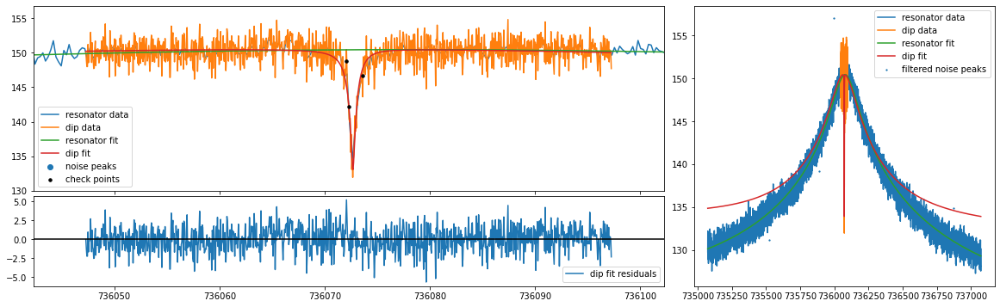

mean fit residuals = 1.4e-08 +/- 5.2e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8694710353166024 0.08943152728429879
736068.9152743954 736068.9152743954 736068.9152743954 736068.9152743954 736068.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                 736072.684219220188
dnu_z                     0.014816539773
dip_width                 1.869471035317
ddip_width                0.089431527284
fit_err                   2.724829886602
fit_success                         True
average_idx                            0
nu_res               736068.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.00

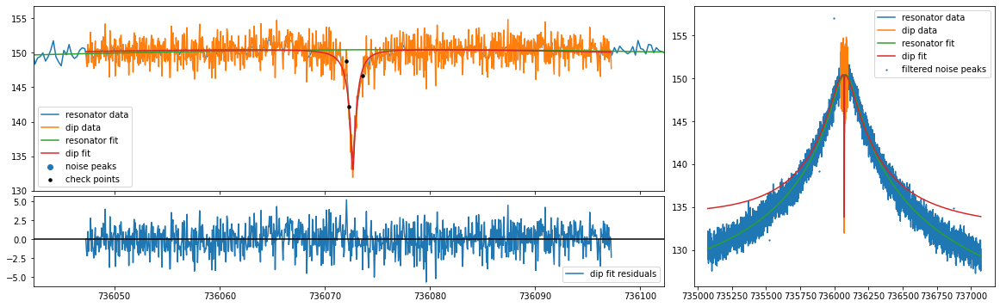

mean fit residuals = -6.0e-09 +/- 5.2e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8691682667035432 0.08901084487324001
736070.9152743954 736070.9152743954 736070.9152743954 736070.9152743954 736070.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                 736072.681120993802
dnu_z                     0.014729116716
dip_width                 1.869168266704
ddip_width                0.089010844873
fit_err                   2.704944487289
fit_success                         True
average_idx                            0
nu_res               736070.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.0

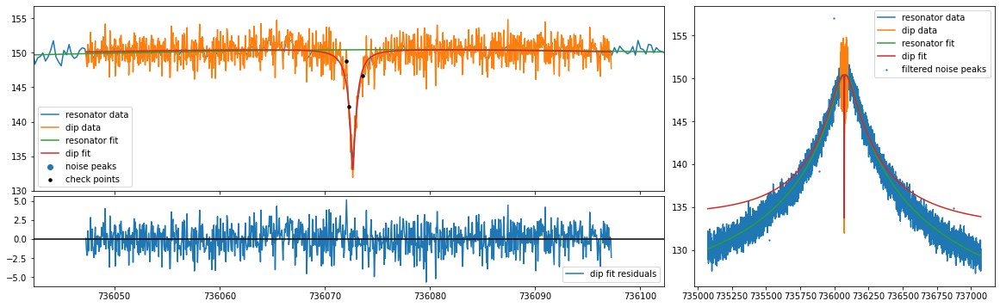

mean fit residuals = 2.0e-09 +/- 5.2e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.870080782135067 0.08867250595487333
736072.9152743954 736072.9152743954 736072.9152743954 736072.9152743954 736072.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                 736072.678056770121
dnu_z                     0.014656469085
dip_width                 1.870080782135
ddip_width                0.088672505955
fit_err                   2.687897179594
fit_success                         True
average_idx                            0
nu_res               736072.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.000

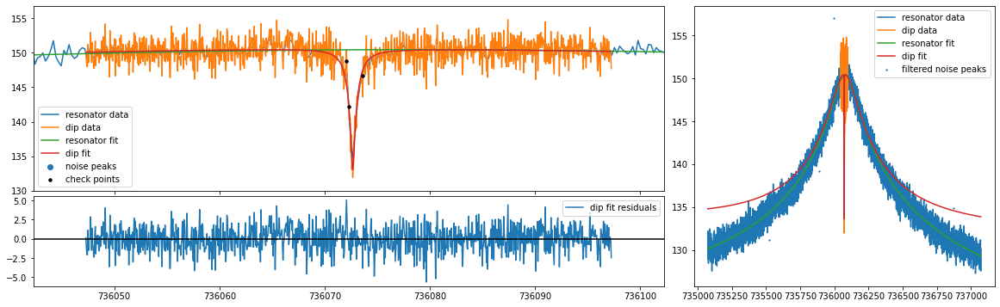

mean fit residuals = -2.1e-08 +/- 5.2e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8722136488896624 0.08841728176643694
736074.9152743954 736074.9152743954 736074.9152743954 736074.9152743954 736074.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                 736072.675026548677
dnu_z                     0.014598708734
dip_width                  1.87221364889
ddip_width                0.088417281766
fit_err                   2.673726667896
fit_success                         True
average_idx                            0
nu_res               736074.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.0

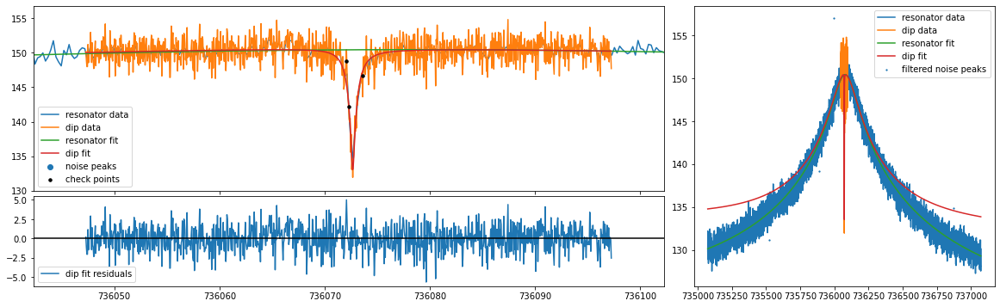

mean fit residuals = 1.5e-08 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.875559991641131 0.08824504241068534
736076.9152743954 736076.9152743954 736076.9152743954 736076.9152743954 736076.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                 736072.672030343092
dnu_z                     0.014555720954
dip_width                 1.875559991641
ddip_width                0.088245042411
fit_err                   2.662447396458
fit_success                         True
average_idx                            0
nu_res               736076.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.000

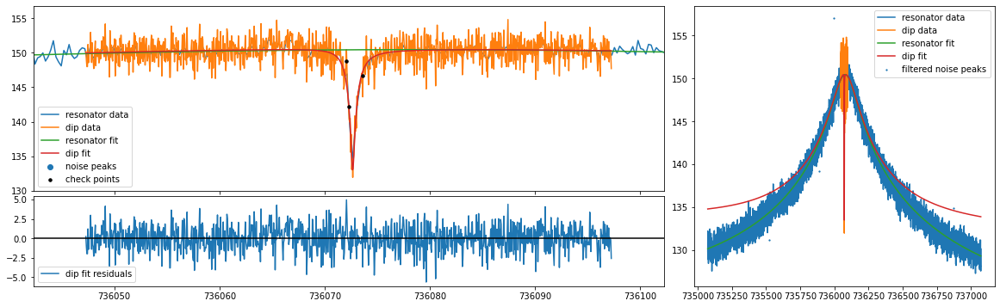

mean fit residuals = 3.9e-08 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8800766258013182 0.08815347886566836
736078.9152743954 736078.9152743954 736078.9152743954 736078.9152743954 736078.9152743954
mcycle                              1
cycle                               2
position                   position_1
trap                                2
acc_time                        20.05
time           20211128_220337.581016
nu_z              736072.669060181477
dnu_z                   0.01452679941
dip_width              1.880076625801
ddip_width             0.088153478866
fit_err                2.654049733262
fit_success                      True
average_idx                         0
nu_res            736078.915274395375
dnu_res                0.422023969064
Q                   4458.548996210428
dQ                    31.730568669151
th                    -0.000468191718
dth                     0.00001800692
off                  19670132291032.5
doff     

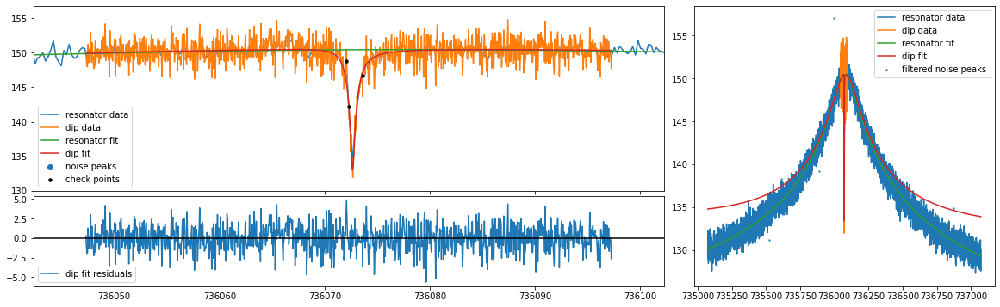

mean fit residuals = -2.4e-10 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8857520745032883 0.0881418112034115
736080.9152743954 736080.9152743954 736080.9152743954 736080.9152743954 736080.9152743954
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_220337.581016
nu_z                736072.666118002264
dnu_z                    0.014511764083
dip_width                1.885752074503
ddip_width               0.088141811203
fit_err                  2.648500682478
fit_success                        True
average_idx                           0
nu_res              736080.915274395375
dnu_res                  0.422023969064
Q                     4458.548996210428
dQ                      31.730568669151
th                      -0.000468191718
dth                       0.00001800692
off      

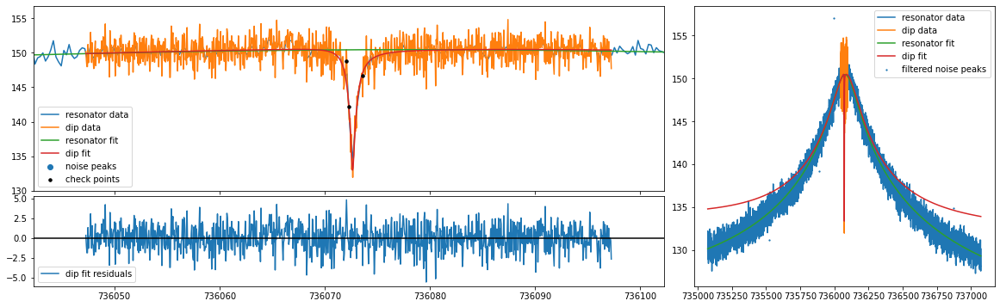

mean fit residuals = -1.1e-08 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8925805805500466 0.08820934085249939
736082.9152743954 736082.9152743954 736082.9152743954 736082.9152743954 736082.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                 736072.663205010467
dnu_z                     0.014510517773
dip_width                  1.89258058055
ddip_width                0.088209340852
fit_err                   2.645745063405
fit_success                         True
average_idx                            0
nu_res               736082.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.0

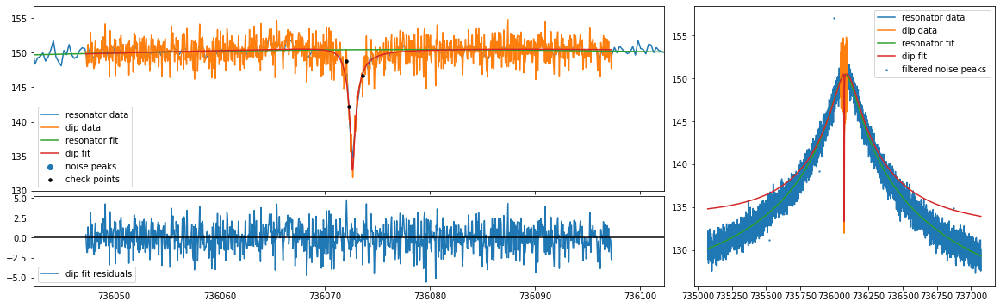

mean fit residuals = 9.5e-09 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9004561778504396 0.08834961656689264
736084.9152743954 736084.9152743954 736084.9152743954 736084.9152743954 736084.9152743954
mcycle                                 1
cycle                                  2
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_220337.581016
nu_z                  736072.66031193384
dnu_z                      0.01452125965
dip_width                  1.90045617785
ddip_width                0.088349616567
fit_err                   2.645707141341
fit_success                         True
average_idx                            0
nu_res               736084.915274395375
dnu_res                   0.422023969064
Q                      4458.548996210428
dQ                       31.730568669151
th                       -0.000468191718
dth                        0.00

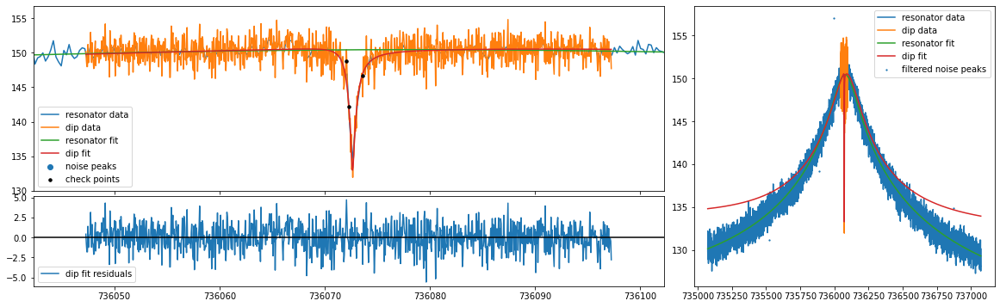

mean fit residuals = -9.5e-09 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9093803208290252 0.0885620201152574
736086.9152743954 736086.9152743954 736086.9152743954 736086.9152743954 736086.9152743954
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_220337.581016
nu_z                736072.657442957629
dnu_z                    0.014544022867
dip_width                1.909380320829
ddip_width               0.088562020115
fit_err                  2.648292622515
fit_success                        True
average_idx                           0
nu_res              736086.915274395375
dnu_res                  0.422023969064
Q                     4458.548996210428
dQ                      31.730568669151
th                      -0.000468191718
dth                       0.00001800692
off      

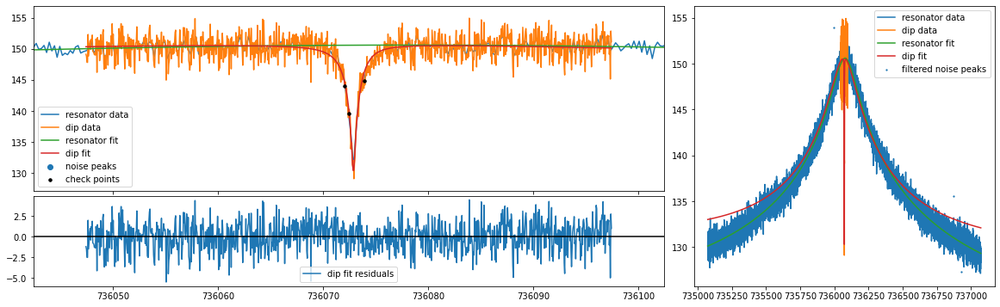

mean fit residuals = -1.4e-07 +/- 5.4e-02
[0.5, 3.0] 3.0 2.83778968586662 0.1091652226509677
736068.6560301319 736068.6560301319 736068.6560301319 736068.6560301319 736068.6560301319
mcycle                                  1
cycle                                   2
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_215320.427333
nu_z                  736072.874371644692
dnu_z                      0.015281868656
dip_width                  2.837789685867
ddip_width                 0.109165222651
fit_err                    2.973182351349
fit_success                          True
average_idx                             0
nu_res                736068.656030131853
dnu_res                    0.412755959294
Q                       4535.559562841109
dQ                        32.197670276416
th                        -0.000445502891
dth                        0.000017788819
off              10

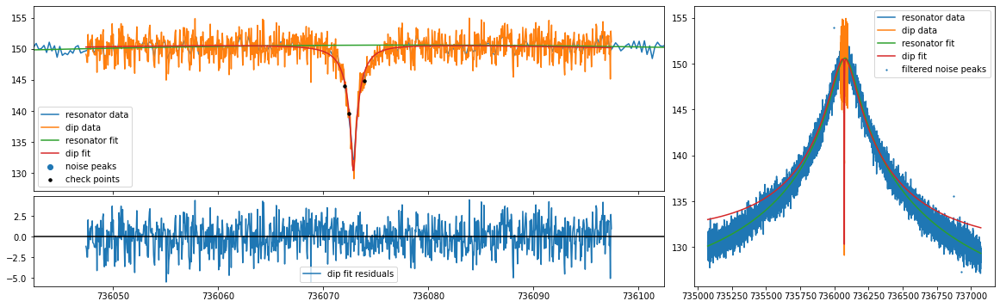

mean fit residuals = -6.5e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.839334590234248 0.10884890764686624
736070.6560301319 736070.6560301319 736070.6560301319 736070.6560301319 736070.6560301319
mcycle                                  1
cycle                                   2
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_215320.427333
nu_z                  736072.870969517971
dnu_z                      0.015247657493
dip_width                  2.839334590234
ddip_width                 0.108848907647
fit_err                     2.95283297053
fit_success                          True
average_idx                             0
nu_res                736070.656030131853
dnu_res                    0.412755959294
Q                       4535.559562841109
dQ                        32.197670276416
th                        -0.000445502891
dth                        0.000017788819
off              

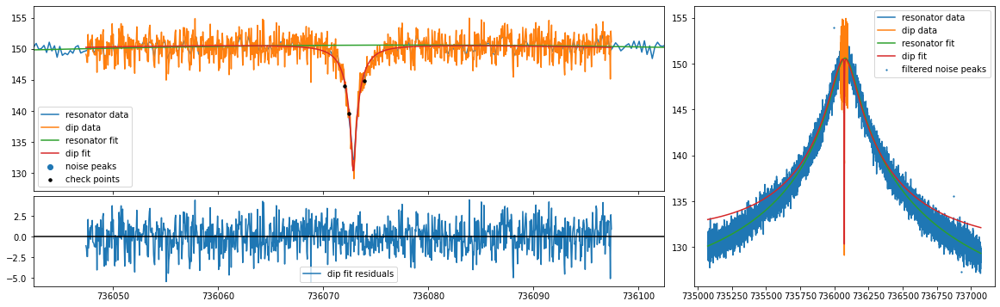

mean fit residuals = -6.3e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.8426886516868355 0.10862642800777299
736072.6560301319 736072.6560301319 736072.6560301319 736072.6560301319 736072.6560301319
mcycle                                 1
cycle                                  2
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_215320.427333
nu_z                 736072.867538379156
dnu_z                     0.015226542227
dip_width                 2.842688651687
ddip_width                0.108626428008
fit_err                   2.935881895059
fit_success                         True
average_idx                            0
nu_res               736072.656030131853
dnu_res                   0.412755959294
Q                      4535.559562841109
dQ                       32.197670276416
th                       -0.000445502891
dth                       0.000017788819
off              10754456431442.121

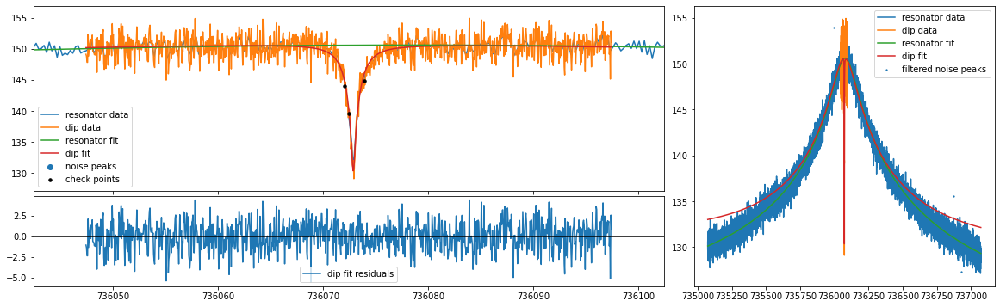

mean fit residuals = -2.3e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.8478530960871242 0.10849871965396217
736074.6560301319 736074.6560301319 736074.6560301319 736074.6560301319 736074.6560301319
mcycle                                1
cycle                                 2
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_215320.427333
nu_z                736072.864078659797
dnu_z                    0.015218663062
dip_width                2.847853096087
ddip_width               0.108498719654
fit_err                  2.922365175691
fit_success                        True
average_idx                           0
nu_res              736074.656030131853
dnu_res                  0.412755959294
Q                     4535.559562841109
dQ                      32.197670276416
th                      -0.000445502891
dth                      0.000017788819
off            10793686488535.271484375
doff          

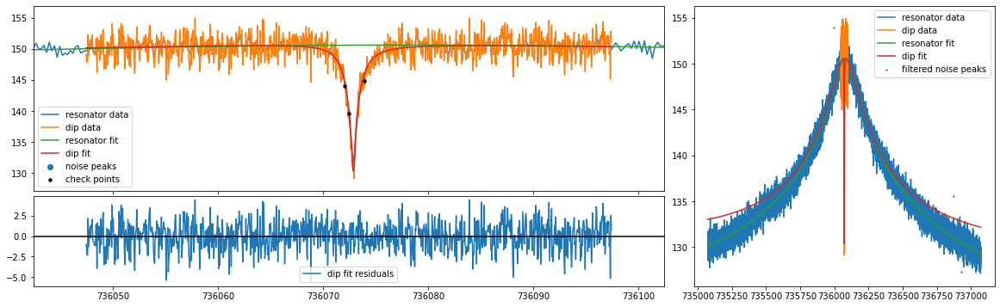

mean fit residuals = -3.5e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.854824119767335 0.10846626206859651
736076.6560301319 736076.6560301319 736076.6560301319 736076.6560301319 736076.6560301319
mcycle                                 1
cycle                                  2
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_215320.427333
nu_z                  736072.86059106444
dnu_z                     0.015224101856
dip_width                 2.854824119767
ddip_width                0.108466262069
fit_err                   2.912294850833
fit_success                         True
average_idx                            0
nu_res               736076.656030131853
dnu_res                   0.412755959294
Q                      4535.559562841109
dQ                       32.197670276416
th                       -0.000445502891
dth                       0.000017788819
off             10843527588981.68554

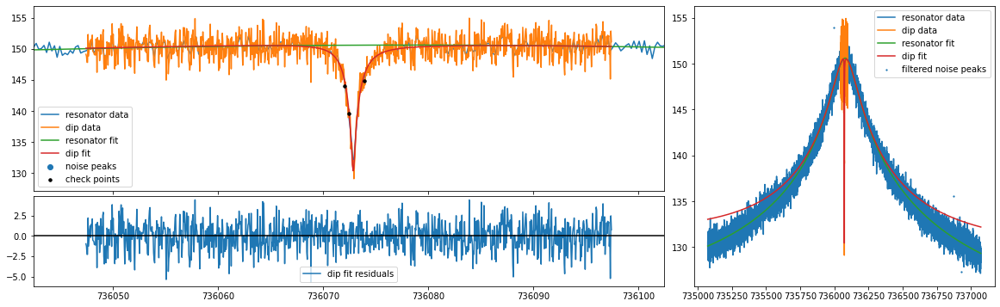

mean fit residuals = -5.1e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.8635903202356916 0.10852895750332477
736078.6560301319 736078.6560301319 736078.6560301319 736078.6560301319 736078.6560301319
mcycle                                 1
cycle                                  2
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_215320.427333
nu_z                 736072.857076474233
dnu_z                      0.01524284703
dip_width                 2.863590320236
ddip_width                0.108528957503
fit_err                   2.905659096512
fit_success                         True
average_idx                            0
nu_res               736078.656030131853
dnu_res                   0.412755959294
Q                      4535.559562841109
dQ                       32.197670276416
th                       -0.000445502891
dth                       0.000017788819
off                10903998908193.1

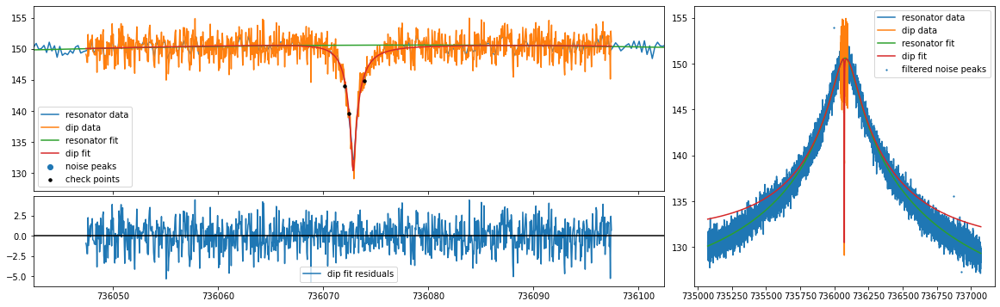

mean fit residuals = -8.5e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.87413384848422 0.1086861429881249
736080.6560301319 736080.6560301319 736080.6560301319 736080.6560301319 736080.6560301319
mcycle                                 1
cycle                                  2
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_215320.427333
nu_z                 736072.853535827599
dnu_z                     0.015274815828
dip_width                 2.874133848484
ddip_width                0.108686142988
fit_err                     2.9024228916
fit_success                         True
average_idx                            0
nu_res               736080.656030131853
dnu_res                   0.412755959294
Q                      4535.559562841109
dQ                       32.197670276416
th                       -0.000445502891
dth                       0.000017788819
off               10975137692690.49218

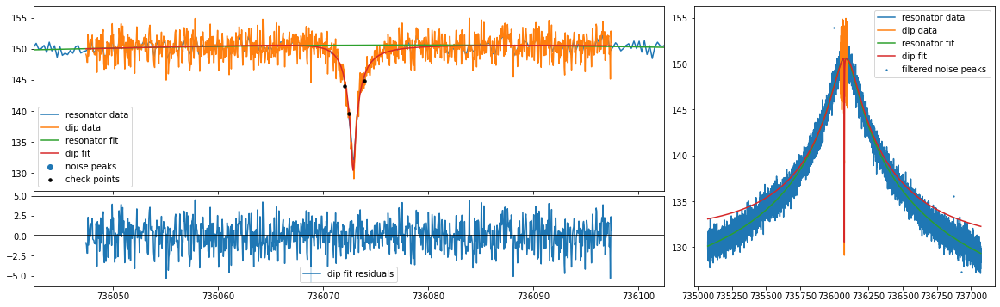

mean fit residuals = -1.4e-07 +/- 5.4e-02
[0.5, 3.0] 3.0 2.8864302549785585 0.10893663930988576
736082.6560301319 736082.6560301319 736082.6560301319 736082.6560301319 736082.6560301319
mcycle                                1
cycle                                 2
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_215320.427333
nu_z                736072.849970001145
dnu_z                    0.015319846501
dip_width                2.886430254979
ddip_width                0.10893663931
fit_err                  2.902529167902
fit_success                        True
average_idx                           0
nu_res              736082.656030131853
dnu_res                  0.412755959294
Q                     4535.559562841109
dQ                      32.197670276416
th                      -0.000445502891
dth                      0.000017788819
off            11056980214109.736328125
doff          

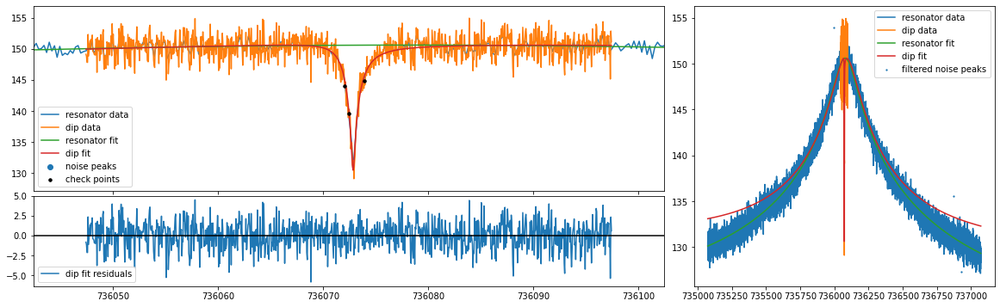

mean fit residuals = 9.1e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9001187221457627 0.10926239611318468
736084.6560301319 736084.6560301319 736084.6560301319 736084.6560301319 736084.6560301319
mcycle                                  1
cycle                                   2
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_215320.427333
nu_z                  736072.846436994849
dnu_z                      0.015372438749
dip_width                  2.900118722146
ddip_width                 0.109262396113
fit_err                    2.905900393602
fit_success                          True
average_idx                             0
nu_res                736084.656030131853
dnu_res                    0.412755959294
Q                       4535.559562841109
dQ                        32.197670276416
th                        -0.000445502891
dth                        0.000017788819
off              

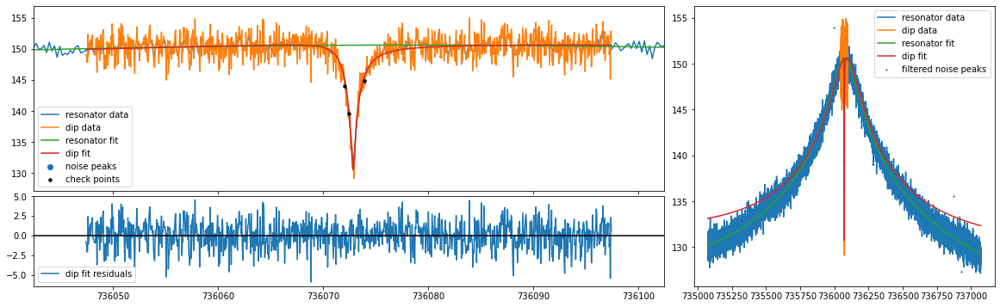

mean fit residuals = -1.7e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9157124408492994 0.10968882173844083
736086.6560301319 736086.6560301319 736086.6560301319 736086.6560301319 736086.6560301319
mcycle                                1
cycle                                 2
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_215320.427333
nu_z                736072.842845096835
dnu_z                    0.015441165784
dip_width                2.915712440849
ddip_width               0.109688821738
fit_err                  2.912440509975
fit_success                        True
average_idx                           0
nu_res              736086.656030131853
dnu_res                  0.412755959294
Q                     4535.559562841109
dQ                      32.197670276416
th                      -0.000445502891
dth                      0.000017788819
off             11240007165388.83984375
doff          

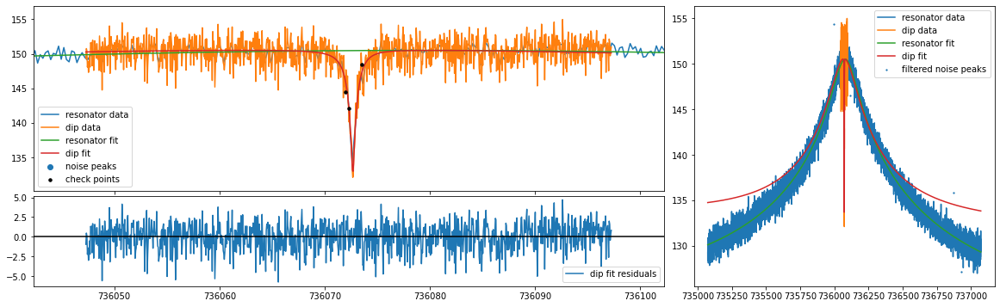

mean fit residuals = 1.7e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8876840814471034 0.09589595612160026
736069.9731943611 736069.9731943611 736069.9731943611 736069.9731943611 736069.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.680048865965
dnu_z                     0.015706532202
dip_width                 1.887684081447
ddip_width                0.095895956122
fit_err                   3.143007053955
fit_success                         True
average_idx                            0
nu_res               736069.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.000

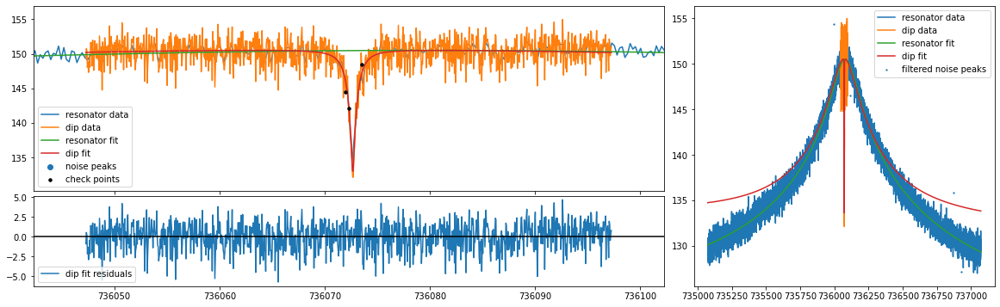

mean fit residuals = 1.4e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8860434974057096 0.09566810169527412
736071.9731943611 736071.9731943611 736071.9731943611 736071.9731943611 736071.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.677416528459
dnu_z                     0.015665053456
dip_width                 1.886043497406
ddip_width                0.095668101695
fit_err                   3.133591687322
fit_success                         True
average_idx                            0
nu_res               736071.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.000

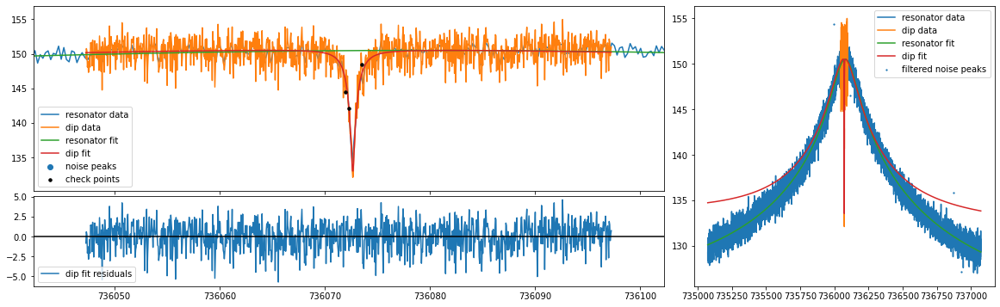

mean fit residuals = -5.5e-10 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8856502589065713 0.09552372885237324
736073.9731943611 736073.9731943611 736073.9731943611 736073.9731943611 736073.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.674782005837
dnu_z                     0.015638404167
dip_width                 1.885650258907
ddip_width                0.095523728852
fit_err                   3.127073584748
fit_success                         True
average_idx                            0
nu_res               736073.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.00

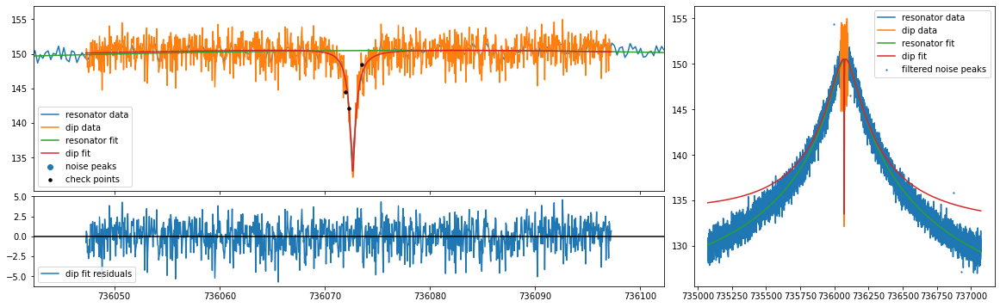

mean fit residuals = -1.6e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8865473163443942 0.09546560952026009
736075.9731943611 736075.9731943611 736075.9731943611 736075.9731943611 736075.9731943611
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_222413.448759
nu_z                736072.672142564435
dnu_z                    0.015627403183
dip_width                1.886547316344
ddip_width                0.09546560952
fit_err                  3.123465008996
fit_success                        True
average_idx                           0
nu_res              736075.973194361082
dnu_res                   0.40938379817
Q                     4472.682049292668
dQ                       31.01398334041
th                      -0.000455647688
dth                      0.000017509724
off     

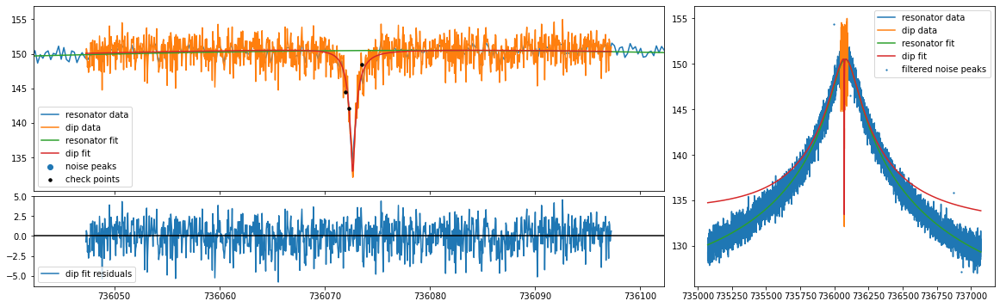

mean fit residuals = 4.4e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8886923691165416 0.09549132362202134
736077.9731943611 736077.9731943611 736077.9731943611 736077.9731943611 736077.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.669496069546
dnu_z                     0.015631345196
dip_width                 1.888692369117
ddip_width                0.095491323622
fit_err                   3.122754388675
fit_success                         True
average_idx                            0
nu_res               736077.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.000

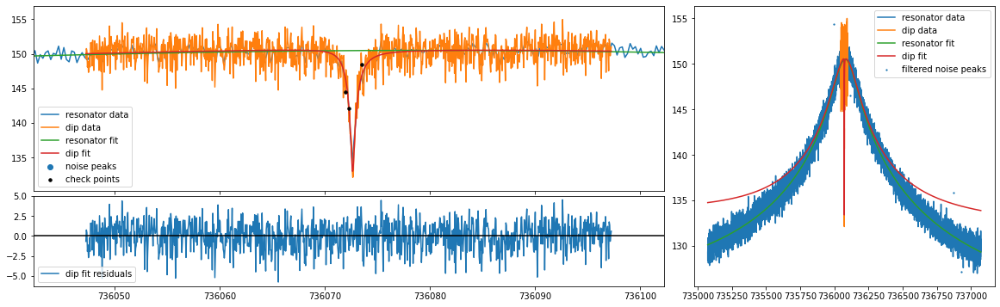

mean fit residuals = -5.0e-11 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8920668791518445 0.09559971786971876
736079.9731943611 736079.9731943611 736079.9731943611 736079.9731943611 736079.9731943611
mcycle                               1
cycle                                3
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_222413.448759
nu_z               736072.666840573656
dnu_z                   0.015649967093
dip_width               1.892066879152
ddip_width               0.09559971787
fit_err                 3.124906826914
fit_success                       True
average_idx                          0
nu_res             736079.973194361082
dnu_res                  0.40938379817
Q                    4472.682049292668
dQ                      31.01398334041
th                     -0.000455647688
dth                     0.000017509724
off             19499425933

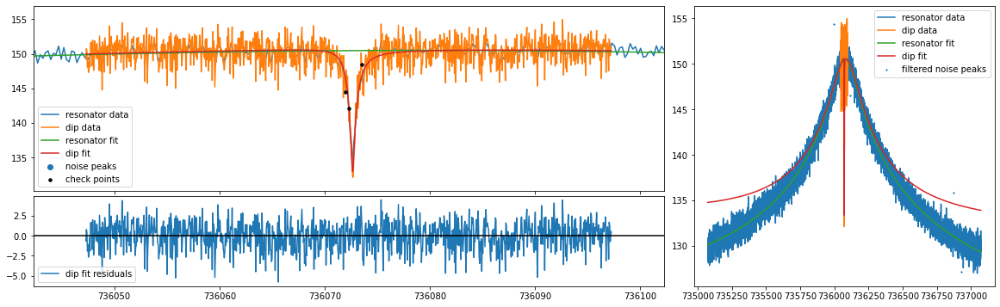

mean fit residuals = -7.4e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8966382085177442 0.09578861151423057
736081.9731943611 736081.9731943611 736081.9731943611 736081.9731943611 736081.9731943611
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_222413.448759
nu_z                736072.664174870006
dnu_z                    0.015682740466
dip_width                1.896638208518
ddip_width               0.095788611514
fit_err                  3.129865093883
fit_success                        True
average_idx                           0
nu_res              736081.973194361082
dnu_res                   0.40938379817
Q                     4472.682049292668
dQ                       31.01398334041
th                      -0.000455647688
dth                      0.000017509724
off     

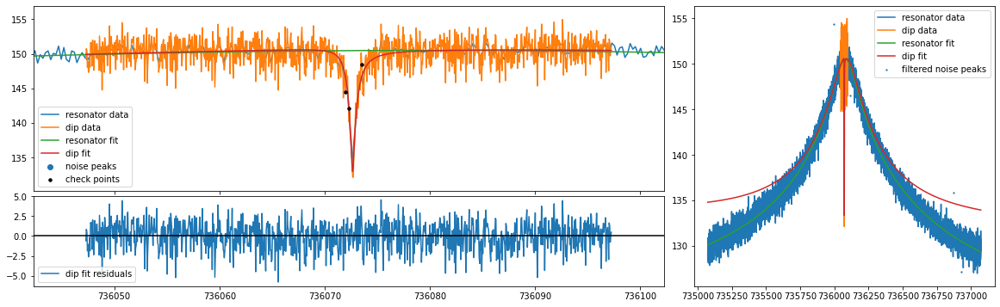

mean fit residuals = -7.7e-10 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9023841536607173 0.09605625726137416
736083.9731943611 736083.9731943611 736083.9731943611 736083.9731943611 736083.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.661496588262
dnu_z                     0.015729331518
dip_width                 1.902384153661
ddip_width                0.096056257261
fit_err                   3.137551101133
fit_success                         True
average_idx                            0
nu_res               736083.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.00

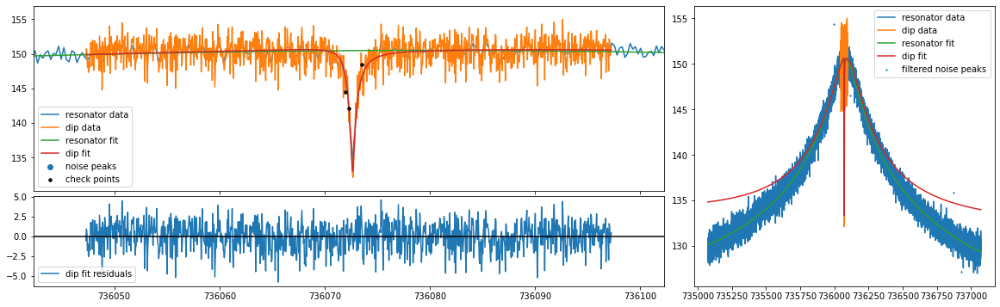

mean fit residuals = -1.7e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9092633394126646 0.0963996801293377
736085.9731943611 736085.9731943611 736085.9731943611 736085.9731943611 736085.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.658804710489
dnu_z                     0.015789071565
dip_width                 1.909263339413
ddip_width                0.096399680129
fit_err                   3.147867730227
fit_success                         True
average_idx                            0
nu_res               736085.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.000

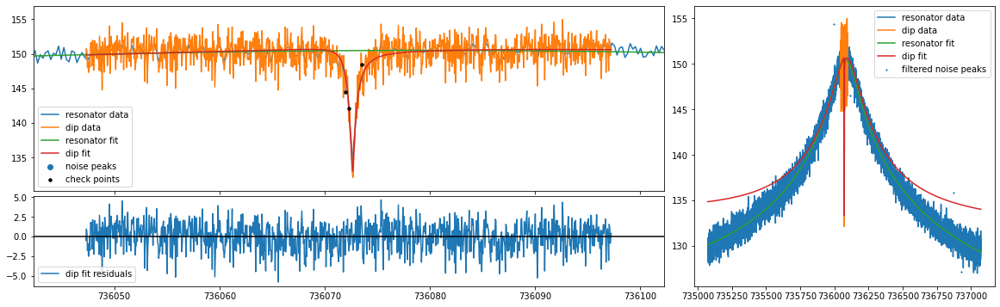

mean fit residuals = 1.6e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9172323209900026 0.0968157220701218
736087.9731943611 736087.9731943611 736087.9731943611 736087.9731943611 736087.9731943611
mcycle                                 1
cycle                                  3
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_222413.448759
nu_z                 736072.656098124105
dnu_z                     0.015861271454
dip_width                  1.91723232099
ddip_width                 0.09681572207
fit_err                   3.160701034146
fit_success                         True
average_idx                            0
nu_res               736087.973194361082
dnu_res                    0.40938379817
Q                      4472.682049292668
dQ                        31.01398334041
th                       -0.000455647688
dth                       0.0000

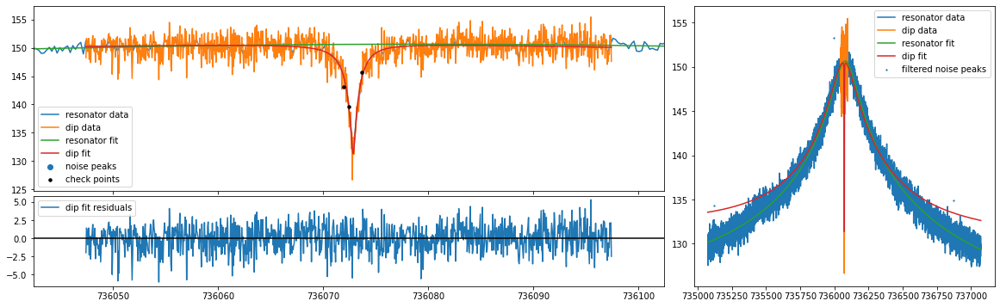

mean fit residuals = 1.2e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.908916074085432 0.11768019097263917
736069.7413022398 736069.7413022398 736069.7413022398 736069.7413022398 736069.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.847768182168
dnu_z                    0.017376632859
dip_width                2.908916074085
ddip_width               0.117680190973
fit_err                  3.199870396427
fit_success                        True
average_idx                           0
nu_res              736069.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off            13397022490441.322265625
doff            

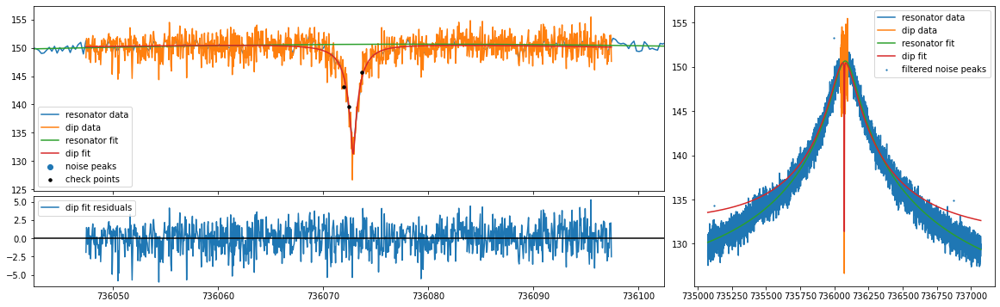

mean fit residuals = -3.8e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9073155184515804 0.11733326778316086
736071.7413022398 736071.7413022398 736071.7413022398 736071.7413022398 736071.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.843522464042
dnu_z                    0.017313784527
dip_width                2.907315518452
ddip_width               0.117333267783
fit_err                  3.185919451551
fit_success                        True
average_idx                           0
nu_res              736071.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off               13340973711382.109375
doff          

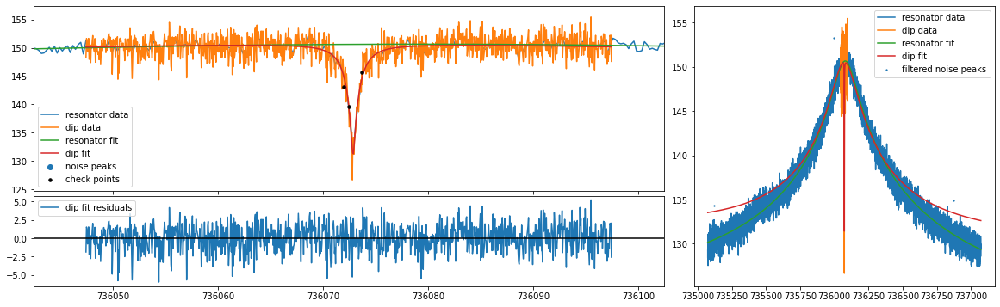

mean fit residuals = -5.9e-09 +/- 5.6e-02
[0.5, 3.0] 3.0 2.907456269940366 0.11708166302776914
736073.7413022398 736073.7413022398 736073.7413022398 736073.7413022398 736073.7413022398
mcycle                                 1
cycle                                  3
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_221355.385533
nu_z                 736072.839308207273
dnu_z                     0.017264515349
dip_width                  2.90745626994
ddip_width                0.117081663028
fit_err                   3.175468852428
fit_success                         True
average_idx                            0
nu_res               736073.741302239825
dnu_res                   0.410835539765
Q                      4581.967572975569
dQ                       32.814790009504
th                       -0.000458735605
dth                       0.000017769928
off              13296282386511.0039

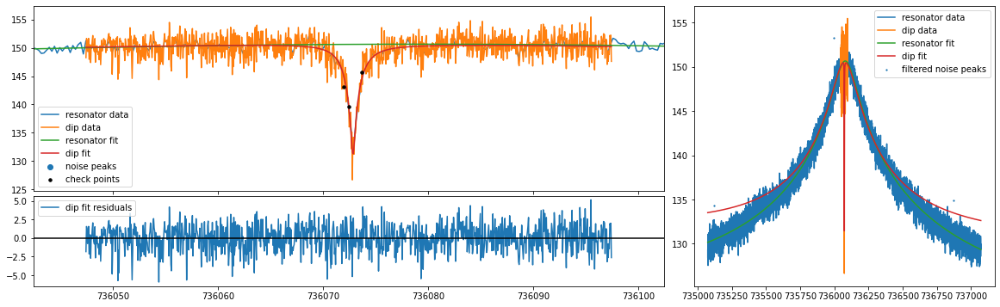

mean fit residuals = -5.7e-09 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9093500816017004 0.11692668000240738
736075.7413022398 736075.7413022398 736075.7413022398 736075.7413022398 736075.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.835130267078
dnu_z                    0.017229098798
dip_width                2.909350081602
ddip_width               0.116926680002
fit_err                  3.168551688178
fit_success                        True
average_idx                           0
nu_res              736075.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off                 13263218953350.9375
doff          

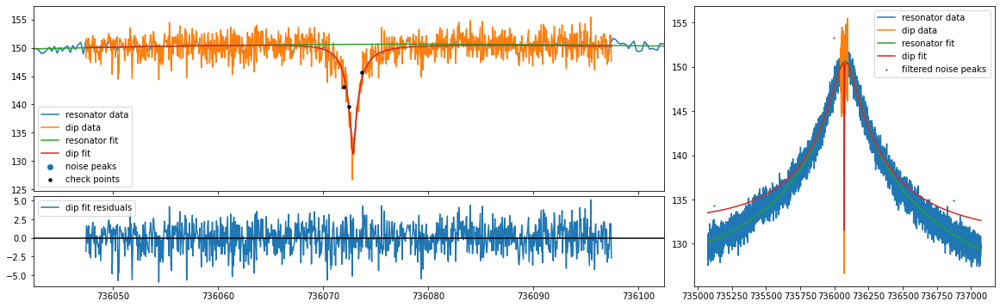

mean fit residuals = 1.6e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.912998891181622 0.11686887290836577
736077.7413022398 736077.7413022398 736077.7413022398 736077.7413022398 736077.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.830993149313
dnu_z                    0.017207671426
dip_width                2.912998891182
ddip_width               0.116868872908
fit_err                  3.165175918777
fit_success                        True
average_idx                           0
nu_res              736077.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off            13241967542754.177734375
doff            

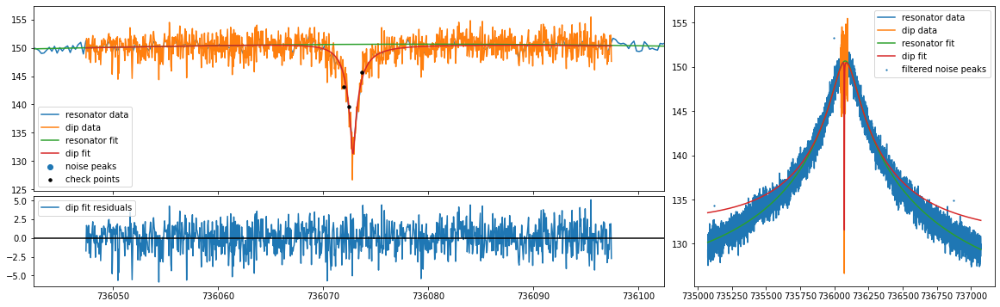

mean fit residuals = -2.0e-09 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9183982354499722 0.1169082880526404
736079.7413022398 736079.7413022398 736079.7413022398 736079.7413022398 736079.7413022398
mcycle                                 1
cycle                                  3
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_221355.385533
nu_z                  736072.82689932792
dnu_z                     0.017200288933
dip_width                  2.91839823545
ddip_width                0.116908288053
fit_err                   3.165324554271
fit_success                         True
average_idx                            0
nu_res               736079.741302239825
dnu_res                   0.410835539765
Q                      4581.967572975569
dQ                       32.814790009504
th                       -0.000458735605
dth                       0.000017769928
off             13232730175384.24414

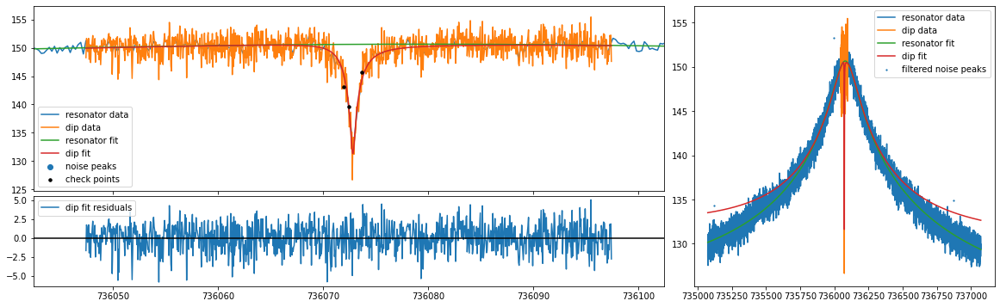

mean fit residuals = 3.4e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9255382844766253 0.11704455615435391
736081.7413022398 736081.7413022398 736081.7413022398 736081.7413022398 736081.7413022398
mcycle                                 1
cycle                                  3
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_221355.385533
nu_z                 736072.822851664503
dnu_z                     0.017206998349
dip_width                 2.925538284477
ddip_width                0.117044556154
fit_err                   3.168956399031
fit_success                         True
average_idx                            0
nu_res               736081.741302239825
dnu_res                   0.410835539765
Q                      4581.967572975569
dQ                       32.814790009504
th                       -0.000458735605
dth                       0.000017769928
off              13235880140606.7773

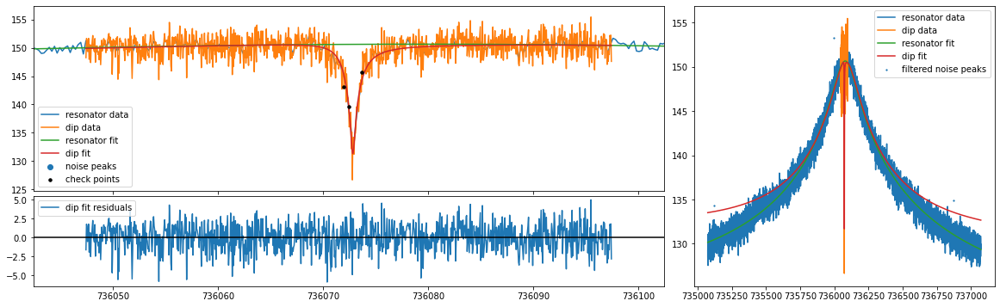

mean fit residuals = -6.1e-06 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9343339213009996 0.11726770501858161
736083.7413022398 736083.7413022398 736083.7413022398 736083.7413022398 736083.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.818811932928
dnu_z                     0.01722412424
dip_width                2.934333921301
ddip_width               0.117267705019
fit_err                  3.176007165352
fit_success                        True
average_idx                           0
nu_res              736083.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off            13243953801895.064453125
doff          

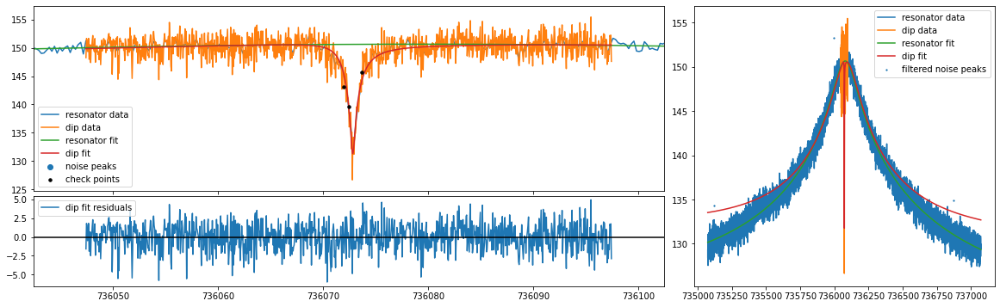

mean fit residuals = -8.6e-06 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9450876835497817 0.11759998164844196
736085.7413022398 736085.7413022398 736085.7413022398 736085.7413022398 736085.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.814802816836
dnu_z                    0.017259931329
dip_width                 2.94508768355
ddip_width               0.117599981648
fit_err                  3.186391549674
fit_success                        True
average_idx                           0
nu_res              736085.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off            13274362201128.888671875
doff          

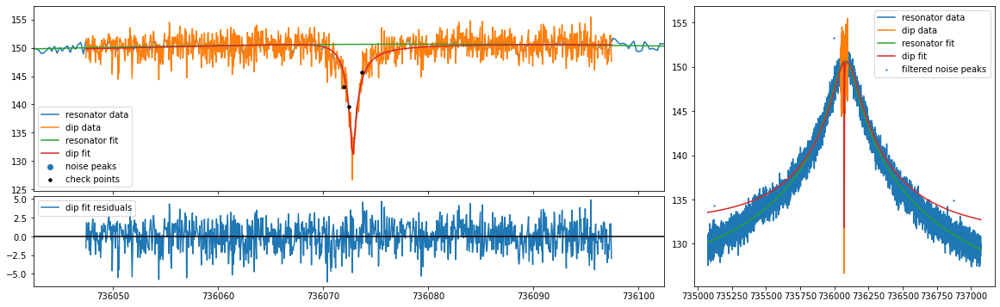

mean fit residuals = -1.2e-05 +/- 5.6e-02
[0.5, 3.0] 3.0 2.957636378382132 0.11802970304811587
736087.7413022398 736087.7413022398 736087.7413022398 736087.7413022398 736087.7413022398
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_221355.385533
nu_z                736072.810826494824
dnu_z                    0.017310741466
dip_width                2.957636378382
ddip_width               0.118029703048
fit_err                  3.200005093042
fit_success                        True
average_idx                           0
nu_res              736087.741302239825
dnu_res                  0.410835539765
Q                     4581.967572975569
dQ                      32.814790009504
th                      -0.000458735605
dth                      0.000017769928
off            13320373025039.099609375
doff           

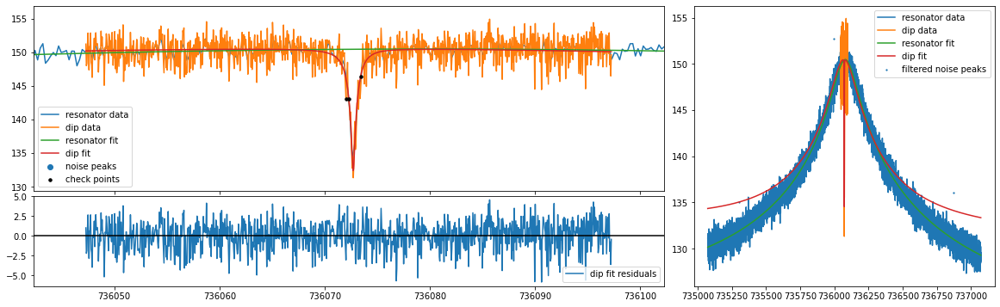

mean fit residuals = 8.4e-09 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.818525851216172 0.09405242543784634
736070.4702092975 736070.4702092975 736070.4702092975 736070.4702092975 736070.4702092975
mcycle                                 1
cycle                                  4
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_224449.937637
nu_z                 736072.718011876219
dnu_z                     0.015008102687
dip_width                 1.818525851216
ddip_width                0.094052425438
fit_err                   3.249474974291
fit_success                         True
average_idx                            0
nu_res               736070.470209297491
dnu_res                    0.41405415565
Q                      4469.091119741904
dQ                       31.297438509882
th                       -0.000494426933
dth                       0.0000

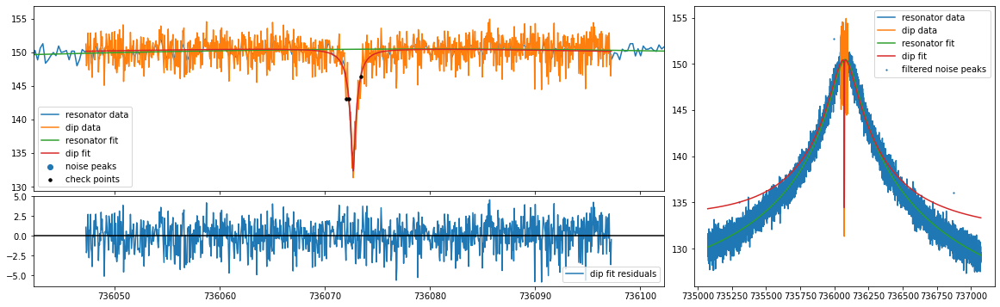

mean fit residuals = -5.4e-11 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.816924130594324 0.09372468642676973
736072.4702092975 736072.4702092975 736072.4702092975 736072.4702092975 736072.4702092975
mcycle                                 1
cycle                                  4
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_224449.937637
nu_z                 736072.715063124779
dnu_z                     0.014936793902
dip_width                 1.816924130594
ddip_width                0.093724686427
fit_err                   3.236107325147
fit_success                         True
average_idx                            0
nu_res               736072.470209297491
dnu_res                    0.41405415565
Q                      4469.091119741904
dQ                       31.297438509882
th                       -0.000494426933
dth                       0.000

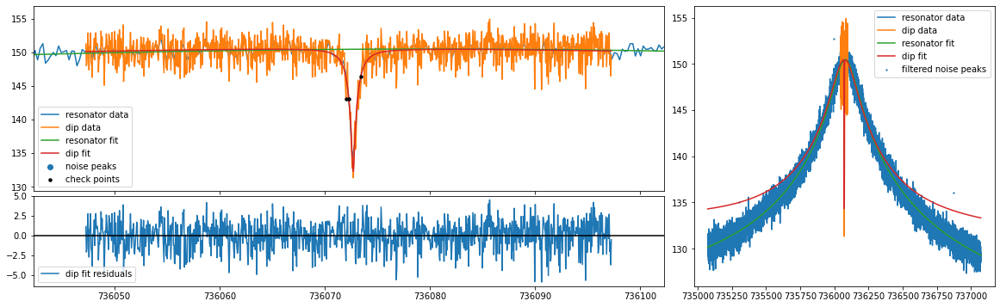

mean fit residuals = 3.6e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8165321914050032 0.09347635890486132
736074.4702092975 736074.4702092975 736074.4702092975 736074.4702092975 736074.4702092975
mcycle                                 1
cycle                                  4
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_224449.937637
nu_z                 736072.712143559358
dnu_z                     0.014879386258
dip_width                 1.816532191405
ddip_width                0.093476358905
fit_err                    3.22553716714
fit_success                         True
average_idx                            0
nu_res               736074.470209297491
dnu_res                    0.41405415565
Q                      4469.091119741904
dQ                       31.297438509882
th                       -0.000494426933
dth                       0.000

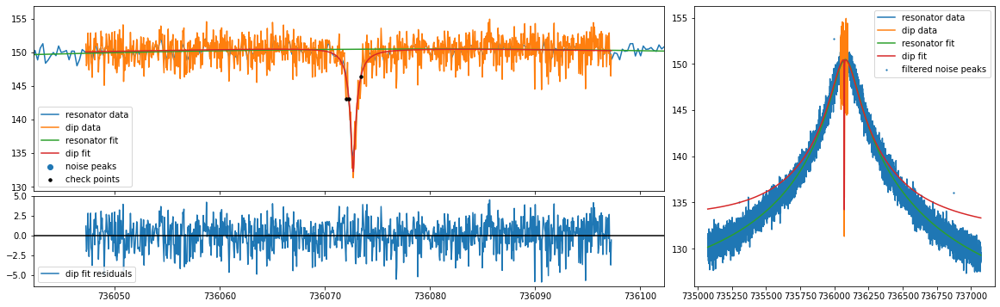

mean fit residuals = 3.3e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.817333972959285 0.09330662500186399
736076.4702092975 736076.4702092975 736076.4702092975 736076.4702092975 736076.4702092975
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_224449.937637
nu_z                736072.709249375504
dnu_z                    0.014835575042
dip_width                1.817333972959
ddip_width               0.093306625002
fit_err                  3.217784228747
fit_success                        True
average_idx                           0
nu_res              736076.470209297491
dnu_res                   0.41405415565
Q                     4469.091119741904
dQ                      31.297438509882
th                      -0.000494426933
dth                      0.000017693106
off       

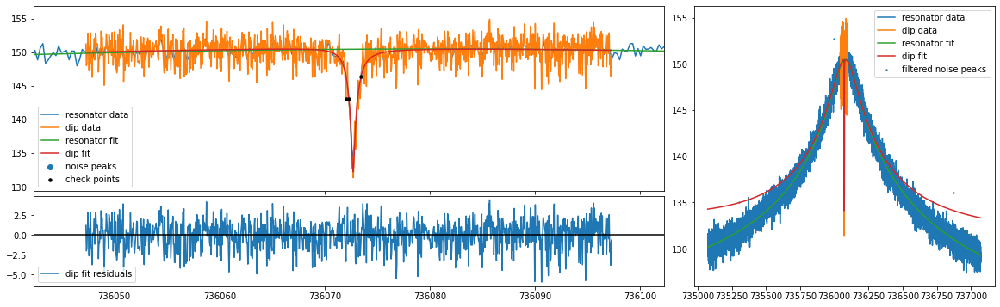

mean fit residuals = 2.9e-09 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8193072372466441 0.09321401487037385
736078.4702092975 736078.4702092975 736078.4702092975 736078.4702092975 736078.4702092975
mcycle                                 1
cycle                                  4
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_224449.937637
nu_z                 736072.706377666327
dnu_z                      0.01480493214
dip_width                 1.819307237247
ddip_width                 0.09321401487
fit_err                   3.212843942456
fit_success                         True
average_idx                            0
nu_res               736078.470209297491
dnu_res                    0.41405415565
Q                      4469.091119741904
dQ                       31.297438509882
th                       -0.000494426933
dth                       0.000

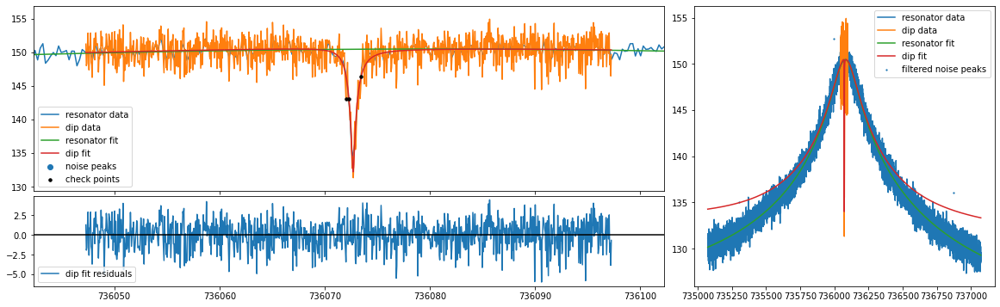

mean fit residuals = -9.9e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8224223296867919 0.09319651499056482
736080.4702092975 736080.4702092975 736080.4702092975 736080.4702092975 736080.4702092975
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_224449.937637
nu_z                736072.703525448567
dnu_z                    0.014786916385
dip_width                1.822422329687
ddip_width               0.093196514991
fit_err                  3.210688018993
fit_success                        True
average_idx                           0
nu_res              736080.470209297491
dnu_res                   0.41405415565
Q                     4469.091119741904
dQ                      31.297438509882
th                      -0.000494426933
dth                      0.000017693106
off     

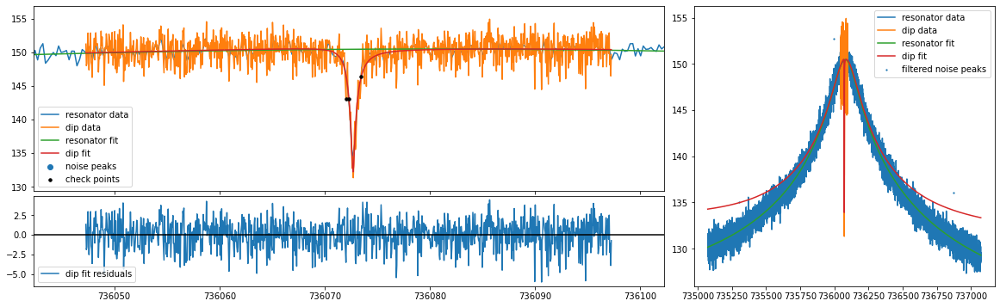

mean fit residuals = -6.2e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8266485811597832 0.09325191653775526
736082.4702092975 736082.4702092975 736082.4702092975 736082.4702092975 736082.4702092975
mcycle                                 1
cycle                                  4
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_224449.937637
nu_z                 736072.700691205566
dnu_z                     0.014780981605
dip_width                  1.82664858116
ddip_width                0.093251916538
fit_err                   3.211265537463
fit_success                         True
average_idx                            0
nu_res               736082.470209297491
dnu_res                    0.41405415565
Q                      4469.091119741904
dQ                       31.297438509882
th                       -0.000494426933
dth                       0.00

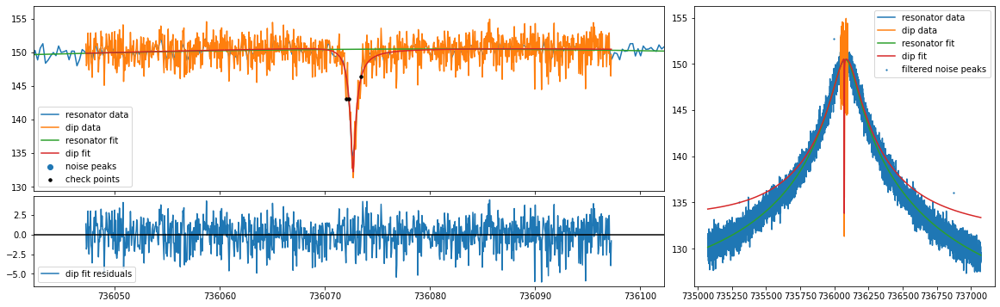

mean fit residuals = 1.3e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8319492917647415 0.09337753932358486
736084.4702092975 736084.4702092975 736084.4702092975 736084.4702092975 736084.4702092975
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_224449.937637
nu_z                736072.697873686673
dnu_z                    0.014786479344
dip_width                1.831949291765
ddip_width               0.093377539324
fit_err                  3.214504470971
fit_success                        True
average_idx                           0
nu_res              736084.470209297491
dnu_res                   0.41405415565
Q                     4469.091119741904
dQ                      31.297438509882
th                      -0.000494426933
dth                      0.000017693106
off      

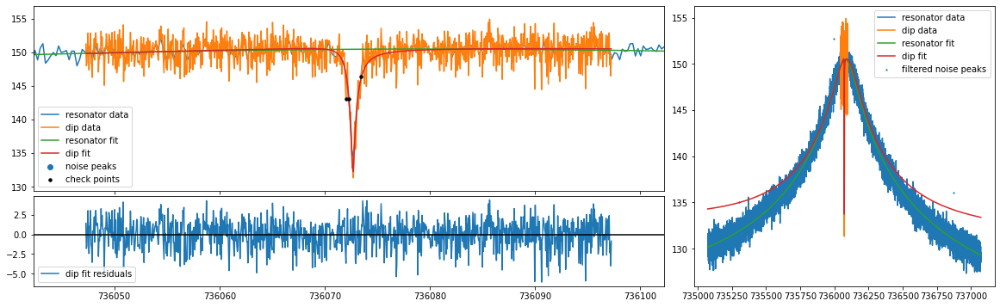

mean fit residuals = -5.8e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8382700292201297 0.09356896628236787
736086.4702092975 736086.4702092975 736086.4702092975 736086.4702092975 736086.4702092975
mcycle                                 1
cycle                                  4
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_224449.937637
nu_z                 736072.695069201873
dnu_z                     0.014802188435
dip_width                  1.83827002922
ddip_width                0.093568966282
fit_err                   3.220313592373
fit_success                         True
average_idx                            0
nu_res               736086.470209297491
dnu_res                    0.41405415565
Q                      4469.091119741904
dQ                       31.297438509882
th                       -0.000494426933
dth                       0.00

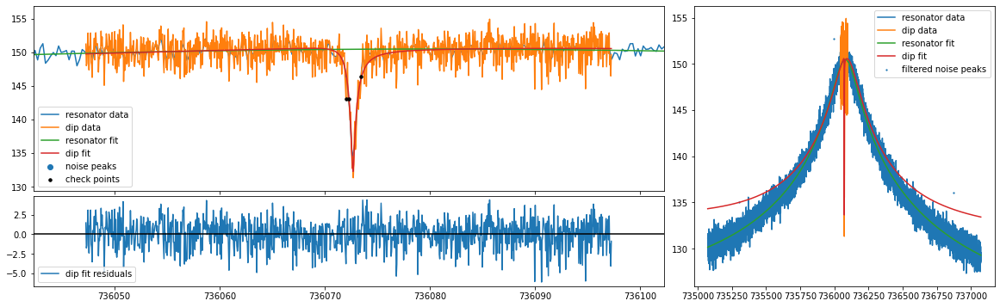

mean fit residuals = -1.8e-04 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8453198520594876 0.09385182677852234
736088.4702092975 736088.4702092975 736088.4702092975 736088.4702092975 736088.4702092975
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_224449.937637
nu_z                736072.692042374285
dnu_z                    0.014842387726
dip_width                1.845319852059
ddip_width               0.093851826779
fit_err                  3.228584485439
fit_success                        True
average_idx                           0
nu_res              736088.470209297491
dnu_res                   0.41405415565
Q                     4469.091119741904
dQ                      31.297438509882
th                      -0.000494426933
dth                      0.000017693106
off     

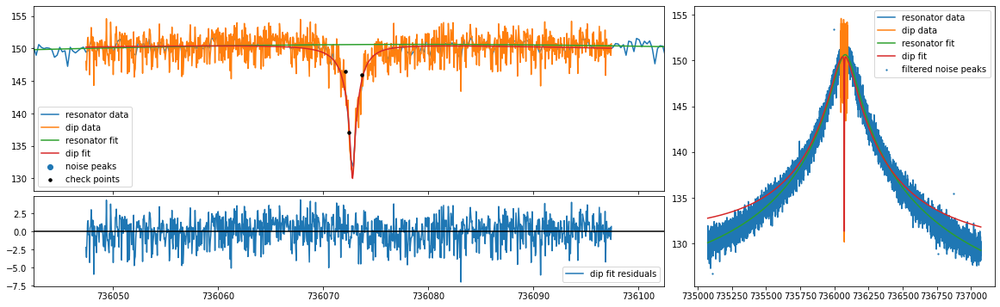

mean fit residuals = -1.6e-08 +/- 5.7e-02
[0.5, 3.0] 3.0 2.862267632806549 0.11471581806448641
736069.4638647512 736069.4638647512 736069.4638647512 736069.4638647512 736069.4638647512
mcycle                                 1
cycle                                  4
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_223431.658327
nu_z                 736072.789277330274
dnu_z                     0.015875336242
dip_width                 2.862267632807
ddip_width                0.114715818064
fit_err                    3.28287846417
fit_success                         True
average_idx                            0
nu_res                736069.46386475116
dnu_res                   0.404731686385
Q                      4561.458170456138
dQ                       31.956379925611
th                       -0.000472567529
dth                       0.000017505571
off              9950090093183.15429

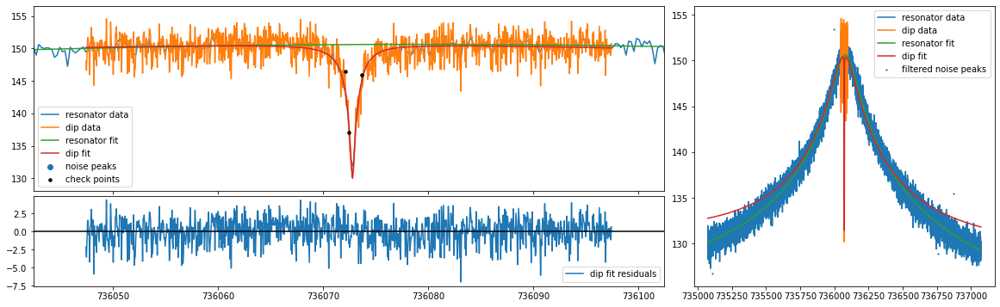

mean fit residuals = 1.1e-08 +/- 5.7e-02
[0.5, 3.0] 3.0 2.8650981430251177 0.11438789860064694
736071.4638647512 736071.4638647512 736071.4638647512 736071.4638647512 736071.4638647512
mcycle                                  1
cycle                                   4
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_223431.658327
nu_z                  736072.785777020152
dnu_z                      0.015827490439
dip_width                  2.865098143025
ddip_width                 0.114387898601
fit_err                    3.261285263177
fit_success                          True
average_idx                             0
nu_res                 736071.46386475116
dnu_res                    0.404731686385
Q                       4561.458170456138
dQ                        31.956379925611
th                        -0.000472567529
dth                        0.000017505571
off              

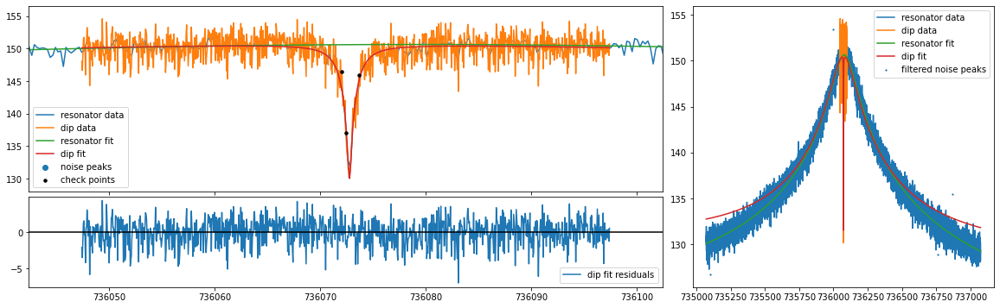

mean fit residuals = -1.4e-08 +/- 5.7e-02
[0.5, 3.0] 3.0 2.869656943923316 0.11415092149109474
736073.4638647512 736073.4638647512 736073.4638647512 736073.4638647512 736073.4638647512
mcycle                                  1
cycle                                   4
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_223431.658327
nu_z                  736072.782280276297
dnu_z                      0.015791979072
dip_width                  2.869656943923
ddip_width                 0.114150921491
fit_err                    3.243196859399
fit_success                          True
average_idx                             0
nu_res                 736073.46386475116
dnu_res                    0.404731686385
Q                       4561.458170456138
dQ                        31.956379925611
th                        -0.000472567529
dth                        0.000017505571
off              

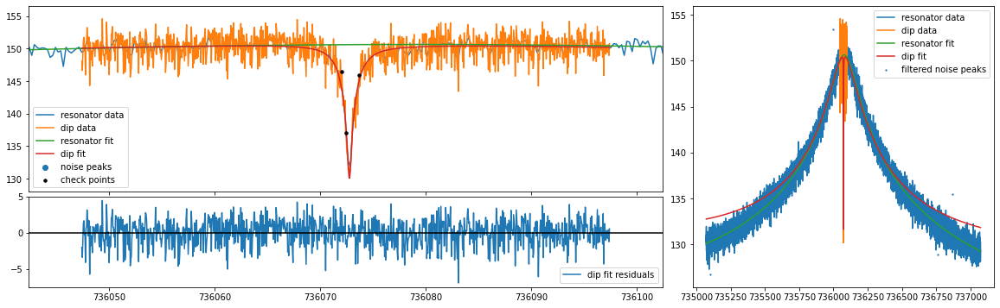

mean fit residuals = 4.7e-09 +/- 5.7e-02
[0.5, 3.0] 3.0 2.8759354882240915 0.1140053010622604
736075.4638647512 736075.4638647512 736075.4638647512 736075.4638647512 736075.4638647512
mcycle                                  1
cycle                                   4
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_223431.658327
nu_z                  736072.778787831892
dnu_z                      0.015768776018
dip_width                  2.875935488224
ddip_width                 0.114005301062
fit_err                    3.228646275814
fit_success                          True
average_idx                             0
nu_res                 736075.46386475116
dnu_res                    0.404731686385
Q                       4561.458170456138
dQ                        31.956379925611
th                        -0.000472567529
dth                        0.000017505571
off               

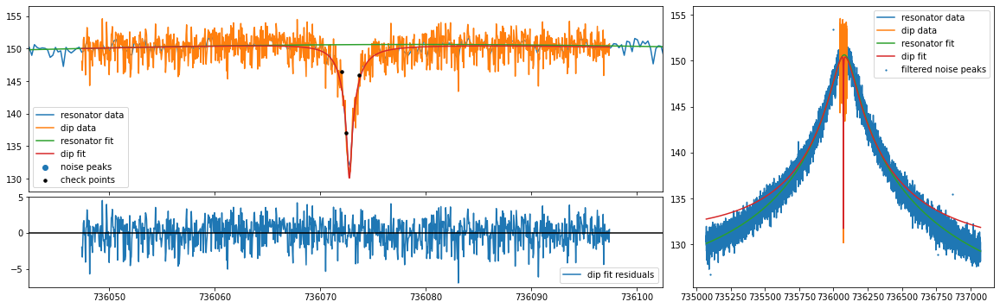

mean fit residuals = 1.4e-08 +/- 5.7e-02
[0.5, 3.0] 3.0 2.8839234599012893 0.1139511466725334
736077.4638647512 736077.4638647512 736077.4638647512 736077.4638647512 736077.4638647512
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_223431.658327
nu_z                736072.775301657501
dnu_z                    0.015757873132
dip_width                2.883923459901
ddip_width               0.113951146673
fit_err                  3.217641426489
fit_success                        True
average_idx                           0
nu_res               736077.46386475116
dnu_res                  0.404731686385
Q                     4561.458170456138
dQ                      31.956379925611
th                      -0.000472567529
dth                      0.000017505571
off             9949354865351.638671875
doff            

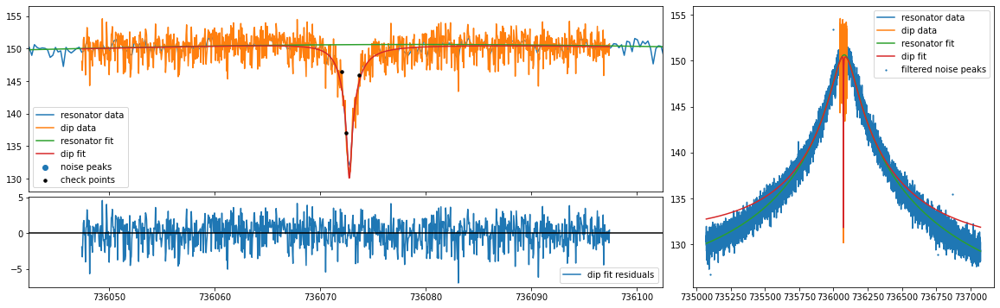

mean fit residuals = -2.4e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.8935987073757845 0.11398785938474652
736079.4638647512 736079.4638647512 736079.4638647512 736079.4638647512 736079.4638647512
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_223431.658327
nu_z                736072.771823297953
dnu_z                    0.015759116152
dip_width                2.893598707376
ddip_width               0.113987859385
fit_err                  3.210165472061
fit_success                        True
average_idx                           0
nu_res               736079.46386475116
dnu_res                  0.404731686385
Q                     4561.458170456138
dQ                      31.956379925611
th                      -0.000472567529
dth                      0.000017505571
off                9970580729477.921875
doff          

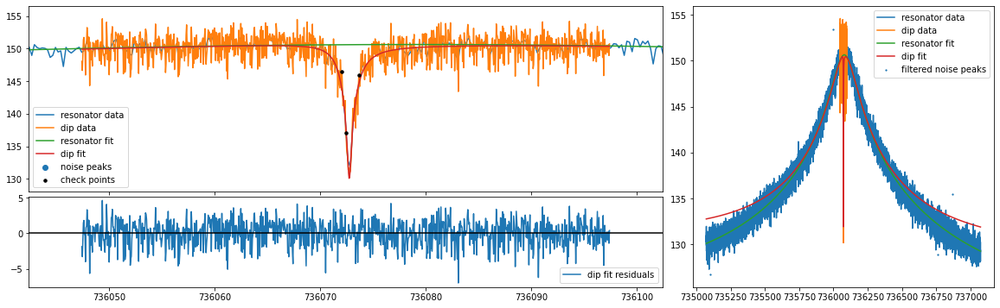

mean fit residuals = -2.5e-07 +/- 5.6e-02
[0.5, 3.0] 3.0 2.9048482401089184 0.11410920246559614
736081.4638647512 736081.4638647512 736081.4638647512 736081.4638647512 736081.4638647512
mcycle                                 1
cycle                                  4
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_223431.658327
nu_z                 736072.768352193525
dnu_z                     0.015770551193
dip_width                 2.904848240109
ddip_width                0.114109202466
fit_err                   3.206177715218
fit_success                         True
average_idx                            0
nu_res                736081.46386475116
dnu_res                   0.404731686385
Q                      4561.458170456138
dQ                       31.956379925611
th                       -0.000472567529
dth                       0.000017505571
off              9997057130150.7636

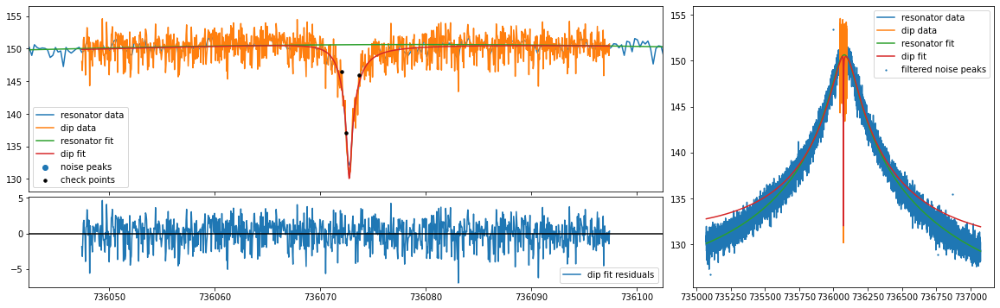

mean fit residuals = -4.0e-07 +/- 5.6e-02
[0.5, 3.0] 3.0 2.917787653602281 0.11432204347659942
736083.4638647512 736083.4638647512 736083.4638647512 736083.4638647512 736083.4638647512
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_223431.658327
nu_z                 736072.76487507869
dnu_z                    0.015794747101
dip_width                2.917787653602
ddip_width               0.114322043477
fit_err                  3.205614912336
fit_success                        True
average_idx                           0
nu_res               736083.46386475116
dnu_res                  0.404731686385
Q                     4561.458170456138
dQ                      31.956379925611
th                      -0.000472567529
dth                      0.000017505571
off                 10033428575921.5625
doff           

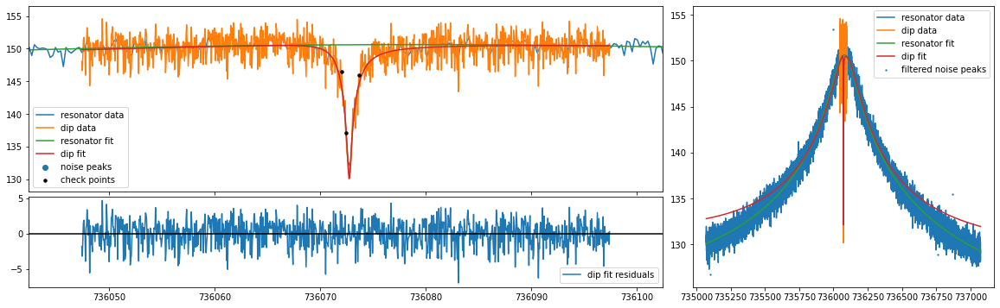

mean fit residuals = -5.7e-07 +/- 5.6e-02
[0.5, 3.0] 3.0 2.932332088318884 0.11462136644129291
736085.4638647512 736085.4638647512 736085.4638647512 736085.4638647512 736085.4638647512
mcycle                                 1
cycle                                  4
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_223431.658327
nu_z                 736072.761406580801
dnu_z                     0.015830329778
dip_width                 2.932332088319
ddip_width                0.114621366441
fit_err                   3.208393350935
fit_success                         True
average_idx                            0
nu_res                736085.46386475116
dnu_res                   0.404731686385
Q                      4561.458170456138
dQ                       31.956379925611
th                       -0.000472567529
dth                       0.000017505571
off             10077763734961.35742

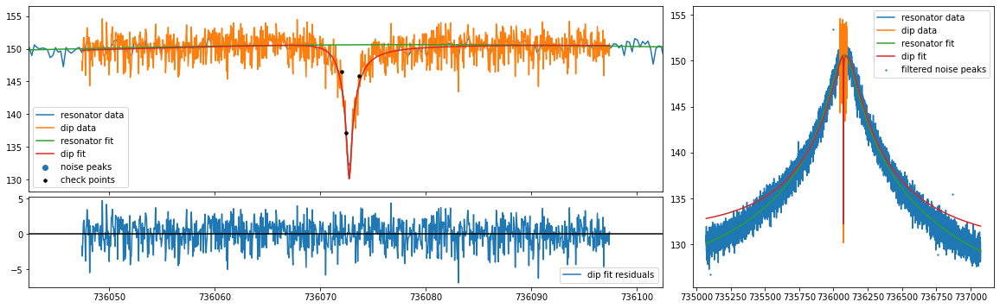

mean fit residuals = -8.6e-07 +/- 5.7e-02
[0.5, 3.0] 3.0 2.948432995232434 0.11500445258329245
736087.4638647512 736087.4638647512 736087.4638647512 736087.4638647512 736087.4638647512
mcycle                                  1
cycle                                   4
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_223431.658327
nu_z                  736072.757946811267
dnu_z                      0.015876811393
dip_width                  2.948432995232
ddip_width                 0.115004452583
fit_err                    3.214410770929
fit_success                          True
average_idx                             0
nu_res                 736087.46386475116
dnu_res                    0.404731686385
Q                       4561.458170456138
dQ                        31.956379925611
th                        -0.000472567529
dth                        0.000017505571
off              

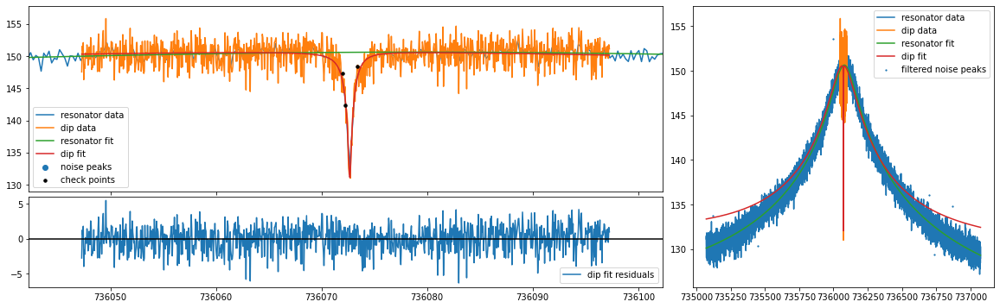

mean fit residuals = -1.6e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8238789292746054 0.09011388340877813
736069.8000825519 736069.8000825519 736069.8000825519 736069.8000825519 736069.8000825519
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_230526.331559
nu_z                736072.676901943516
dnu_z                    0.013289910319
dip_width                1.823878929275
ddip_width               0.090113883409
fit_err                   3.22103454448
fit_success                        True
average_idx                           0
nu_res              736069.800082551898
dnu_res                  0.403953988987
Q                     4553.634193267018
dQ                       31.78321971371
th                      -0.000462512097
dth                      0.000017453568
off     

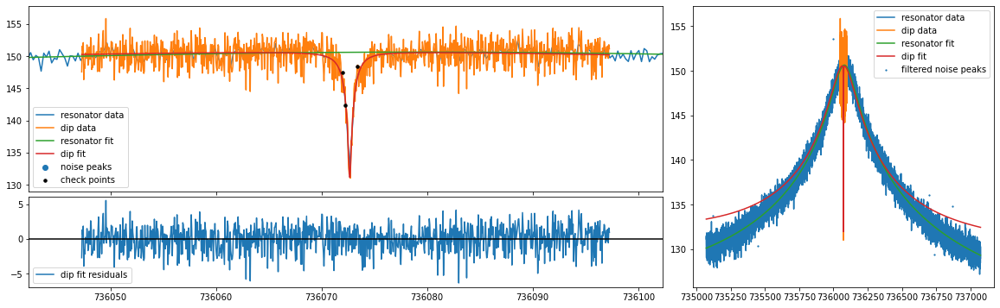

mean fit residuals = 3.2e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8250064595601239 0.08986527793368278
736071.8000825519 736071.8000825519 736071.8000825519 736071.8000825519 736071.8000825519
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_230526.331559
nu_z                736072.674434162676
dnu_z                    0.013251067556
dip_width                 1.82500645956
ddip_width               0.089865277934
fit_err                  3.203008898964
fit_success                        True
average_idx                           0
nu_res              736071.800082551898
dnu_res                  0.403953988987
Q                     4553.634193267018
dQ                       31.78321971371
th                      -0.000462512097
dth                      0.000017453568
off      

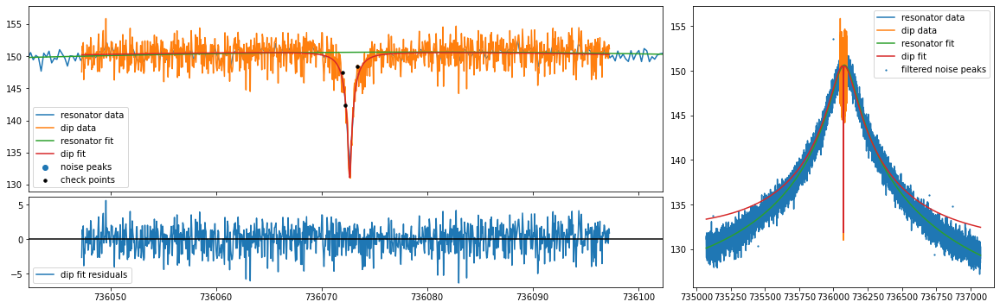

mean fit residuals = -1.9e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.827220378721304 0.08968646684764417
736073.8000825519 736073.8000825519 736073.8000825519 736073.8000825519 736073.8000825519
mcycle                                 1
cycle                                  5
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_230526.331559
nu_z                 736072.671962018008
dnu_z                     0.013221796787
dip_width                 1.827220378721
ddip_width                0.089686466848
fit_err                   3.188072772319
fit_success                         True
average_idx                            0
nu_res               736073.800082551898
dnu_res                   0.403953988987
Q                      4553.634193267018
dQ                        31.78321971371
th                       -0.000462512097
dth                       0.000

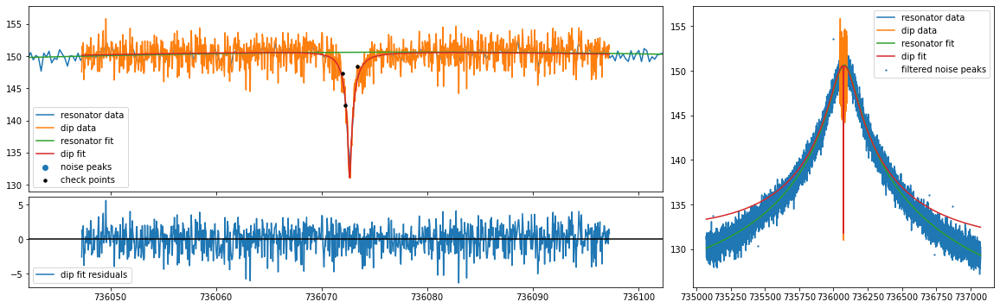

mean fit residuals = -1.9e-07 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8304382753063986 0.08957203052619449
736075.8000825519 736075.8000825519 736075.8000825519 736075.8000825519 736075.8000825519
mcycle                                 1
cycle                                  5
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_230526.331559
nu_z                 736072.669485043385
dnu_z                     0.013200069145
dip_width                 1.830438275306
ddip_width                0.089572030526
fit_err                   3.176259124696
fit_success                         True
average_idx                            0
nu_res               736075.800082551898
dnu_res                   0.403953988987
Q                      4553.634193267018
dQ                        31.78321971371
th                       -0.000462512097
dth                       0.00

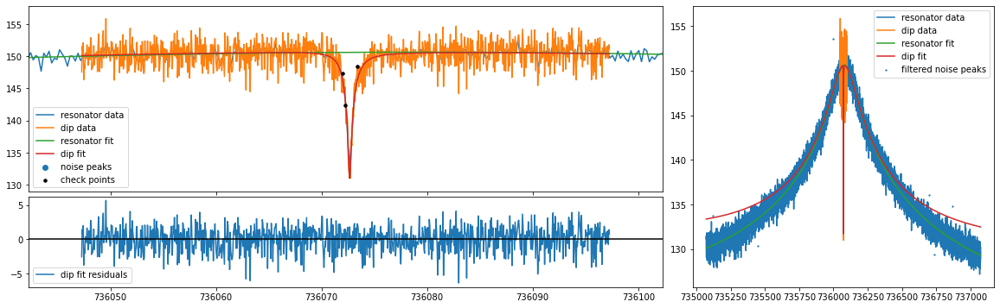

mean fit residuals = -1.8e-04 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8357268907003532 0.08960581378155423
736077.8000825519 736077.8000825519 736077.8000825519 736077.8000825519 736077.8000825519
mcycle                                 1
cycle                                  5
position                      position_1
trap                                   2
acc_time                           20.05
time              20211128_230526.331559
nu_z                  736072.66685266979
dnu_z                     0.013215819415
dip_width                   1.8357268907
ddip_width                0.089605813782
fit_err                   3.167574193485
fit_success                         True
average_idx                            0
nu_res               736077.800082551898
dnu_res                   0.403953988987
Q                      4553.634193267018
dQ                        31.78321971371
th                       -0.000462512097
dth                       0.00

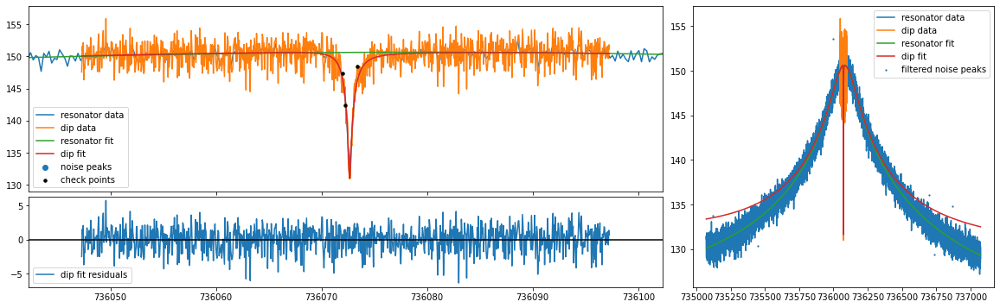

mean fit residuals = -1.9e-04 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8411561449076748 0.08963692095619814
736079.8000825519 736079.8000825519 736079.8000825519 736079.8000825519 736079.8000825519
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_230526.331559
nu_z                736072.664273153874
dnu_z                    0.013215243705
dip_width                1.841156144908
ddip_width               0.089636920956
fit_err                  3.161998165845
fit_success                        True
average_idx                           0
nu_res              736079.800082551898
dnu_res                  0.403953988987
Q                     4553.634193267018
dQ                       31.78321971371
th                      -0.000462512097
dth                      0.000017453568
off     

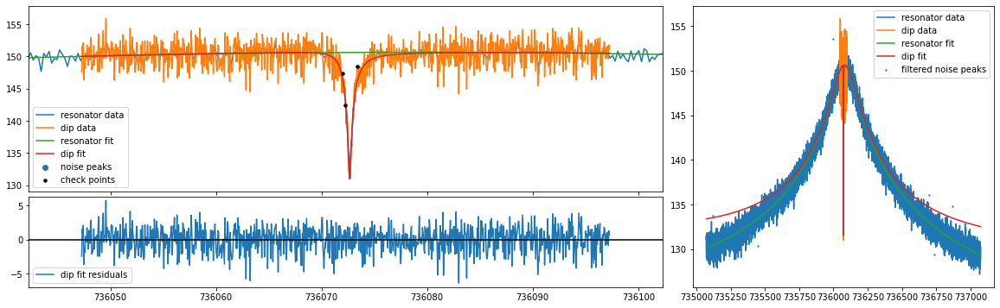

mean fit residuals = -2.0e-04 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8478082027146927 0.08974585138528847
736081.8000825519 736081.8000825519 736081.8000825519 736081.8000825519 736081.8000825519
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_230526.331559
nu_z                736072.661694710492
dnu_z                    0.013226847194
dip_width                1.847808202715
ddip_width               0.089745851385
fit_err                  3.159487100159
fit_success                        True
average_idx                           0
nu_res              736081.800082551898
dnu_res                  0.403953988987
Q                     4553.634193267018
dQ                       31.78321971371
th                      -0.000462512097
dth                      0.000017453568
off     

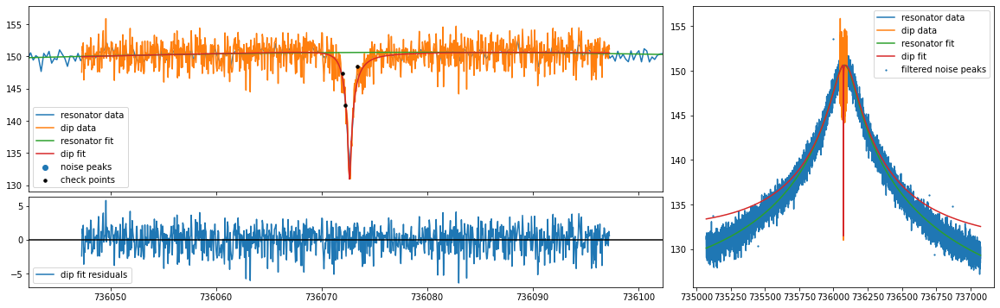

mean fit residuals = -3.5e-07 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8543571130707297 0.08983289808791763
736083.8000825519 736083.8000825519 736083.8000825519 736083.8000825519 736083.8000825519
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_230526.331559
nu_z                736072.659601924475
dnu_z                    0.013215808967
dip_width                1.854357113071
ddip_width               0.089832898088
fit_err                  3.159970942703
fit_success                        True
average_idx                           0
nu_res              736083.800082551898
dnu_res                  0.403953988987
Q                     4553.634193267018
dQ                       31.78321971371
th                      -0.000462512097
dth                      0.000017453568
off     

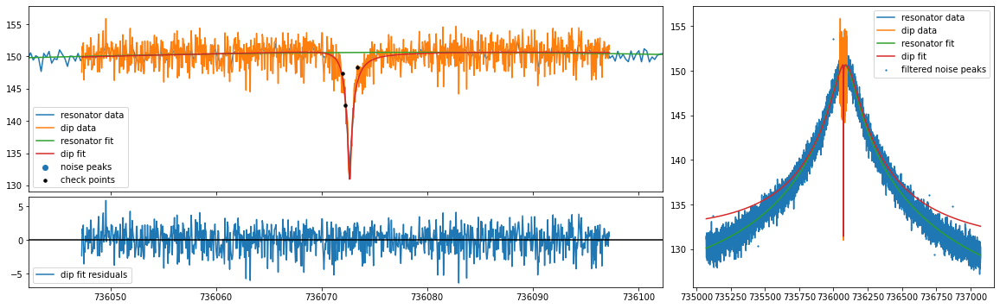

mean fit residuals = -4.9e-07 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8629565748934862 0.09006670336466545
736085.8000825519 736085.8000825519 736085.8000825519 736085.8000825519 736085.8000825519
mcycle                               1
cycle                                5
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_230526.331559
nu_z               736072.657154047629
dnu_z                    0.01324281122
dip_width               1.862956574893
ddip_width              0.090066703365
fit_err                 3.163359160518
fit_success                       True
average_idx                          0
nu_res             736085.800082551898
dnu_res                 0.403953988987
Q                    4553.634193267018
dQ                      31.78321971371
th                     -0.000462512097
dth                     0.000017453568
off            123834445909

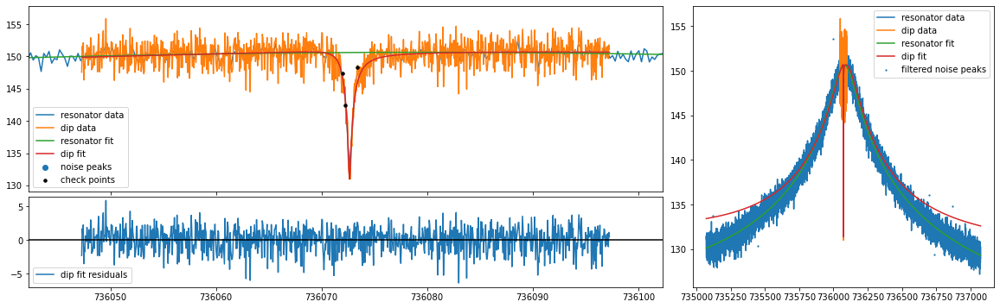

mean fit residuals = -8.0e-07 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.872564518403347 0.09036448481809276
736087.8000825519 736087.8000825519 736087.8000825519 736087.8000825519 736087.8000825519
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_230526.331559
nu_z                736072.654718398233
dnu_z                    0.013278622233
dip_width                1.872564518403
ddip_width               0.090364484818
fit_err                  3.169541540264
fit_success                        True
average_idx                           0
nu_res              736087.800082551898
dnu_res                  0.403953988987
Q                     4553.634193267018
dQ                       31.78321971371
th                      -0.000462512097
dth                      0.000017453568
off      

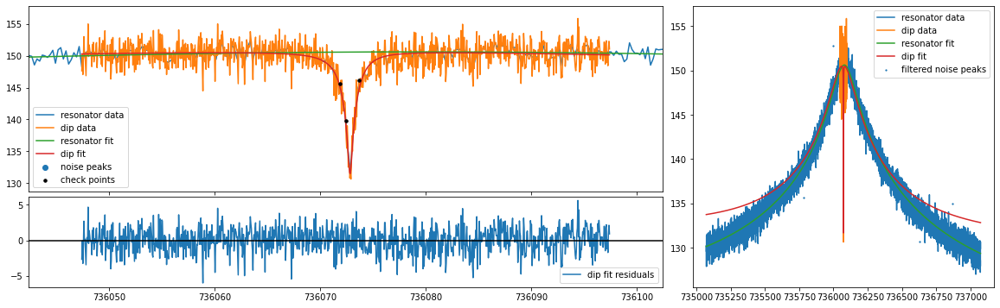

mean fit residuals = 1.5e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9935795359568216 0.11659944350584296
736069.8179352862 736069.8179352862 736069.8179352862 736069.8179352862 736069.8179352862
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_225508.333854
nu_z                736072.838514257804
dnu_z                    0.017322114852
dip_width                2.993579535957
ddip_width               0.116599443506
fit_err                  3.014757618973
fit_success                        True
average_idx                           0
nu_res              736069.817935286206
dnu_res                  0.413279701991
Q                     4542.761744176369
dQ                      32.360695661895
th                      -0.000449353375
dth                       0.00001781761
off            14052090675433.138671875
doff           

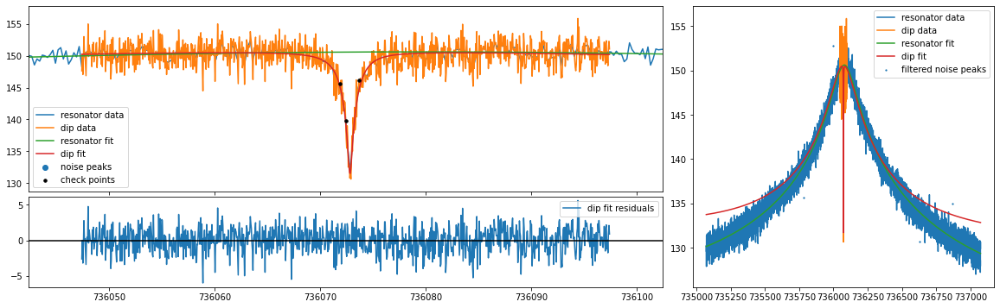

mean fit residuals = 2.2e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.99815491416203 0.11647629542578716
736071.8179352862 736071.8179352862 736071.8179352862 736071.8179352862 736071.8179352862
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_225508.333854
nu_z                736072.834755953285
dnu_z                    0.017314166782
dip_width                2.998154914162
ddip_width               0.116476295426
fit_err                  3.001756690832
fit_success                        True
average_idx                           0
nu_res              736071.817935286206
dnu_res                  0.413279701991
Q                     4542.761744176369
dQ                      32.360695661895
th                      -0.000449353375
dth                       0.00001781761
off            14084610074774.275390625
doff            2

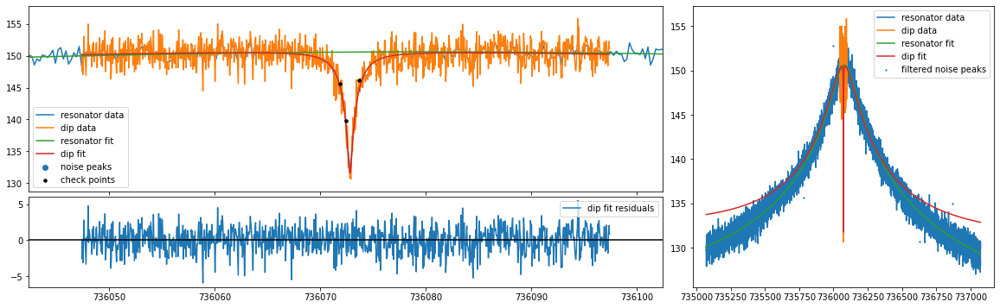

mean fit residuals = 1.2e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0046252225119243 0.11645616008410106
736073.8179352862 736073.8179352862 736073.8179352862 736073.8179352862 736073.8179352862
mcycle                               1
cycle                                5
position                    position_2
trap                                 2
acc_time                         20.05
time            20211128_225508.333854
nu_z               736072.830976736033
dnu_z                   0.017322003009
dip_width               3.004625222512
ddip_width              0.116456160084
fit_err                 2.992253231889
fit_success                       True
average_idx                          0
nu_res             736073.817935286206
dnu_res                 0.413279701991
Q                    4542.761744176369
dQ                     32.360695661895
th                     -0.000449353375
dth                      0.00001781761
off                 14132520861130.625
doff            2577204861778.63671

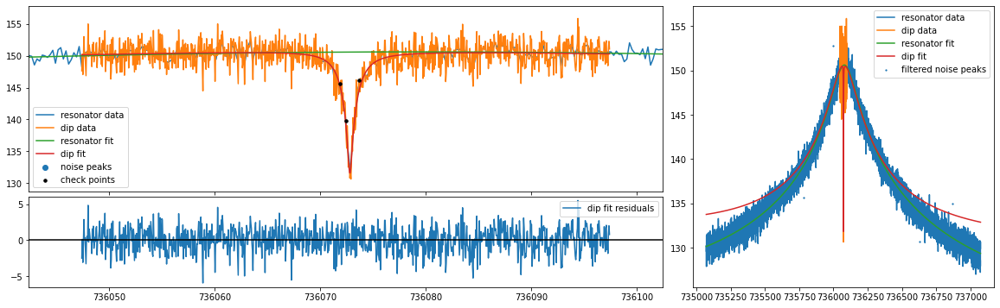

mean fit residuals = -1.3e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 3.012990269533022 0.11653952744360822
736075.8179352862 736075.8179352862 736075.8179352862 736075.8179352862 736075.8179352862
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_225508.333854
nu_z                736072.827176223509
dnu_z                    0.017345707364
dip_width                3.012990269533
ddip_width               0.116539527444
fit_err                   2.98626148403
fit_success                        True
average_idx                           0
nu_res              736075.817935286206
dnu_res                  0.413279701991
Q                     4542.761744176369
dQ                      32.360695661895
th                      -0.000449353375
dth                       0.00001781761
off            14195847264543.470703125
doff           

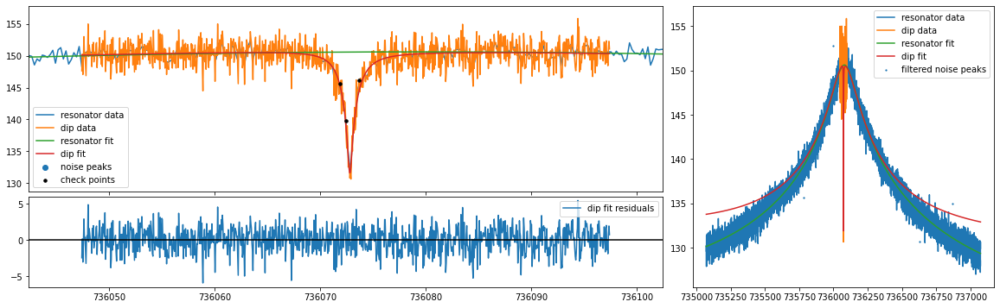

mean fit residuals = -2.1e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 3.0232396207227383 0.11672617923521089
736077.8179352862 736077.8179352862 736077.8179352862 736077.8179352862 736077.8179352862
mcycle                                 1
cycle                                  5
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_225508.333854
nu_z                 736072.823354228749
dnu_z                     0.017385221746
dip_width                 3.023239620723
ddip_width                0.116726179235
fit_err                   2.983771917897
fit_success                         True
average_idx                            0
nu_res               736077.817935286206
dnu_res                   0.413279701991
Q                      4542.761744176369
dQ                       32.360695661895
th                       -0.000449353375
dth                        0.00001781761
off               14274510164499.53

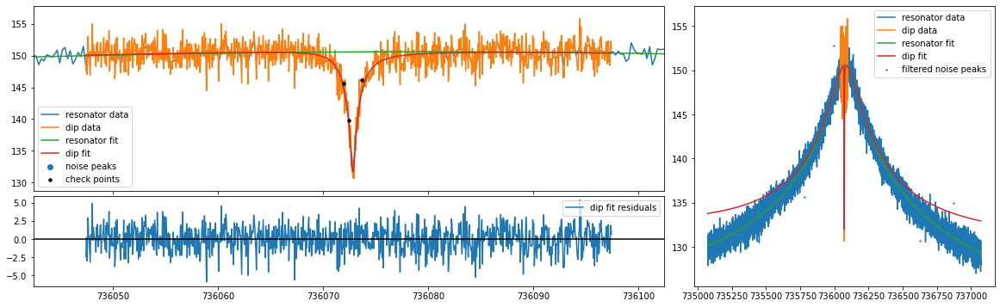

mean fit residuals = 2.3e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 3.0353484373104553 0.11701501994170115
736079.8179352862 736079.8179352862 736079.8179352862 736079.8179352862 736079.8179352862
mcycle                               1
cycle                                5
position                    position_2
trap                                 2
acc_time                         20.05
time            20211128_225508.333854
nu_z               736072.819511174341
dnu_z                   0.017440314172
dip_width                3.03534843731
ddip_width              0.117015019942
fit_err                  2.98475178948
fit_success                       True
average_idx                          0
nu_res             736079.817935286206
dnu_res                 0.413279701991
Q                    4542.761744176369
dQ                     32.360695661895
th                     -0.000449353375
dth                      0.00001781761
off            14368273607054.76171875
doff             2597324322662.9609

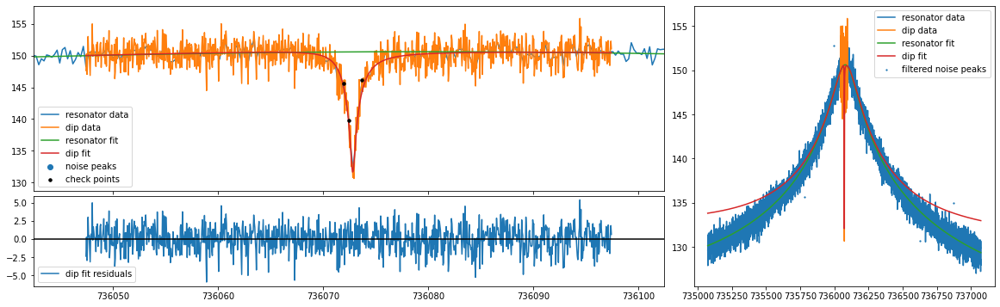

mean fit residuals = -1.6e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 3.049294568869654 0.11740484002946236
736081.8179352862 736081.8179352862 736081.8179352862 736081.8179352862 736081.8179352862
mcycle                                 1
cycle                                  5
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_225508.333854
nu_z                 736072.815646658652
dnu_z                     0.017510798826
dip_width                  3.04929456887
ddip_width                0.117404840029
fit_err                   2.989146199401
fit_success                         True
average_idx                            0
nu_res               736081.817935286206
dnu_res                   0.413279701991
Q                      4542.761744176369
dQ                       32.360695661895
th                       -0.000449353375
dth                        0.00001781761
off               14477161821065.039

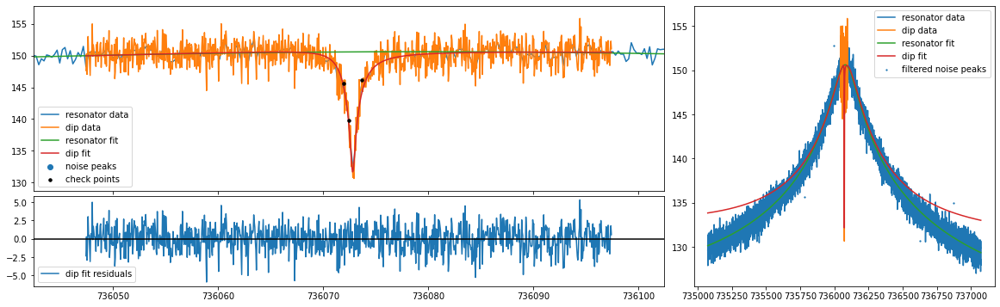

mean fit residuals = -3.4e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0650358846723997 0.11789332129238761
736083.8179352862 736083.8179352862 736083.8179352862 736083.8179352862 736083.8179352862
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_225508.333854
nu_z                736072.811761356192
dnu_z                    0.017596229584
dip_width                3.065035884672
ddip_width               0.117893321292
fit_err                  2.996879578267
fit_success                        True
average_idx                           0
nu_res              736083.817935286206
dnu_res                  0.413279701991
Q                     4542.761744176369
dQ                      32.360695661895
th                      -0.000449353375
dth                       0.00001781761
off             14600854130618.51171875
doff          

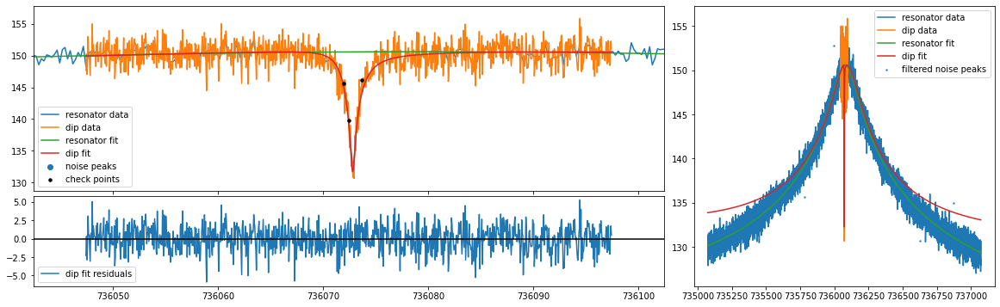

mean fit residuals = 2.2e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0825229783738615 0.11847762514668521
736085.8179352862 736085.8179352862 736085.8179352862 736085.8179352862 736085.8179352862
mcycle                               1
cycle                                5
position                    position_2
trap                                 2
acc_time                         20.05
time            20211128_225508.333854
nu_z                736072.80785587139
dnu_z                   0.017696071014
dip_width               3.082522978374
ddip_width              0.118477625147
fit_err                  3.00785757642
fit_success                       True
average_idx                          0
nu_res             736085.817935286206
dnu_res                 0.413279701991
Q                    4542.761744176369
dQ                     32.360695661895
th                     -0.000449353375
dth                      0.00001781761
off             14739002682040.5390625
doff           2647554369872.529296

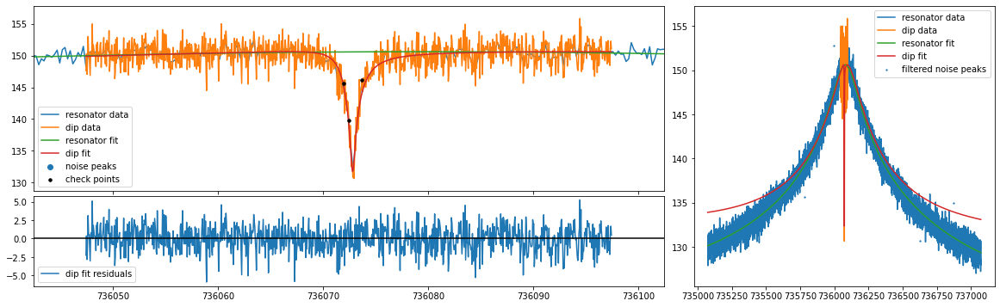

mean fit residuals = 3.0e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 3.101699795576864 0.11915450891691183
736087.8179352862 736087.8179352862 736087.8179352862 736087.8179352862 736087.8179352862
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_225508.333854
nu_z                736072.803931033239
dnu_z                    0.017809724747
dip_width                3.101699795577
ddip_width               0.119154508917
fit_err                  3.021969256415
fit_success                        True
average_idx                           0
nu_res              736087.817935286206
dnu_res                  0.413279701991
Q                     4542.761744176369
dQ                      32.360695661895
th                      -0.000449353375
dth                       0.00001781761
off            14891277135132.658203125
doff            

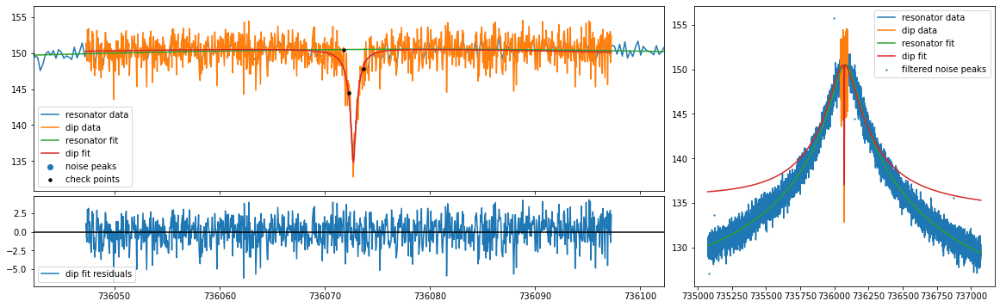

mean fit residuals = -6.4e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.714709959477644 0.09815482038607137
736070.030183042 736070.030183042 736070.030183042 736070.030183042 736070.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.740489989519
dnu_z                    0.017833305882
dip_width                1.714709959478
ddip_width               0.098154820386
fit_err                  3.193022502065
fit_success                        True
average_idx                           0
nu_res               736070.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off           

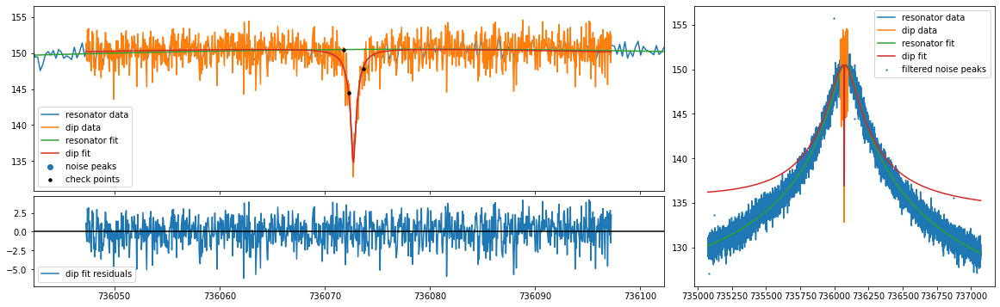

mean fit residuals = -5.6e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7097166292018937 0.09763311206481005
736072.030183042 736072.030183042 736072.030183042 736072.030183042 736072.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.736972597893
dnu_z                    0.017702860553
dip_width                1.709716629202
ddip_width               0.097633112065
fit_err                  3.181311236722
fit_success                        True
average_idx                           0
nu_res               736072.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off          

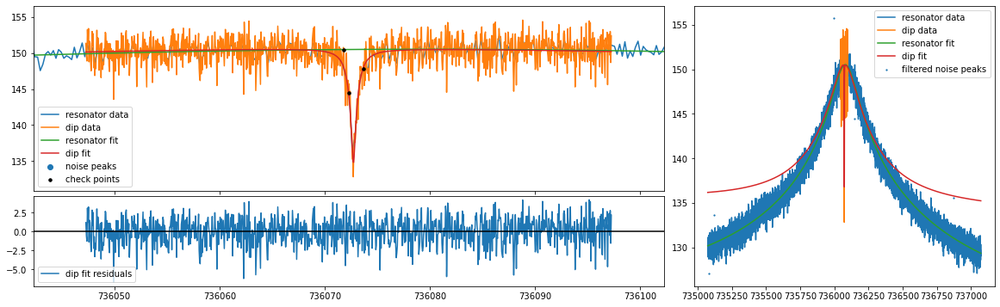

mean fit residuals = -4.3e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.706146147880916 0.09721775420572054
736074.030183042 736074.030183042 736074.030183042 736074.030183042 736074.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.733556258143
dnu_z                    0.017595435702
dip_width                1.706146147881
ddip_width               0.097217754206
fit_err                   3.17236344059
fit_success                        True
average_idx                           0
nu_res               736074.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off           

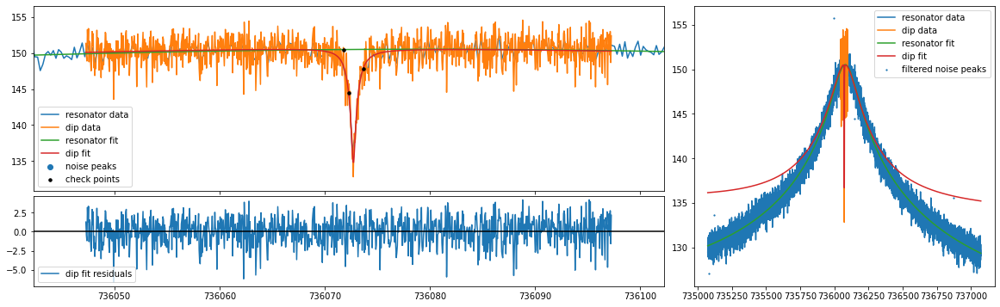

mean fit residuals = -5.1e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7037118292784645 0.09688801653285938
736076.030183042 736076.030183042 736076.030183042 736076.030183042 736076.030183042
mcycle                               1
cycle                                6
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_232602.045424
nu_z               736072.730181463878
dnu_z                   0.017504472465
dip_width               1.703711829278
ddip_width              0.096888016533
fit_err                 3.166209963575
fit_success                       True
average_idx                          0
nu_res              736076.03018304205
dnu_res                 0.408857778994
Q                    4497.908307830265
dQ                     31.358238277391
th                     -0.000474130109
dth                     0.000017519373
off            29647720967553.94

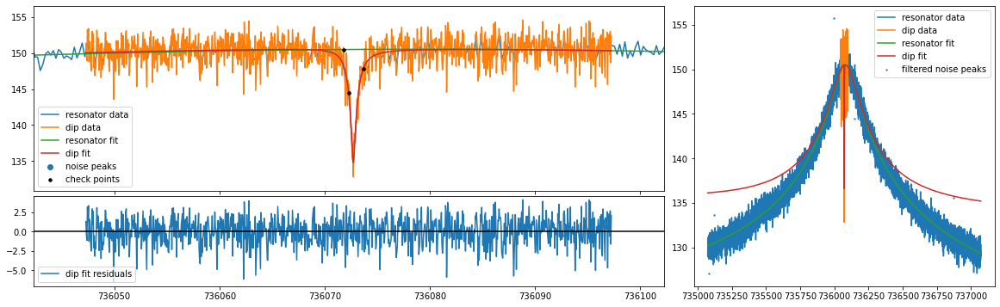

mean fit residuals = -3.1e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7025902760620164 0.09665659811044267
736078.030183042 736078.030183042 736078.030183042 736078.030183042 736078.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.726881225477
dnu_z                     0.01743392661
dip_width                1.702590276062
ddip_width                0.09665659811
fit_err                  3.162856034666
fit_success                        True
average_idx                           0
nu_res               736078.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off          

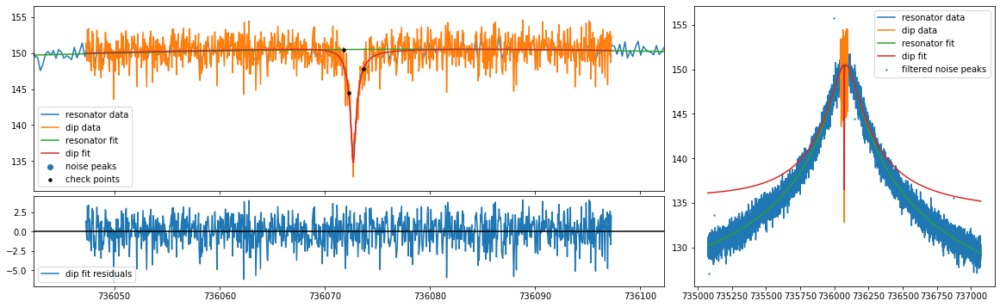

mean fit residuals = -2.2e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.702761217638994 0.09652187493067187
736080.030183042 736080.030183042 736080.030183042 736080.030183042 736080.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.723649559193
dnu_z                    0.017383319486
dip_width                1.702761217639
ddip_width               0.096521874931
fit_err                  3.162281592023
fit_success                        True
average_idx                           0
nu_res               736080.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off           

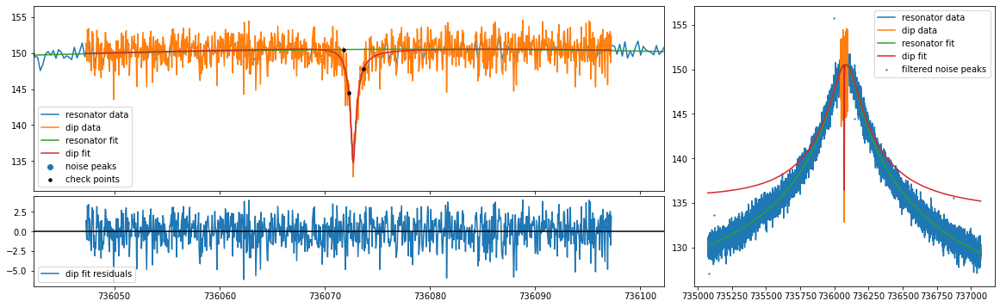

mean fit residuals = -3.0e-06 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7047379295985843 0.0965203631980327
736082.030183042 736082.030183042 736082.030183042 736082.030183042 736082.030183042
mcycle                               1
cycle                                6
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_232602.045424
nu_z               736072.720555940177
dnu_z                   0.017364184148
dip_width               1.704737929599
ddip_width              0.096520363198
fit_err                 3.164442119729
fit_success                       True
average_idx                          0
nu_res              736082.03018304205
dnu_res                 0.408857778994
Q                    4497.908307830265
dQ                     31.358238277391
th                     -0.000474130109
dth                     0.000017519373
off             29335001575678.55

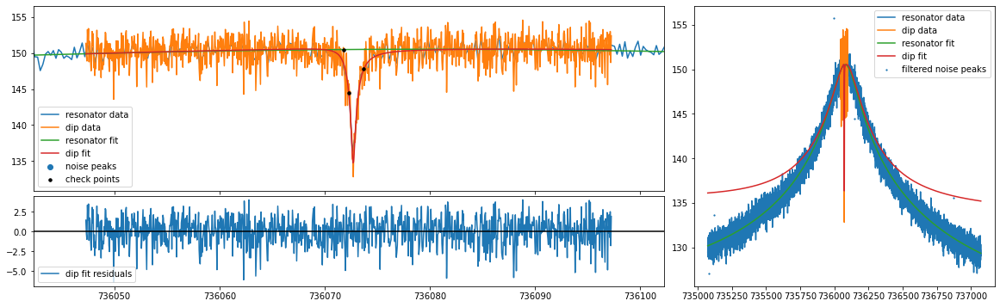

mean fit residuals = -3.4e-06 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7074142037221243 0.09657125678196025
736084.030183042 736084.030183042 736084.030183042 736084.030183042 736084.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.717423792812
dnu_z                    0.017351253511
dip_width                1.707414203722
ddip_width               0.096571256782
fit_err                   3.16927024768
fit_success                        True
average_idx                           0
nu_res               736084.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off          

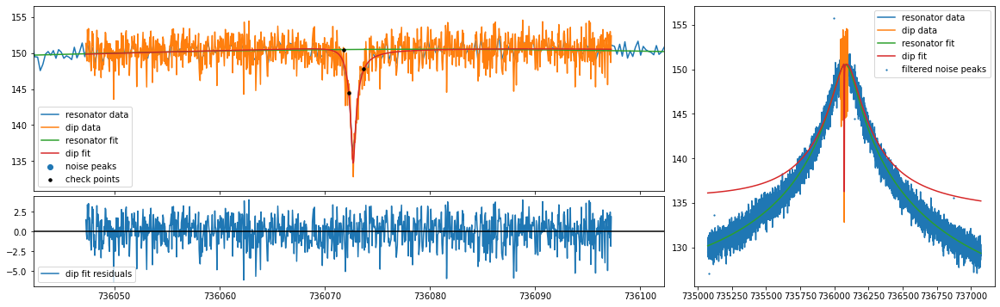

mean fit residuals = -4.5e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7107316996798043 0.0966725195304408
736086.030183042 736086.030183042 736086.030183042 736086.030183042 736086.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                736072.714304270106
dnu_z                    0.017344339246
dip_width                 1.71073169968
ddip_width                0.09667251953
fit_err                  3.176677317886
fit_success                        True
average_idx                           0
nu_res               736086.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off           

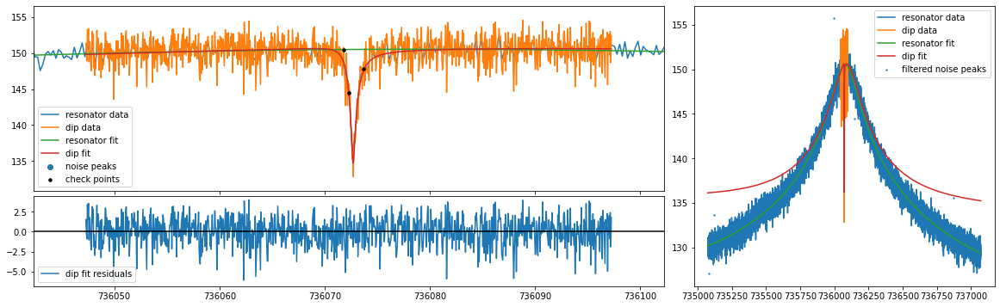

mean fit residuals = 8.7e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7156919683991319 0.09689315605963017
736088.030183042 736088.030183042 736088.030183042 736088.030183042 736088.030183042
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_232602.045424
nu_z                 736072.71128520905
dnu_z                    0.017365047972
dip_width                1.715691968399
ddip_width                0.09689315606
fit_err                   3.18655582094
fit_success                        True
average_idx                           0
nu_res               736088.03018304205
dnu_res                  0.408857778994
Q                     4497.908307830265
dQ                      31.358238277391
th                      -0.000474130109
dth                      0.000017519373
off           

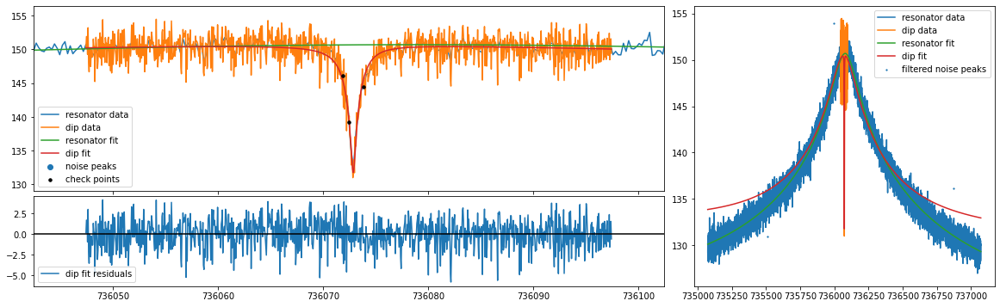

mean fit residuals = 1.3e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9502730886397845 0.1175113110257667
736069.2499021159 736069.2499021159 736069.2499021159 736069.2499021159 736069.2499021159
mcycle                                 1
cycle                                  6
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_231544.080242
nu_z                 736072.860021130997
dnu_z                     0.017809742142
dip_width                  2.95027308864
ddip_width                0.117511311026
fit_err                   3.056735069006
fit_success                         True
average_idx                            0
nu_res               736069.249902115902
dnu_res                   0.413547556043
Q                      4583.648838886719
dQ                       33.008555176554
th                       -0.000446957644
dth                       0.000017923241
off               15004976904364.2890

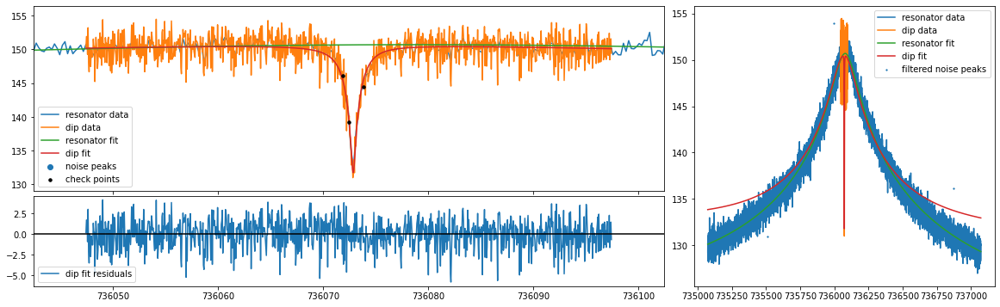

mean fit residuals = 2.7e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9523401878667386 0.1172848281379342
736071.2499021159 736071.2499021159 736071.2499021159 736071.2499021159 736071.2499021159
mcycle                                 1
cycle                                  6
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_231544.080242
nu_z                 736072.855687264819
dnu_z                     0.017770159767
dip_width                 2.952340187867
ddip_width                0.117284828138
fit_err                   3.043924433313
fit_success                         True
average_idx                            0
nu_res               736071.249902115902
dnu_res                   0.413547556043
Q                      4583.648838886719
dQ                       33.008555176554
th                       -0.000446957644
dth                       0.000017923241
off             14971941743506.541015

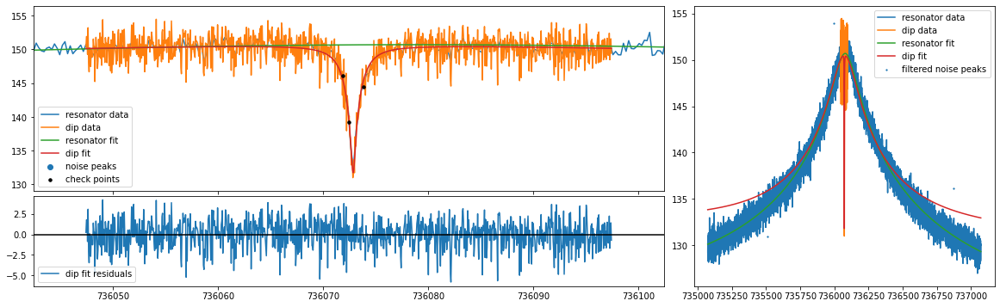

mean fit residuals = -3.4e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9564281024849897 0.11716712397880016
736073.2499021159 736073.2499021159 736073.2499021159 736073.2499021159 736073.2499021159
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_231544.080242
nu_z                736072.851373590296
dnu_z                    0.017747839052
dip_width                2.956428102485
ddip_width               0.117167123979
fit_err                  3.034642068564
fit_success                        True
average_idx                           0
nu_res              736073.249902115902
dnu_res                  0.413547556043
Q                     4583.648838886719
dQ                      33.008555176554
th                      -0.000446957644
dth                      0.000017923241
off             14956872171243.69921875
doff          

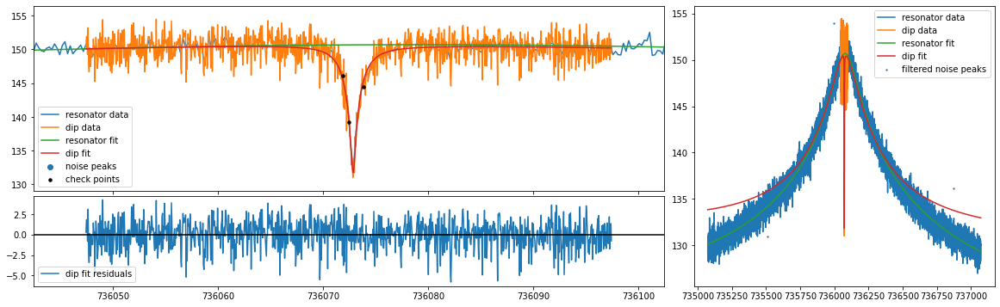

mean fit residuals = 3.9e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.962517587417294 0.11715728999253609
736075.2499021159 736075.2499021159 736075.2499021159 736075.2499021159 736075.2499021159
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_231544.080242
nu_z                736072.847074892605
dnu_z                    0.017742457463
dip_width                2.962517587417
ddip_width               0.117157289993
fit_err                   3.02888941065
fit_success                        True
average_idx                           0
nu_res              736075.249902115902
dnu_res                  0.413547556043
Q                     4583.648838886719
dQ                      33.008555176554
th                      -0.000446957644
dth                      0.000017923241
off             14959020805231.12109375
doff           2

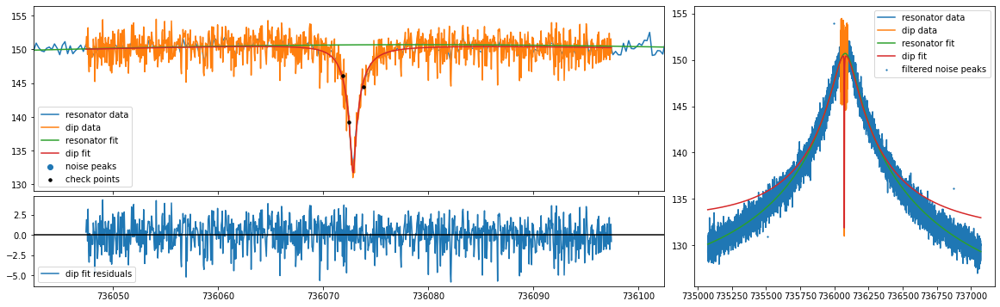

mean fit residuals = -3.5e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.970612410537764 0.11725530993965154
736077.2499021159 736077.2499021159 736077.2499021159 736077.2499021159 736077.2499021159
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_231544.080242
nu_z                736072.842793188407
dnu_z                    0.017754086182
dip_width                2.970612410538
ddip_width                0.11725530994
fit_err                  3.026642038426
fit_success                        True
average_idx                           0
nu_res              736077.249902115902
dnu_res                  0.413547556043
Q                     4583.648838886719
dQ                      33.008555176554
th                      -0.000446957644
dth                      0.000017923241
off            14978641812290.291015625
doff           

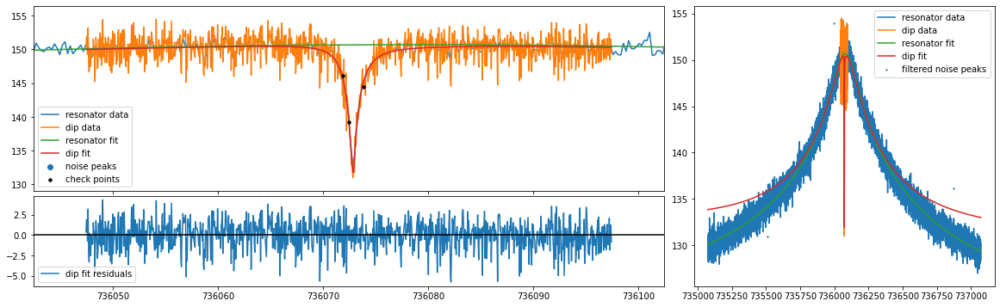

mean fit residuals = 9.8e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9806889609470426 0.11745963408944016
736079.2499021159 736079.2499021159 736079.2499021159 736079.2499021159 736079.2499021159
mcycle                                 1
cycle                                  6
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_231544.080242
nu_z                 736072.838527380838
dnu_z                     0.017782382595
dip_width                 2.980688960947
ddip_width                0.117459634089
fit_err                   3.027850369877
fit_success                         True
average_idx                            0
nu_res               736079.249902115902
dnu_res                   0.413547556043
Q                      4583.648838886719
dQ                       33.008555176554
th                       -0.000446957644
dth                       0.000017923241
off             15015351355564.42773

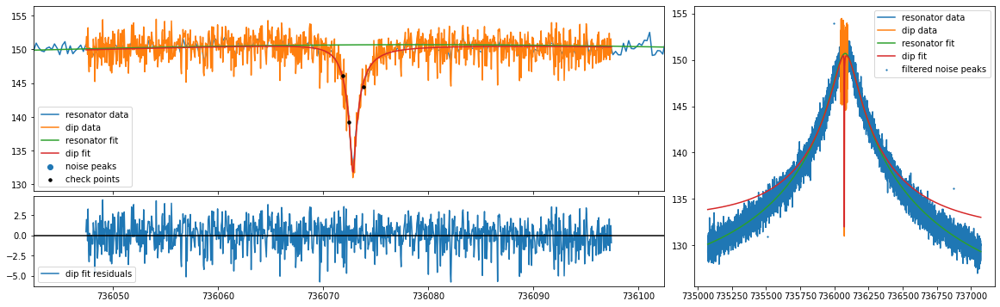

mean fit residuals = -5.6e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.99271699917386 0.11776814106487467
736081.2499021159 736081.2499021159 736081.2499021159 736081.2499021159 736081.2499021159
mcycle                                 1
cycle                                  6
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_231544.080242
nu_z                 736072.834276490612
dnu_z                     0.017826951448
dip_width                 2.992716999174
ddip_width                0.117768141065
fit_err                   3.032440936183
fit_success                         True
average_idx                            0
nu_res               736081.249902115902
dnu_res                   0.413547556043
Q                      4583.648838886719
dQ                       33.008555176554
th                       -0.000446957644
dth                       0.000017923241
off               15068861818669.9921

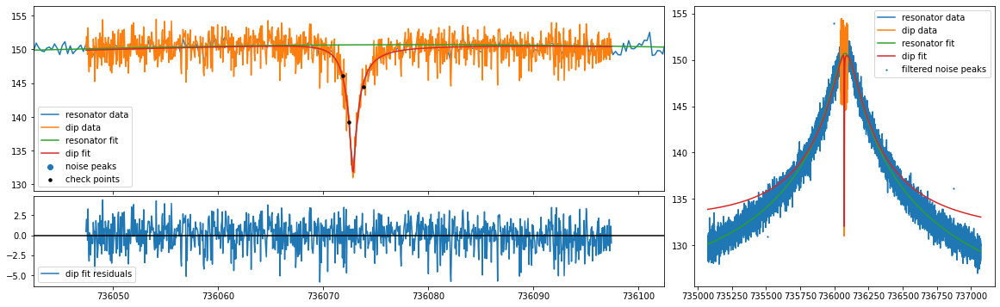

mean fit residuals = -7.8e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 3.006650694444202 0.11817769777450102
736083.2499021159 736083.2499021159 736083.2499021159 736083.2499021159 736083.2499021159
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_231544.080242
nu_z                736072.830039524706
dnu_z                    0.017887135758
dip_width                3.006650694444
ddip_width               0.118177697775
fit_err                  3.040318166265
fit_success                        True
average_idx                           0
nu_res              736083.249902115902
dnu_res                  0.413547556043
Q                     4583.648838886719
dQ                      33.008555176554
th                      -0.000446957644
dth                      0.000017923241
off             15138514964745.59765625
doff           

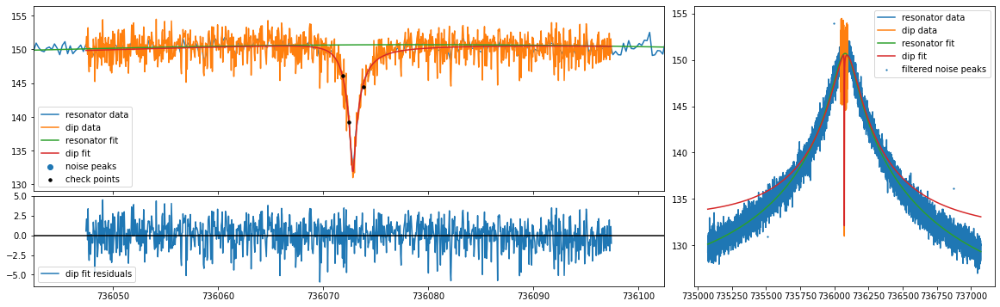

mean fit residuals = 2.9e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0224421375107404 0.11868505894887013
736085.2499021159 736085.2499021159 736085.2499021159 736085.2499021159 736085.2499021159
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_231544.080242
nu_z                736072.825815797201
dnu_z                    0.017962346731
dip_width                3.022442137511
ddip_width               0.118685058949
fit_err                  3.051366615171
fit_success                        True
average_idx                           0
nu_res              736085.249902115902
dnu_res                  0.413547556043
Q                     4583.648838886719
dQ                      33.008555176554
th                      -0.000446957644
dth                      0.000017923241
off            15223984964571.728515625
doff           

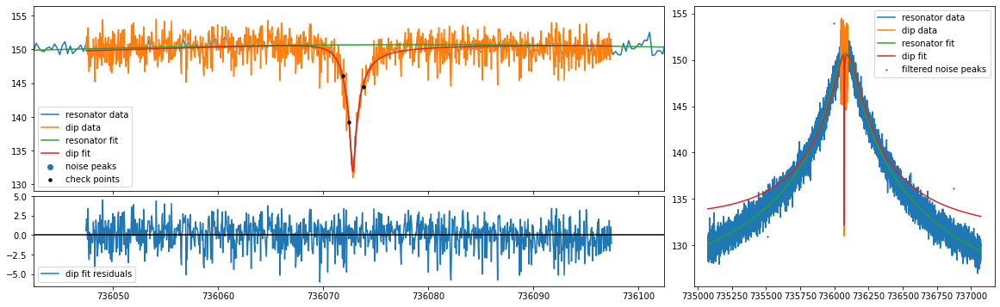

mean fit residuals = -1.6e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 3.040031576568894 0.11928620763522947
736087.2499021159 736087.2499021159 736087.2499021159 736087.2499021159 736087.2499021159
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_231544.080242
nu_z                736072.821604633704
dnu_z                     0.01805181133
dip_width                3.040031576569
ddip_width               0.119286207635
fit_err                  3.065453550224
fit_success                        True
average_idx                           0
nu_res              736087.249902115902
dnu_res                  0.413547556043
Q                     4583.648838886719
dQ                      33.008555176554
th                      -0.000446957644
dth                      0.000017923241
off             15324703945649.49609375
doff           

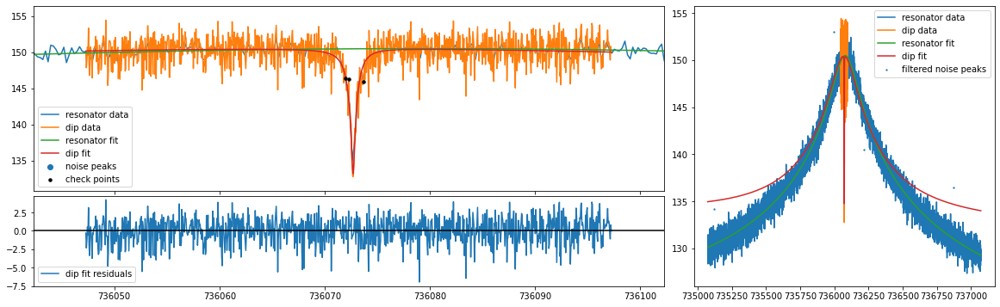

mean fit residuals = -1.2e-07 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7132429280586914 0.09218692033574366
736069.8097326494 736069.8097326494 736069.8097326494 736069.8097326494 736069.8097326494
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_234638.796581
nu_z                736072.702653366374
dnu_z                    0.015473840922
dip_width                1.713242928059
ddip_width               0.092186920336
fit_err                  3.144754316566
fit_success                        True
average_idx                           0
nu_res              736069.809732649359
dnu_res                  0.415084051544
Q                     4454.539785926825
dQ                      31.101730384838
th                      -0.000473816422
dth                      0.000017735566
off     

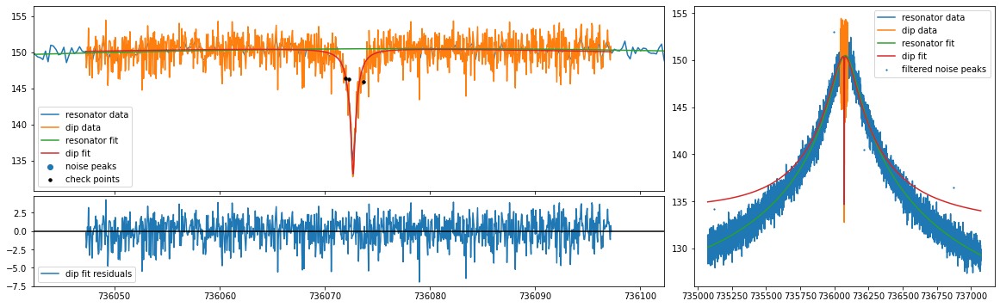

mean fit residuals = -4.2e-06 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.710888920830978 0.09191238379367017
736071.8097326494 736071.8097326494 736071.8097326494 736071.8097326494 736071.8097326494
mcycle                               1
cycle                                7
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_234638.796581
nu_z               736072.700199113344
dnu_z                   0.015419112786
dip_width               1.710888920831
ddip_width              0.091912383794
fit_err                 3.134678461616
fit_success                       True
average_idx                          0
nu_res             736071.809732649359
dnu_res                 0.415084051544
Q                    4454.539785926825
dQ                     31.101730384838
th                     -0.000473816422
dth                     0.000017735566
off             206647291969

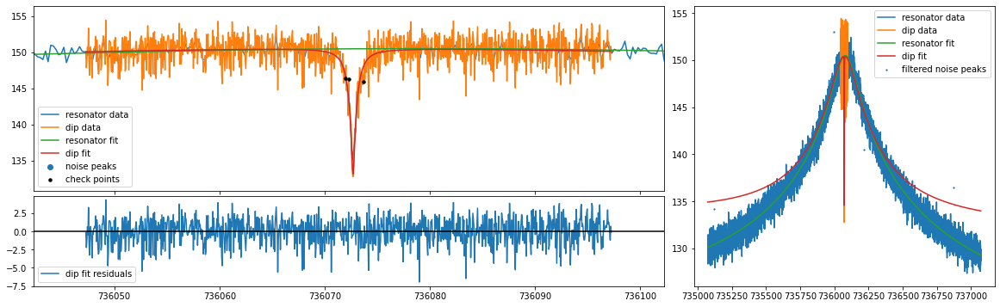

mean fit residuals = -3.8e-06 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.70860279762313 0.09164860421160688
736073.8097326494 736073.8097326494 736073.8097326494 736073.8097326494 736073.8097326494
mcycle                               1
cycle                                7
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_234638.796581
nu_z               736072.697663225583
dnu_z                   0.015357036469
dip_width               1.708602797623
ddip_width              0.091648604212
fit_err                 3.127485744586
fit_success                       True
average_idx                          0
nu_res             736073.809732649359
dnu_res                 0.415084051544
Q                    4454.539785926825
dQ                     31.101730384838
th                     -0.000473816422
dth                     0.000017735566
off             2054784003124

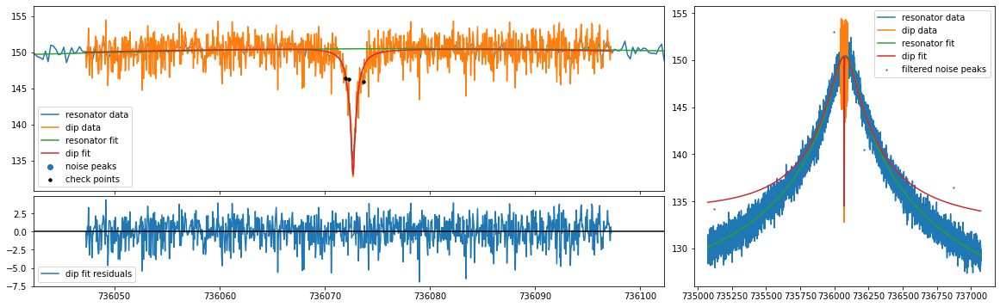

mean fit residuals = -3.5e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.706748723071406 0.09142000659621027
736075.8097326494 736075.8097326494 736075.8097326494 736075.8097326494 736075.8097326494
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_234638.796581
nu_z                736072.695108096348
dnu_z                    0.015295228244
dip_width                1.706748723071
ddip_width               0.091420006596
fit_err                  3.123193487131
fit_success                        True
average_idx                           0
nu_res              736075.809732649359
dnu_res                  0.415084051544
Q                     4454.539785926825
dQ                      31.101730384838
th                      -0.000473816422
dth                      0.000017735566
off      

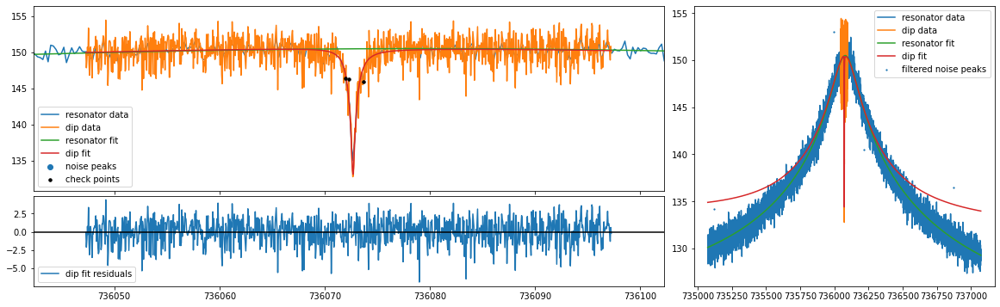

mean fit residuals = 7.1e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7070285640117768 0.0913370239218083
736077.8097326494 736077.8097326494 736077.8097326494 736077.8097326494 736077.8097326494
mcycle                               1
cycle                                7
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_234638.796581
nu_z                736072.69263160415
dnu_z                   0.015268187063
dip_width               1.707028564012
ddip_width              0.091337023922
fit_err                 3.121794107737
fit_success                       True
average_idx                          0
nu_res             736077.809732649359
dnu_res                 0.415084051544
Q                    4454.539785926825
dQ                     31.101730384838
th                     -0.000473816422
dth                     0.000017735566
off             2037602995594

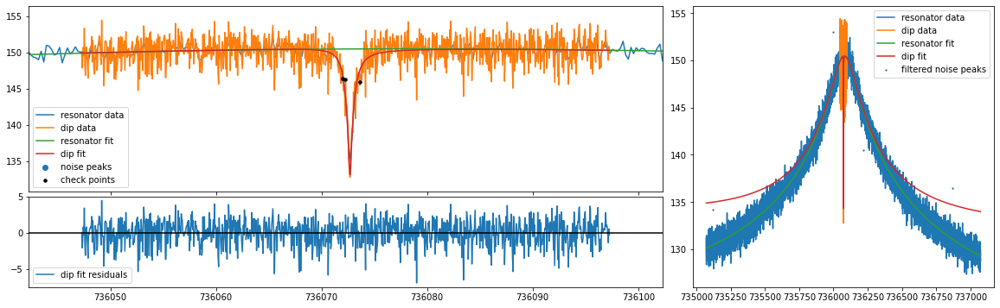

mean fit residuals = -6.1e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7083999281981173 0.09133201020630077
736079.8097326494 736079.8097326494 736079.8097326494 736079.8097326494 736079.8097326494
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_234638.796581
nu_z                736072.690170429181
dnu_z                    0.015254906949
dip_width                1.708399928198
ddip_width               0.091332010206
fit_err                   3.12325573022
fit_success                        True
average_idx                           0
nu_res              736079.809732649359
dnu_res                  0.415084051544
Q                     4454.539785926825
dQ                      31.101730384838
th                      -0.000473816422
dth                      0.000017735566
off     

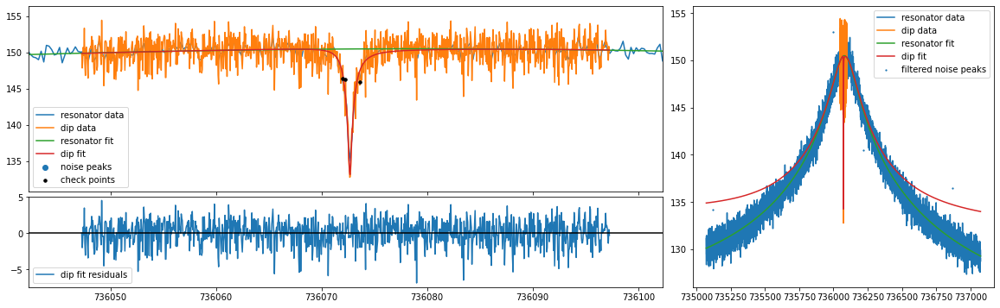

mean fit residuals = -1.3e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7110101003820137 0.09141383086802522
736081.8097326494 736081.8097326494 736081.8097326494 736081.8097326494 736081.8097326494
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_234638.796581
nu_z                736072.687724041636
dnu_z                    0.015258238447
dip_width                1.711010100382
ddip_width               0.091413830868
fit_err                  3.127523036057
fit_success                        True
average_idx                           0
nu_res              736081.809732649359
dnu_res                  0.415084051544
Q                     4454.539785926825
dQ                      31.101730384838
th                      -0.000473816422
dth                      0.000017735566
off     

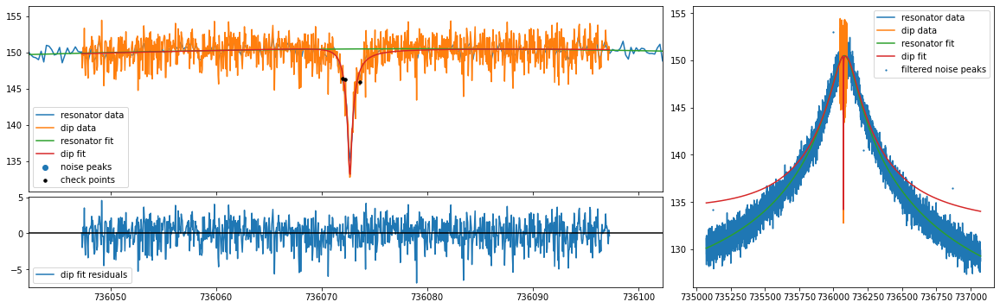

mean fit residuals = 4.9e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7147512586975133 0.09157518980500258
736083.8097326494 736083.8097326494 736083.8097326494 736083.8097326494 736083.8097326494
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_234638.796581
nu_z                736072.685289218789
dnu_z                    0.015276088206
dip_width                1.714751258698
ddip_width               0.091575189805
fit_err                  3.134518762932
fit_success                        True
average_idx                           0
nu_res              736083.809732649359
dnu_res                  0.415084051544
Q                     4454.539785926825
dQ                      31.101730384838
th                      -0.000473816422
dth                      0.000017735566
off      

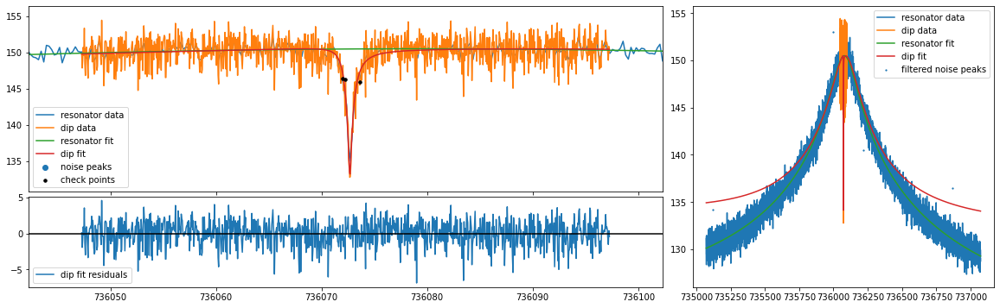

mean fit residuals = 1.3e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7195796014206461 0.09181272053824559
736085.8097326494 736085.8097326494 736085.8097326494 736085.8097326494 736085.8097326494
mcycle                               1
cycle                                7
position                    position_1
trap                                 2
acc_time                         20.05
time            20211128_234638.796581
nu_z               736072.682864399045
dnu_z                   0.015307631274
dip_width               1.719579601421
ddip_width              0.091812720538
fit_err                 3.144145547426
fit_success                       True
average_idx                          0
nu_res             736085.809732649359
dnu_res                 0.415084051544
Q                    4454.539785926825
dQ                     31.101730384838
th                     -0.000473816422
dth                     0.000017735566
off             205116016380

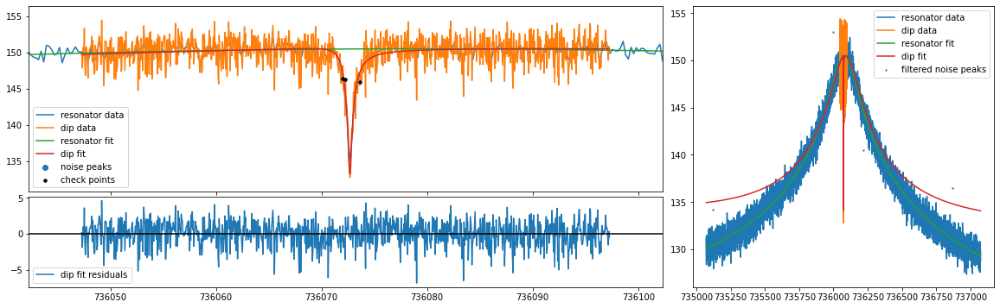

mean fit residuals = -6.4e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7254563838905386 0.09212324615771711
736087.8097326494 736087.8097326494 736087.8097326494 736087.8097326494 736087.8097326494
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211128_234638.796581
nu_z                 736072.68044831499
dnu_z                    0.015352127174
dip_width                1.725456383891
ddip_width               0.092123246158
fit_err                  3.156288159688
fit_success                        True
average_idx                           0
nu_res              736087.809732649359
dnu_res                  0.415084051544
Q                     4454.539785926825
dQ                      31.101730384838
th                      -0.000473816422
dth                      0.000017735566
off     

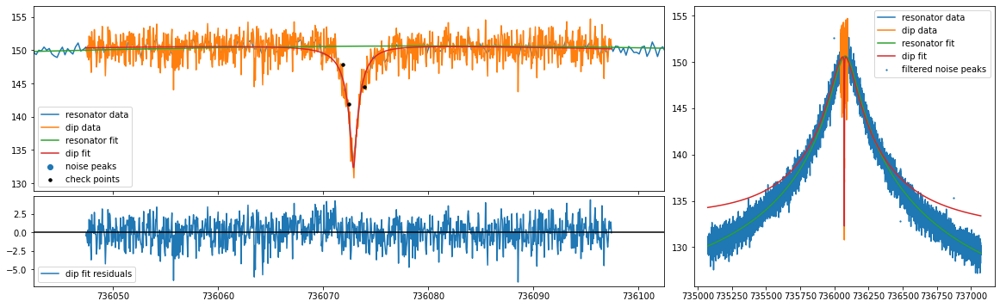

mean fit residuals = -6.8e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9428029282911234 0.11613123385317452
736069.8878406625 736069.8878406625 736069.8878406625 736069.8878406625 736069.8878406625
mcycle                                 1
cycle                                  7
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_233620.401925
nu_z                 736072.879169206251
dnu_z                     0.017965064512
dip_width                 2.942802928291
ddip_width                0.116131233853
fit_err                   2.928164712603
fit_success                         True
average_idx                            0
nu_res               736069.887840662501
dnu_res                   0.402592527405
Q                      4540.922480910626
dQ                       31.493503910321
th                       -0.000446334395
dth                        0.00001735577
off                16925689773694.6

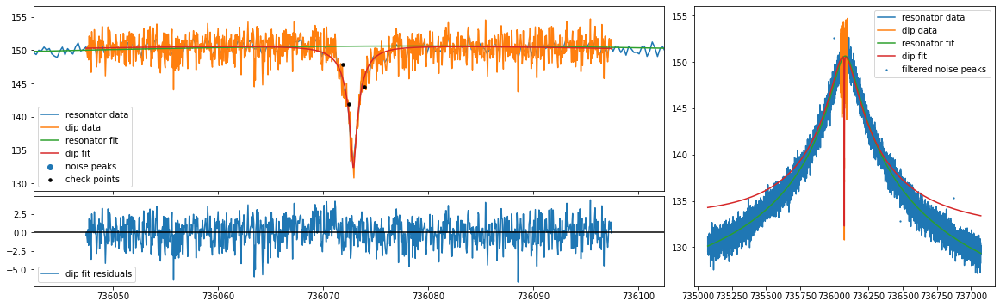

mean fit residuals = 2.4e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9487171377056027 0.11595539147158931
736071.8878406625 736071.8878406625 736071.8878406625 736071.8878406625 736071.8878406625
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_233620.401925
nu_z                736072.874445283203
dnu_z                    0.017945746619
dip_width                2.948717137706
ddip_width               0.115955391472
fit_err                  2.911613659406
fit_success                        True
average_idx                           0
nu_res              736071.887840662501
dnu_res                  0.402592527405
Q                     4540.922480910626
dQ                      31.493503910321
th                      -0.000446334395
dth                       0.00001735577
off            16956406712043.158203125
doff           

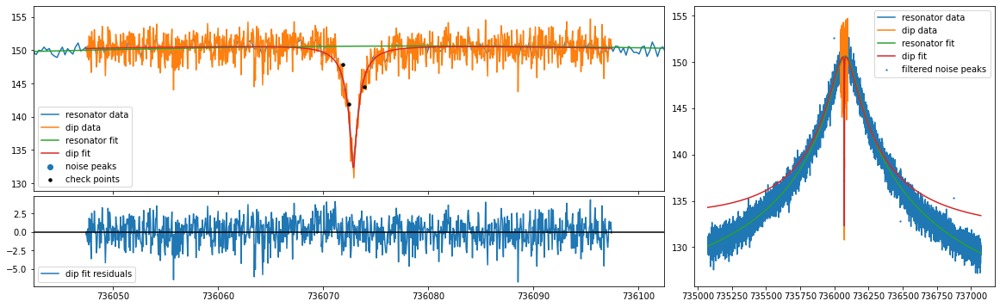

mean fit residuals = 7.9e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9565922149186314 0.11588183068763627
736073.8878406625 736073.8878406625 736073.8878406625 736073.8878406625 736073.8878406625
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_233620.401925
nu_z                736072.869688729756
dnu_z                    0.017942767673
dip_width                2.956592214919
ddip_width               0.115881830688
fit_err                   2.89831904219
fit_success                        True
average_idx                           0
nu_res              736073.887840662501
dnu_res                  0.402592527405
Q                     4540.922480910626
dQ                      31.493503910321
th                      -0.000446334395
dth                       0.00001735577
off             17006105277836.67578125
doff           

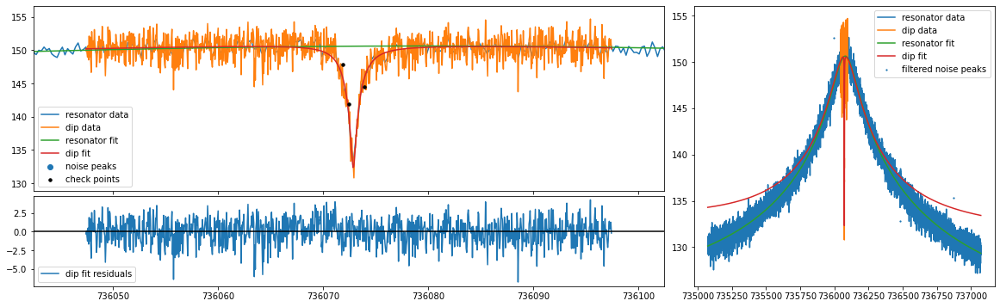

mean fit residuals = 6.2e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9664229111591367 0.11591054213331009
736075.8878406625 736075.8878406625 736075.8878406625 736075.8878406625 736075.8878406625
mcycle                               1
cycle                                7
position                    position_2
trap                                 2
acc_time                         20.05
time            20211128_233620.401925
nu_z               736072.864898262778
dnu_z                   0.017956048297
dip_width               2.966422911159
ddip_width              0.115910542133
fit_err                 2.888286127795
fit_success                       True
average_idx                          0
nu_res             736075.887840662501
dnu_res                 0.402592527405
Q                    4540.922480910626
dQ                     31.493503910321
th                     -0.000446334395
dth                      0.00001735577
off            17074458867781.87109375
doff           2959823728725.044921

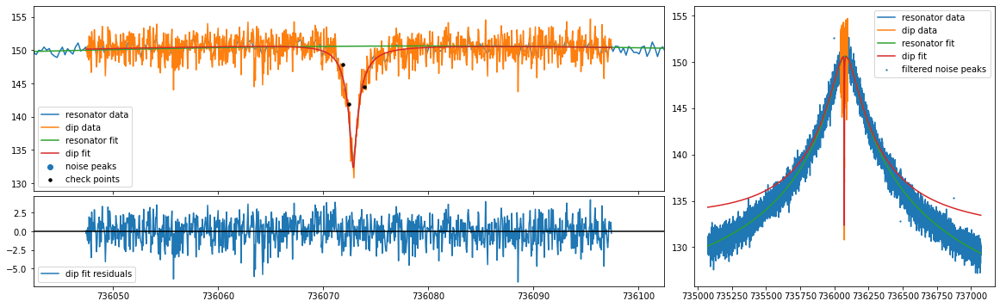

mean fit residuals = -1.3e-05 +/- 5.4e-02
[0.5, 3.0] 3.0 2.9767584766107946 0.11598937213752265
736077.8878406625 736077.8878406625 736077.8878406625 736077.8878406625 736077.8878406625
mcycle                                 1
cycle                                  7
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_233620.401925
nu_z                 736072.859873778187
dnu_z                     0.017972425316
dip_width                 2.976758476611
ddip_width                0.115989372138
fit_err                   2.881496833837
fit_success                         True
average_idx                            0
nu_res               736077.887840662501
dnu_res                   0.402592527405
Q                      4540.922480910626
dQ                       31.493503910321
th                       -0.000446334395
dth                        0.00001735577
off              17136587563555.894

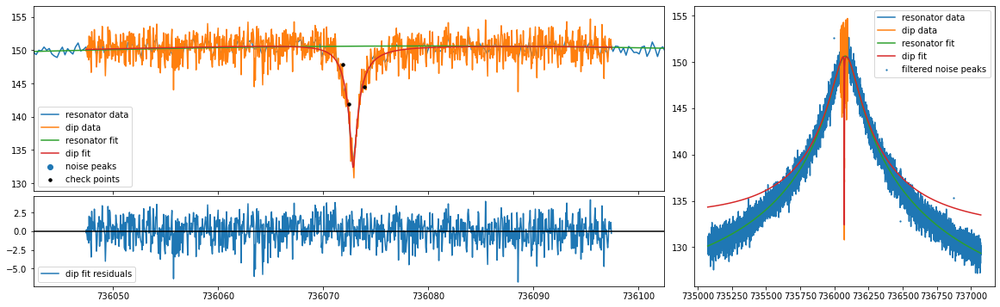

mean fit residuals = -1.3e-05 +/- 5.3e-02
[0.5, 3.0] 3.0 2.9906149754073184 0.11622886268762589
736079.8878406625 736079.8878406625 736079.8878406625 736079.8878406625 736079.8878406625
mcycle                                 1
cycle                                  7
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_233620.401925
nu_z                 736072.854924890678
dnu_z                     0.018020331221
dip_width                 2.990614975407
ddip_width                0.116228862688
fit_err                   2.877910377126
fit_success                         True
average_idx                            0
nu_res               736079.887840662501
dnu_res                   0.402592527405
Q                      4540.922480910626
dQ                       31.493503910321
th                       -0.000446334395
dth                        0.00001735577
off             17247393025058.9042

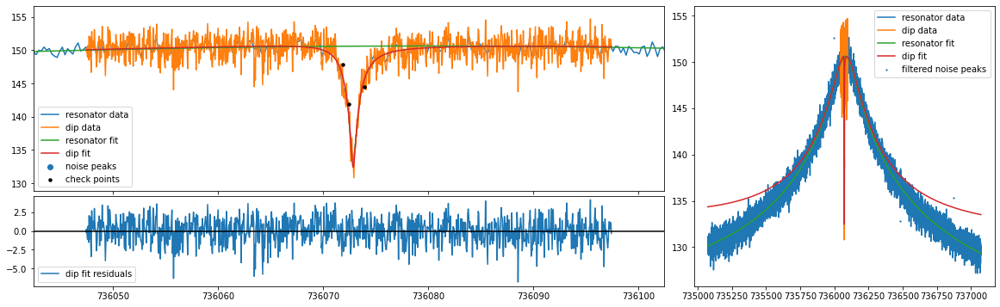

mean fit residuals = -1.2e-05 +/- 5.3e-02
[0.5, 3.0] 3.0 3.0064398031830923 0.11657049288729901
736081.8878406625 736081.8878406625 736081.8878406625 736081.8878406625 736081.8878406625
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_233620.401925
nu_z                736072.849938380532
dnu_z                    0.018084719123
dip_width                3.006439803183
ddip_width               0.116570492887
fit_err                  2.877465174257
fit_success                        True
average_idx                           0
nu_res              736081.887840662501
dnu_res                  0.402592527405
Q                     4540.922480910626
dQ                      31.493503910321
th                      -0.000446334395
dth                       0.00001735577
off              17378147337000.6953125
doff          

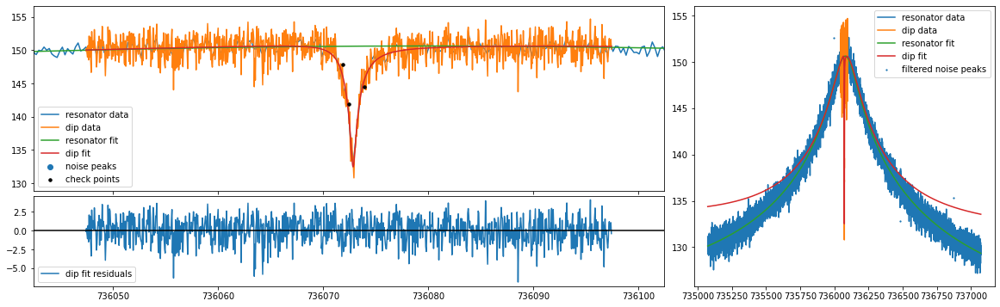

mean fit residuals = -1.2e-05 +/- 5.4e-02
[0.5, 3.0] 3.0 3.0241803144139503 0.11701120437446613
736083.8878406625 736083.8878406625 736083.8878406625 736083.8878406625 736083.8878406625
mcycle                                 1
cycle                                  7
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_233620.401925
nu_z                 736072.844913265086
dnu_z                     0.018164900182
dip_width                 3.024180314414
ddip_width                0.117011204374
fit_err                    2.88007986888
fit_success                         True
average_idx                            0
nu_res               736083.887840662501
dnu_res                   0.402592527405
Q                      4540.922480910626
dQ                       31.493503910321
th                       -0.000446334395
dth                        0.00001735577
off             17527995611004.4707

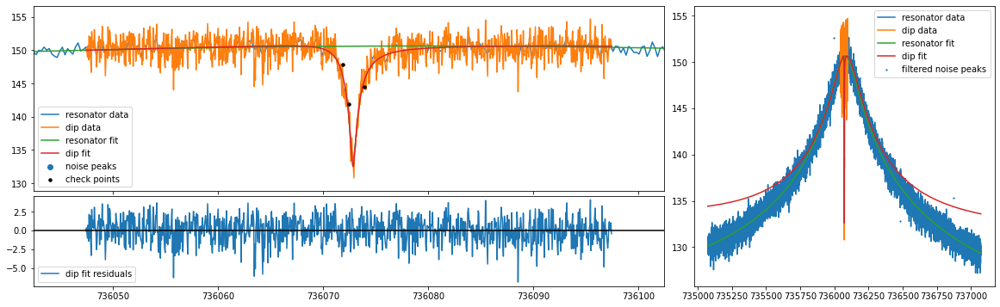

mean fit residuals = -1.3e-05 +/- 5.4e-02
[0.5, 3.0] 3.0 3.04377779231407 0.1175473844482385
736085.8878406625 736085.8878406625 736085.8878406625 736085.8878406625 736085.8878406625
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211128_233620.401925
nu_z                736072.839849807206
dnu_z                    0.018260078392
dip_width                3.043777792314
ddip_width               0.117547384448
fit_err                  2.885655648135
fit_success                        True
average_idx                           0
nu_res              736085.887840662501
dnu_res                  0.402592527405
Q                     4540.922480910626
dQ                      31.493503910321
th                      -0.000446334395
dth                       0.00001735577
off             17695985029714.26953125
doff           30

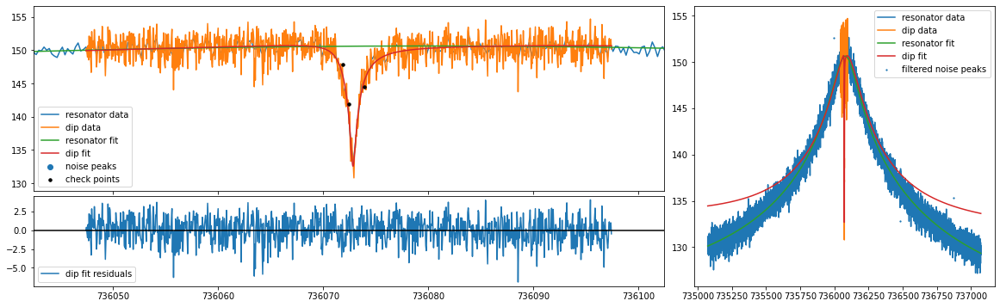

mean fit residuals = 6.7e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 3.0652035138277336 0.11815660810483675
736087.8878406625 736087.8878406625 736087.8878406625 736087.8878406625 736087.8878406625
mcycle                                 1
cycle                                  7
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_233620.401925
nu_z                 736072.835418044939
dnu_z                     0.018361091071
dip_width                 3.065203513828
ddip_width                0.118156608105
fit_err                   2.894077966238
fit_success                         True
average_idx                            0
nu_res               736087.887840662501
dnu_res                   0.402592527405
Q                      4540.922480910626
dQ                       31.493503910321
th                       -0.000446334395
dth                        0.00001735577
off               17857893145424.929

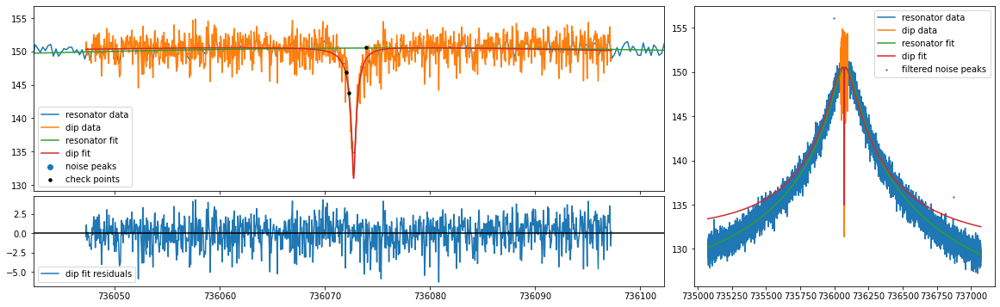

mean fit residuals = 2.5e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7688431368863442 0.08860278286851322
736069.0119724362 736069.0119724362 736069.0119724362 736069.0119724362 736069.0119724362
mcycle                                 1
cycle                                  8
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_000714.468061
nu_z                 736072.757581416401
dnu_z                     0.013128781555
dip_width                 1.768843136886
ddip_width                0.088602782869
fit_err                   3.206370624764
fit_success                         True
average_idx                            0
nu_res               736069.011972436216
dnu_res                   0.406806843412
Q                      4521.566768431378
dQ                       31.581940111497
th                       -0.000441413946
dth                       0.000

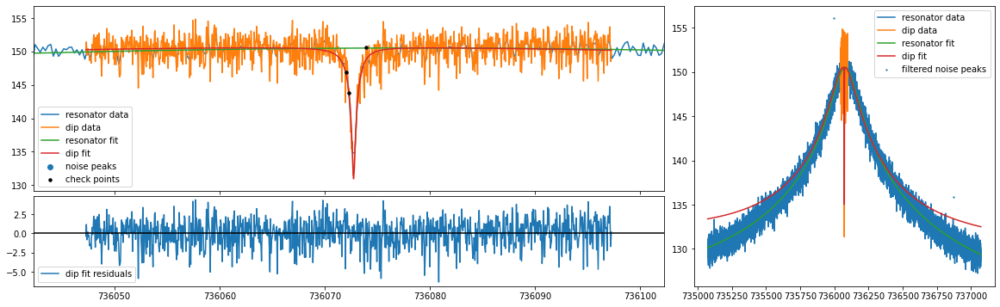

mean fit residuals = 5.0e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7700322350636781 0.08834130604555249
736071.0119724362 736071.0119724362 736071.0119724362 736071.0119724362 736071.0119724362
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_000714.468061
nu_z                736072.755150232115
dnu_z                    0.013086998225
dip_width                1.770032235064
ddip_width               0.088341306046
fit_err                  3.186910942138
fit_success                        True
average_idx                           0
nu_res              736071.011972436216
dnu_res                  0.406806843412
Q                     4521.566768431378
dQ                      31.581940111497
th                      -0.000441413946
dth                      0.000017457929
off      

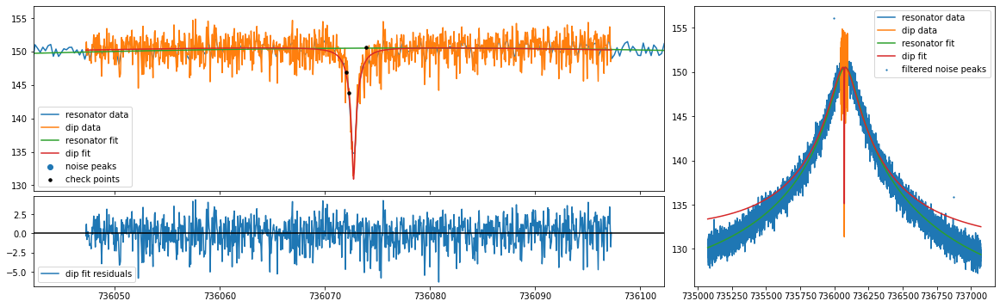

mean fit residuals = -1.9e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.772262841708001 0.08814687140373462
736073.0119724362 736073.0119724362 736073.0119724362 736073.0119724362 736073.0119724362
mcycle                                 1
cycle                                  8
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_000714.468061
nu_z                 736072.752721447148
dnu_z                     0.013055021673
dip_width                 1.772262841708
ddip_width                0.088146871404
fit_err                   3.170404325294
fit_success                         True
average_idx                            0
nu_res               736073.011972436216
dnu_res                   0.406806843412
Q                      4521.566768431378
dQ                       31.581940111497
th                       -0.000441413946
dth                       0.000

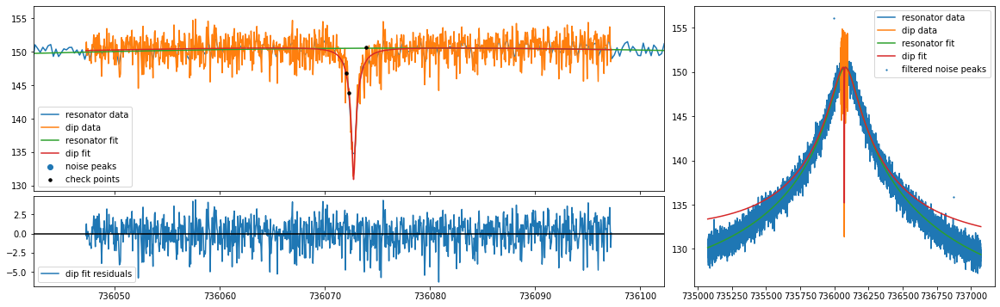

mean fit residuals = 5.5e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7756215341284027 0.08802561615099626
736075.0119724362 736075.0119724362 736075.0119724362 736075.0119724362 736075.0119724362
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_000714.468061
nu_z                736072.750291825505
dnu_z                    0.013034886293
dip_width                1.775621534128
ddip_width               0.088025616151
fit_err                  3.156889080867
fit_success                        True
average_idx                           0
nu_res              736075.011972436216
dnu_res                  0.406806843412
Q                     4521.566768431378
dQ                      31.581940111497
th                      -0.000441413946
dth                      0.000017457929
off      

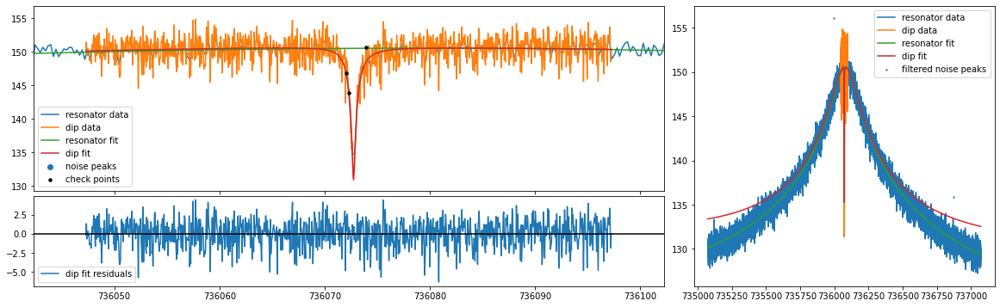

mean fit residuals = 1.2e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7799469714483829 0.08796714723370466
736077.0119724362 736077.0119724362 736077.0119724362 736077.0119724362 736077.0119724362
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_000714.468061
nu_z                736072.747867126018
dnu_z                     0.01302310643
dip_width                1.779946971448
ddip_width               0.087967147234
fit_err                  3.146377836037
fit_success                        True
average_idx                           0
nu_res              736077.011972436216
dnu_res                  0.406806843412
Q                     4521.566768431378
dQ                      31.581940111497
th                      -0.000441413946
dth                      0.000017457929
off      

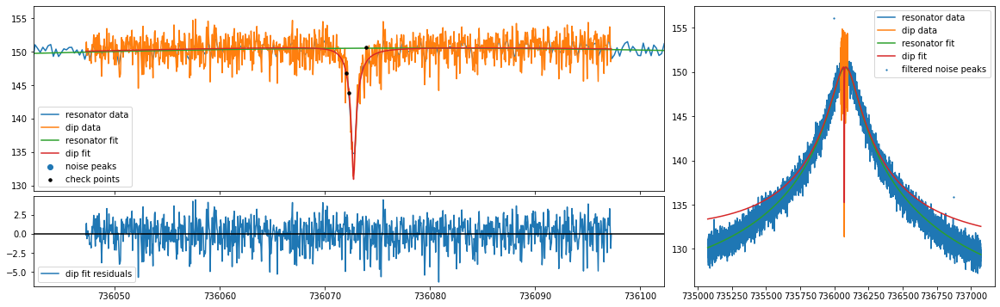

mean fit residuals = -5.3e-05 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7843469186991607 0.08792953721245444
736079.0119724362 736079.0119724362 736079.0119724362 736079.0119724362 736079.0119724362
mcycle                                 1
cycle                                  8
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_000714.468061
nu_z                 736072.745313941617
dnu_z                     0.013007863406
dip_width                 1.784346918699
ddip_width                0.087929537212
fit_err                   3.138856810838
fit_success                         True
average_idx                            0
nu_res               736079.011972436216
dnu_res                   0.406806843412
Q                      4521.566768431378
dQ                       31.581940111497
th                       -0.000441413946
dth                       0.00

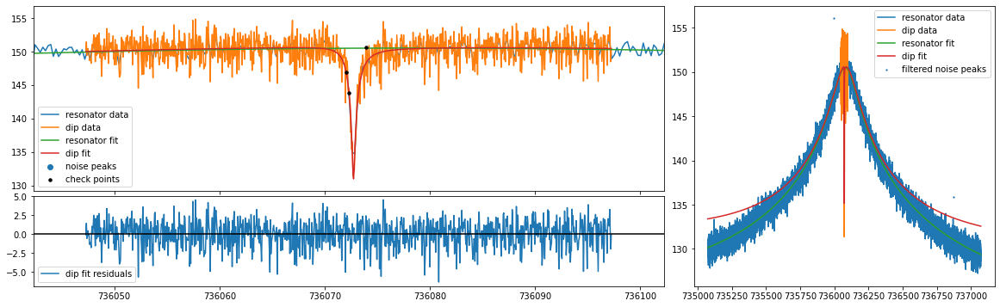

mean fit residuals = -4.9e-05 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7909800572184817 0.0880203579248396
736081.0119724362 736081.0119724362 736081.0119724362 736081.0119724362 736081.0119724362
mcycle                                 1
cycle                                  8
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_000714.468061
nu_z                  736072.74283332529
dnu_z                     0.013020813531
dip_width                 1.790980057218
ddip_width                0.088020357925
fit_err                   3.134289138059
fit_success                         True
average_idx                            0
nu_res               736081.011972436216
dnu_res                   0.406806843412
Q                      4521.566768431378
dQ                       31.581940111497
th                       -0.000441413946
dth                       0.000

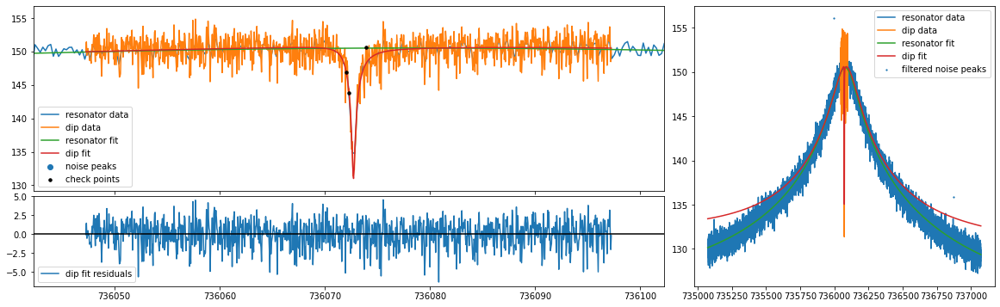

mean fit residuals = -4.7e-05 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7986876448211615 0.08818094642571664
736083.0119724362 736083.0119724362 736083.0119724362 736083.0119724362 736083.0119724362
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_000714.468061
nu_z                736072.740360677708
dnu_z                    0.013044684434
dip_width                1.798687644821
ddip_width               0.088180946426
fit_err                  3.132613438255
fit_success                        True
average_idx                           0
nu_res              736083.011972436216
dnu_res                  0.406806843412
Q                     4521.566768431378
dQ                      31.581940111497
th                      -0.000441413946
dth                      0.000017457929
off     

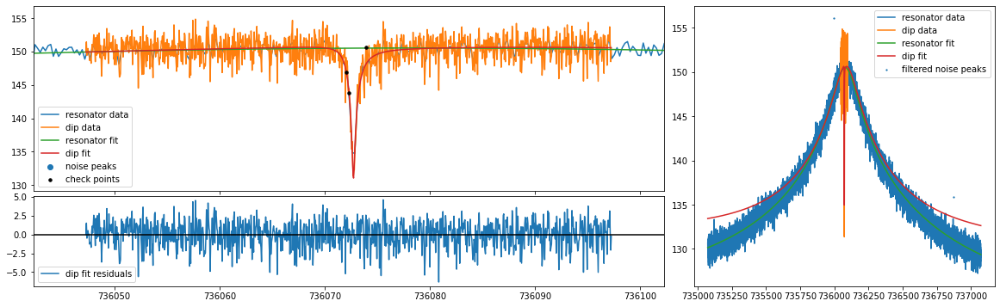

mean fit residuals = -4.6e-05 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8074462901791053 0.0884097173635074
736085.0119724362 736085.0119724362 736085.0119724362 736085.0119724362 736085.0119724362
mcycle                                 1
cycle                                  8
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_000714.468061
nu_z                  736072.73789388279
dnu_z                     0.013079089378
dip_width                 1.807446290179
ddip_width                0.088409717364
fit_err                   3.133746564033
fit_success                         True
average_idx                            0
nu_res               736085.011972436216
dnu_res                   0.406806843412
Q                      4521.566768431378
dQ                       31.581940111497
th                       -0.000441413946
dth                       0.000

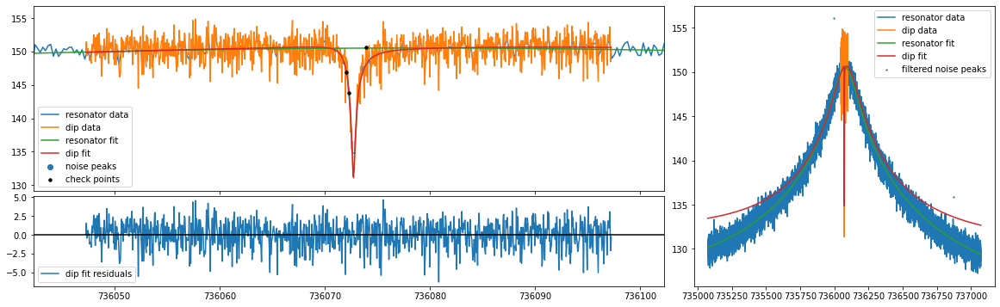

mean fit residuals = -4.6e-05 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8172303683592532 0.08870481385334776
736087.0119724362 736087.0119724362 736087.0119724362 736087.0119724362 736087.0119724362
mcycle                                 1
cycle                                  8
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_000714.468061
nu_z                 736072.735430683591
dnu_z                     0.013123616687
dip_width                 1.817230368359
ddip_width                0.088704813853
fit_err                   3.137585783643
fit_success                         True
average_idx                            0
nu_res               736087.011972436216
dnu_res                   0.406806843412
Q                      4521.566768431378
dQ                       31.581940111497
th                       -0.000441413946
dth                       0.00

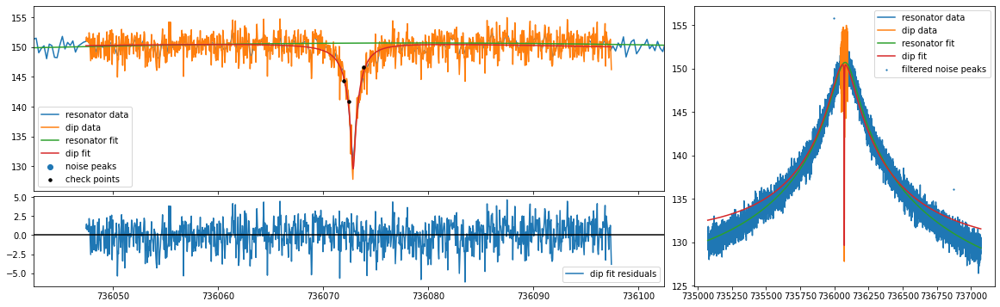

mean fit residuals = -4.0e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.866795549558438 0.11053861201250219
736068.9401984182 736068.9401984182 736068.9401984182 736068.9401984182 736068.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                  736072.854048317531
dnu_z                      0.014908689478
dip_width                  2.866795549558
ddip_width                 0.110538612013
fit_err                    3.107624247403
fit_success                          True
average_idx                             0
nu_res                736068.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off              

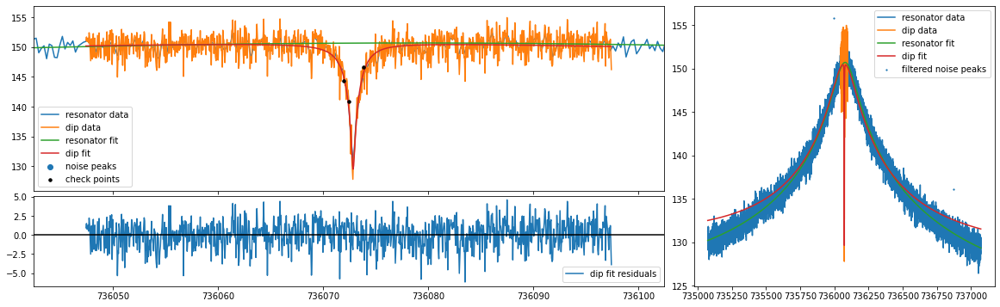

mean fit residuals = 5.3e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8647070056233668 0.10998274782623389
736070.9401984182 736070.9401984182 736070.9401984182 736070.9401984182 736070.9401984182
mcycle                                 1
cycle                                  8
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_235657.164323
nu_z                 736072.850861639134
dnu_z                     0.014812458504
dip_width                 2.864707005623
ddip_width                0.109982747826
fit_err                   3.082936966806
fit_success                         True
average_idx                            0
nu_res               736070.940198418219
dnu_res                    0.40898703718
Q                       4607.61988919664
dQ                        33.05542821481
th                       -0.000486938254
dth                       0.000017746937
off              8906884242520.52929

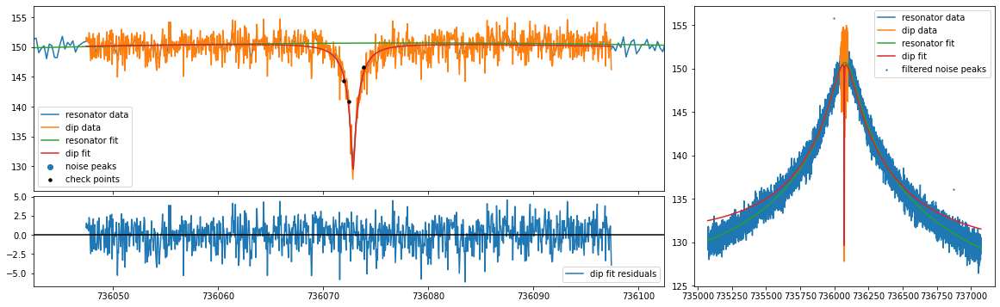

mean fit residuals = -6.7e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.864735742304391 0.10953729546319224
736072.9401984182 736072.9401984182 736072.9401984182 736072.9401984182 736072.9401984182
mcycle                                 1
cycle                                  8
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_235657.164323
nu_z                 736072.847741702921
dnu_z                     0.014733813529
dip_width                 2.864735742304
ddip_width                0.109537295463
fit_err                   3.061880000191
fit_success                         True
average_idx                            0
nu_res               736072.940198418219
dnu_res                    0.40898703718
Q                       4607.61988919664
dQ                        33.05542821481
th                       -0.000486938254
dth                       0.000017746937
off               8853333221166.6757

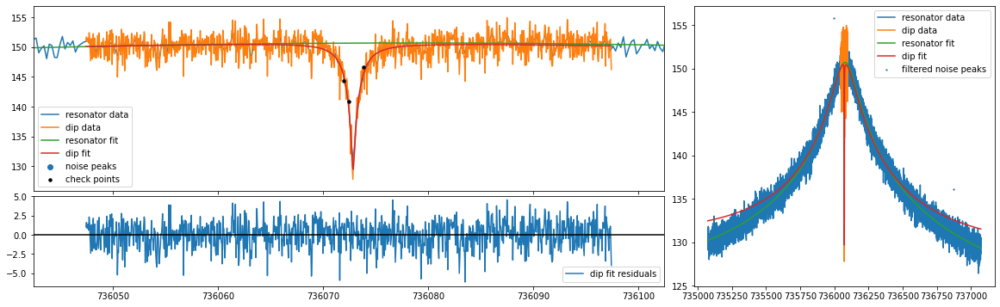

mean fit residuals = -4.6e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.866370332912222 0.10917865771579587
736074.9401984182 736074.9401984182 736074.9401984182 736074.9401984182 736074.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                  736072.844640651019
dnu_z                      0.014664923659
dip_width                  2.866370332912
ddip_width                 0.109178657716
fit_err                    3.044510005753
fit_success                          True
average_idx                             0
nu_res                736074.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off              

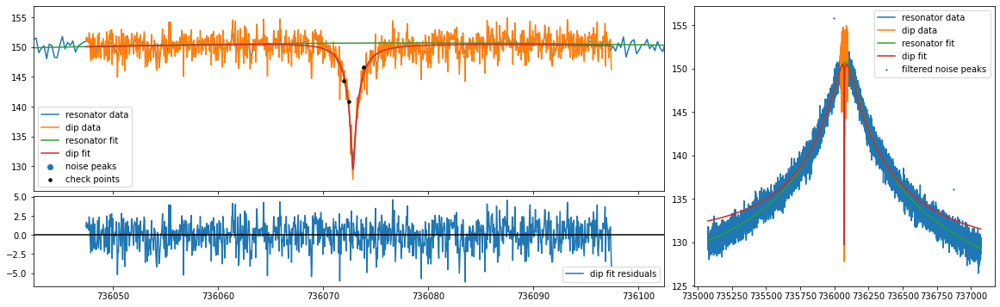

mean fit residuals = -5.0e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8705154381577156 0.10895211007572667
736076.9401984182 736076.9401984182 736076.9401984182 736076.9401984182 736076.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                  736072.841754173627
dnu_z                      0.014620334547
dip_width                  2.870515438158
ddip_width                 0.108952110076
fit_err                    3.030856894274
fit_success                          True
average_idx                             0
nu_res                736076.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off             

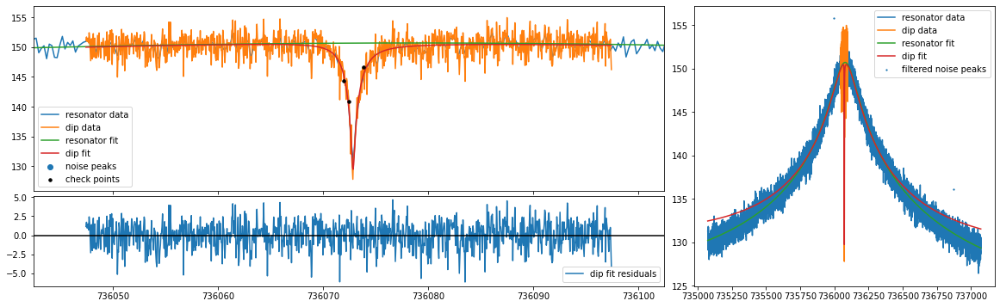

mean fit residuals = -4.4e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.87584801030256 0.1087926688515126
736078.9401984182 736078.9401984182 736078.9401984182 736078.9401984182 736078.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                  736072.838710697484
dnu_z                      0.014578785053
dip_width                  2.875848010303
ddip_width                 0.108792668852
fit_err                     3.02092367999
fit_success                          True
average_idx                             0
nu_res                736078.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off               8

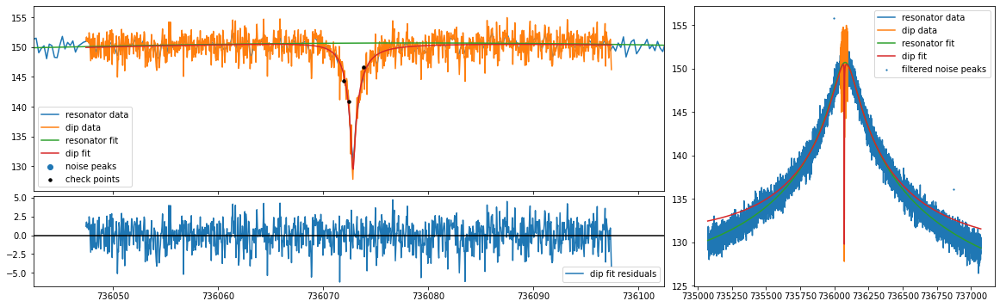

mean fit residuals = -4.0e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8830533445998987 0.10873480850168318
736080.9401984182 736080.9401984182 736080.9401984182 736080.9401984182 736080.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                  736072.835716231144
dnu_z                      0.014551614146
dip_width                    2.8830533446
ddip_width                 0.108734808502
fit_err                    3.014687562874
fit_success                          True
average_idx                             0
nu_res                736080.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off             

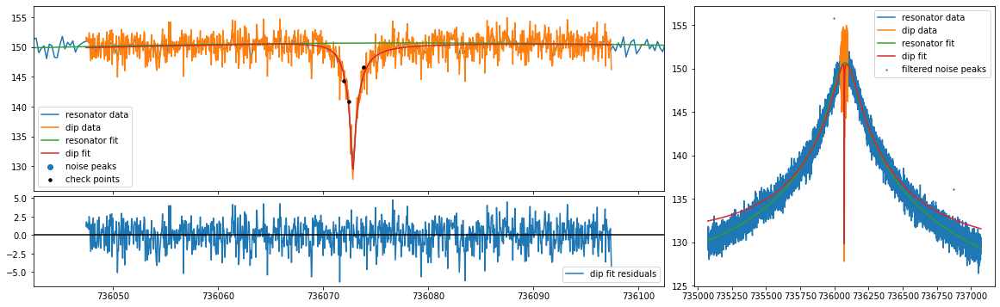

mean fit residuals = -3.8e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8920970414776948 0.10877702302236192
736082.9401984182 736082.9401984182 736082.9401984182 736082.9401984182 736082.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                   736072.83276775328
dnu_z                      0.014538516207
dip_width                  2.892097041478
ddip_width                 0.108777023022
fit_err                    3.012100329768
fit_success                          True
average_idx                             0
nu_res                736082.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off             

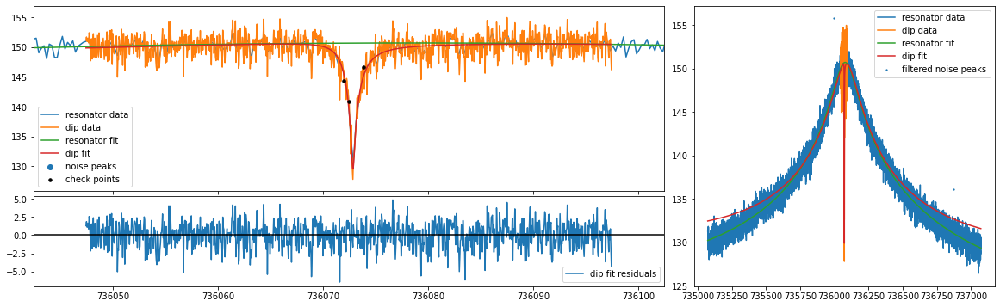

mean fit residuals = -3.6e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9029360937888127 0.1089171254231891
736084.9401984182 736084.9401984182 736084.9401984182 736084.9401984182 736084.9401984182
mcycle                                 1
cycle                                  8
position                      position_2
trap                                   2
acc_time                           20.05
time              20211128_235657.164323
nu_z                 736072.829862068989
dnu_z                     0.014539063731
dip_width                 2.902936093789
ddip_width                0.108917125423
fit_err                   3.013090300143
fit_success                         True
average_idx                            0
nu_res               736084.940198418219
dnu_res                    0.40898703718
Q                       4607.61988919664
dQ                        33.05542821481
th                       -0.000486938254
dth                       0.000017746937
off             8717045656268.290039

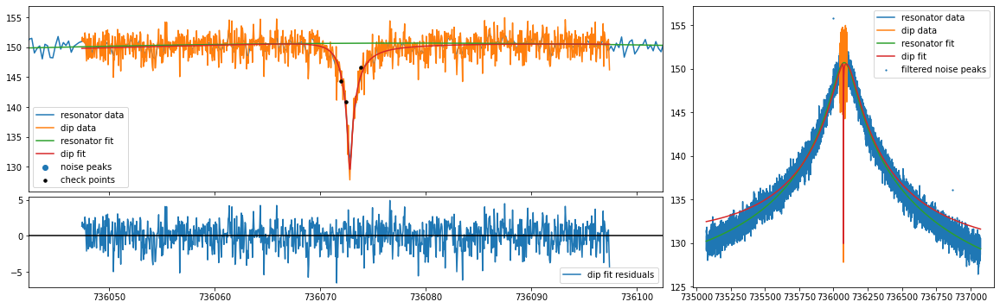

mean fit residuals = -3.6e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9155241283805924 0.10915261207587837
736086.9401984182 736086.9401984182 736086.9401984182 736086.9401984182 736086.9401984182
mcycle                                  1
cycle                                   8
position                       position_2
trap                                    2
acc_time                            20.05
time               20211128_235657.164323
nu_z                  736072.826995744836
dnu_z                       0.01455283669
dip_width                  2.915524128381
ddip_width                 0.109152612076
fit_err                    3.017564401466
fit_success                          True
average_idx                             0
nu_res                736086.940198418219
dnu_res                     0.40898703718
Q                        4607.61988919664
dQ                         33.05542821481
th                        -0.000486938254
dth                        0.000017746937
off             

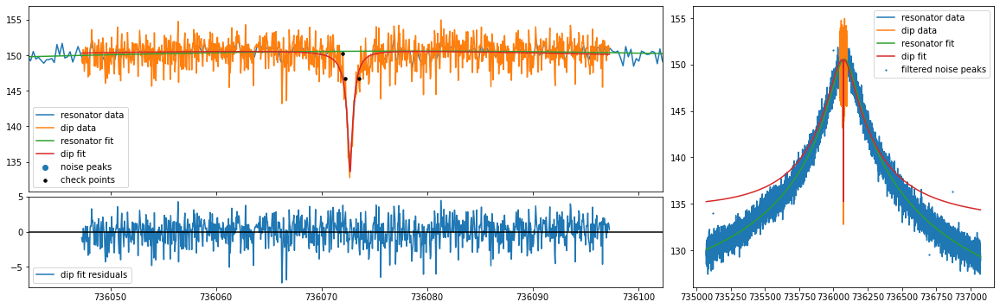

mean fit residuals = -5.1e-12 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.689308846865769 0.09111965934820372
736069.0821884229 736069.0821884229 736069.0821884229 736069.0821884229 736069.0821884229
mcycle                              1
cycle                               9
position                   position_1
trap                                2
acc_time                        20.05
time           20211129_002749.604236
nu_z              736072.707076869556
dnu_z                  0.015543441914
dip_width              1.689308846866
ddip_width             0.091119659348
fit_err                3.060006644181
fit_success                      True
average_idx                         0
nu_res            736069.082188422908
dnu_res                0.408580758228
Q                   4524.218014556859
dQ                    31.705957140578
th                    -0.000434048541
dth                    0.000017582774
off               22977275776362.1875
doff     

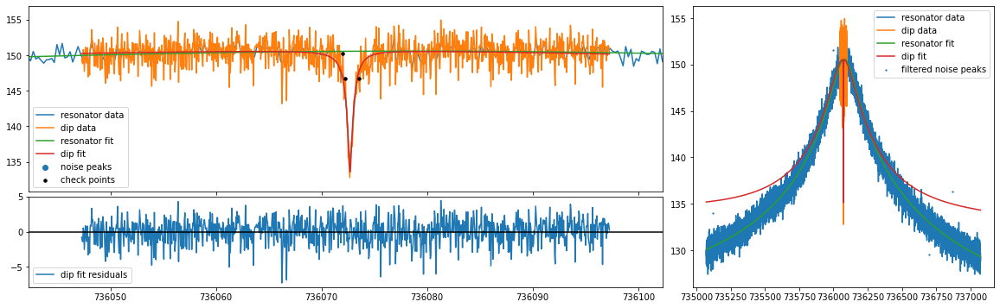

mean fit residuals = -1.2e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.6875717460519946 0.09066906303604154
736071.0821884229 736071.0821884229 736071.0821884229 736071.0821884229 736071.0821884229
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_002749.604236
nu_z                736072.703605656512
dnu_z                    0.015435993634
dip_width                1.687571746052
ddip_width               0.090669063036
fit_err                  3.042761851661
fit_success                        True
average_idx                           0
nu_res              736071.082188422908
dnu_res                  0.408580758228
Q                     4524.218014556859
dQ                      31.705957140578
th                      -0.000434048541
dth                      0.000017582774
off     

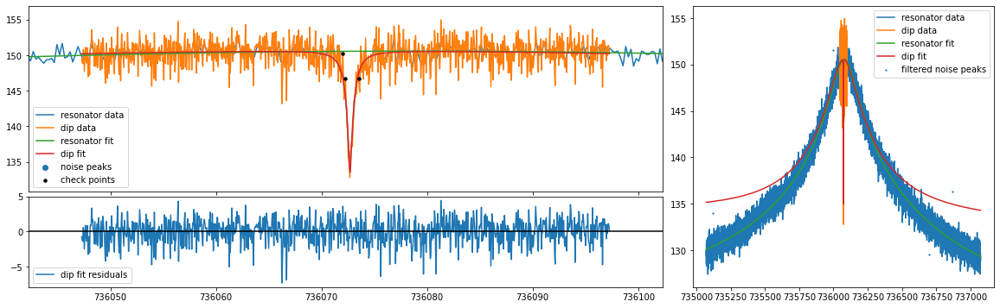

mean fit residuals = 3.5e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.6869466095620116 0.09029973793887336
736073.0821884229 736073.0821884229 736073.0821884229 736073.0821884229 736073.0821884229
mcycle                               1
cycle                                9
position                    position_1
trap                                 2
acc_time                         20.05
time            20211129_002749.604236
nu_z               736072.700208907598
dnu_z                   0.015343654036
dip_width               1.686946609562
ddip_width              0.090299737939
fit_err                 3.028341438644
fit_success                       True
average_idx                          0
nu_res             736073.082188422908
dnu_res                 0.408580758228
Q                    4524.218014556859
dQ                     31.705957140578
th                     -0.000434048541
dth                     0.000017582774
off             225265021469

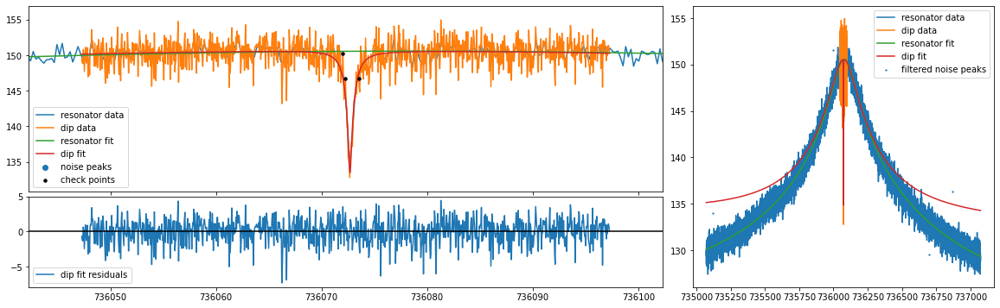

mean fit residuals = 3.7e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.6874409669774988 0.09001228945041494
736075.0821884229 736075.0821884229 736075.0821884229 736075.0821884229 736075.0821884229
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_002749.604236
nu_z                736072.696886506164
dnu_z                    0.015266525317
dip_width                1.687440966977
ddip_width                0.09001228945
fit_err                  3.016781517269
fit_success                        True
average_idx                           0
nu_res              736075.082188422908
dnu_res                  0.408580758228
Q                     4524.218014556859
dQ                      31.705957140578
th                      -0.000434048541
dth                      0.000017582774
off      

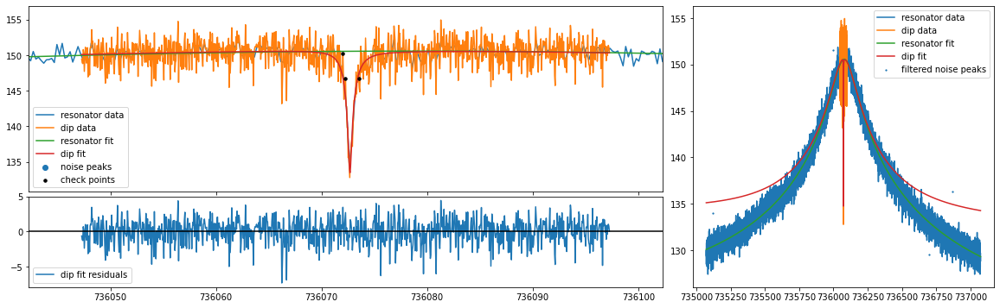

mean fit residuals = 4.8e-10 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.689051841863266 0.08980648112203214
736077.0821884229 736077.0821884229 736077.0821884229 736077.0821884229 736077.0821884229
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_002749.604236
nu_z                  736072.6936366671
dnu_z                    0.015204504437
dip_width                1.689051841863
ddip_width               0.089806481122
fit_err                  3.008091897333
fit_success                        True
average_idx                           0
nu_res              736077.082188422908
dnu_res                  0.408580758228
Q                     4524.218014556859
dQ                      31.705957140578
th                      -0.000434048541
dth                      0.000017582774
off       

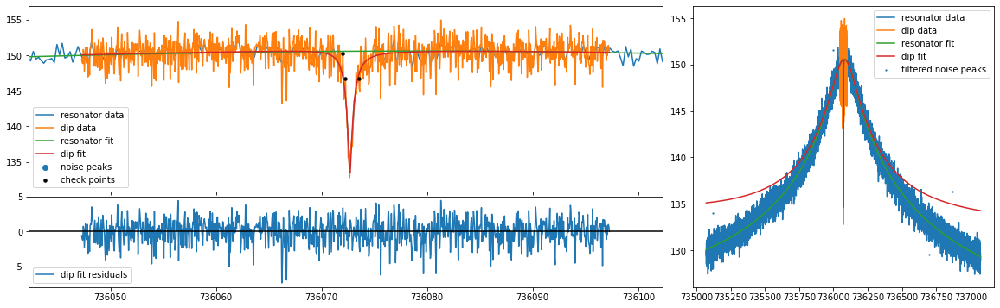

mean fit residuals = -4.0e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.691771352096447 0.08968152289230934
736079.0821884229 736079.0821884229 736079.0821884229 736079.0821884229 736079.0821884229
mcycle                              1
cycle                               9
position                   position_1
trap                                2
acc_time                        20.05
time           20211129_002749.604236
nu_z              736072.690457374905
dnu_z                  0.015157361656
dip_width              1.691771352096
ddip_width             0.089681522892
fit_err                3.002256311381
fit_success                      True
average_idx                         0
nu_res            736079.082188422908
dnu_res                0.408580758228
Q                   4524.218014556859
dQ                    31.705957140578
th                    -0.000434048541
dth                    0.000017582774
off            22106552270136.9296875
doff     

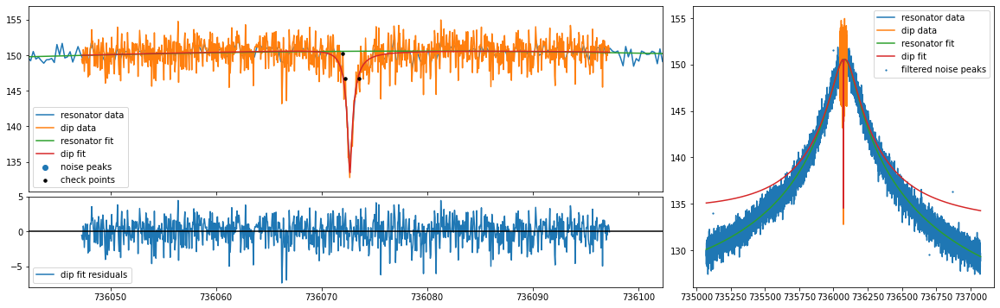

mean fit residuals = 1.8e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.6955783355536342 0.08963565461051498
736081.0821884229 736081.0821884229 736081.0821884229 736081.0821884229 736081.0821884229
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_002749.604236
nu_z                736072.687345015467
dnu_z                    0.015124613329
dip_width                1.695578335554
ddip_width               0.089635654611
fit_err                  2.999233199337
fit_success                        True
average_idx                           0
nu_res              736081.082188422908
dnu_res                  0.408580758228
Q                     4524.218014556859
dQ                      31.705957140578
th                      -0.000434048541
dth                      0.000017582774
off      

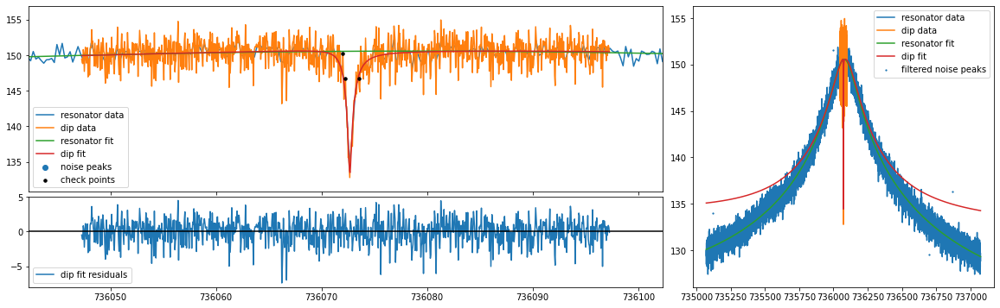

mean fit residuals = 7.5e-09 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7004529153785963 0.08966706682087484
736083.0821884229 736083.0821884229 736083.0821884229 736083.0821884229 736083.0821884229
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_002749.604236
nu_z                736072.684297055705
dnu_z                    0.015105808071
dip_width                1.700452915379
ddip_width               0.089667066821
fit_err                  2.998957087218
fit_success                        True
average_idx                           0
nu_res              736083.082188422908
dnu_res                  0.408580758228
Q                     4524.218014556859
dQ                      31.705957140578
th                      -0.000434048541
dth                      0.000017582774
off      

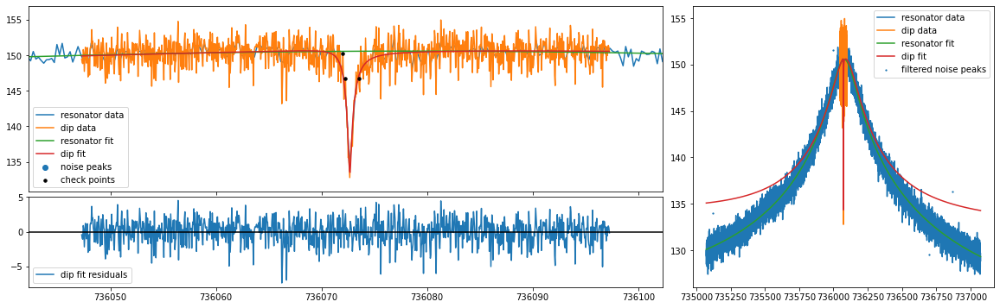

mean fit residuals = -6.1e-09 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.706366309402337 0.08977318344681094
736085.0821884229 736085.0821884229 736085.0821884229 736085.0821884229 736085.0821884229
mcycle                              1
cycle                               9
position                   position_1
trap                                2
acc_time                        20.05
time           20211129_002749.604236
nu_z              736072.681310663349
dnu_z                  0.015100311667
dip_width              1.706366309402
ddip_width             0.089773183447
fit_err                3.001340421764
fit_success                      True
average_idx                         0
nu_res            736085.082188422908
dnu_res                0.408580758228
Q                   4524.218014556859
dQ                    31.705957140578
th                    -0.000434048541
dth                    0.000017582774
off            21972611957765.4921875
doff     

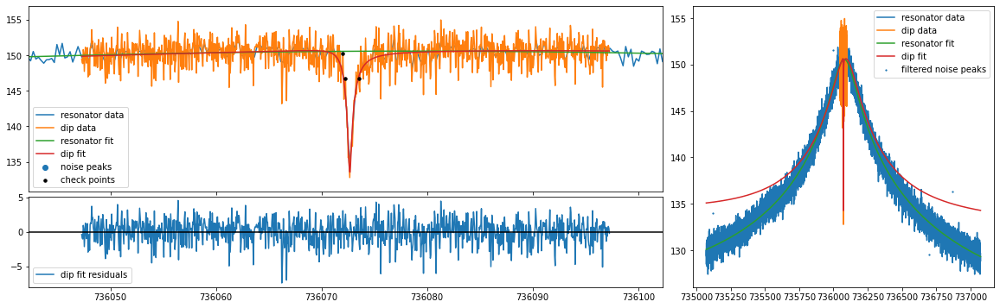

mean fit residuals = 2.4e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.71327901257823 0.0899506186748545
736087.0821884229 736087.0821884229 736087.0821884229 736087.0821884229 736087.0821884229
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_002749.604236
nu_z                736072.678381361533
dnu_z                    0.015107283067
dip_width                1.713279012578
ddip_width               0.089950618675
fit_err                  3.006275836912
fit_success                        True
average_idx                           0
nu_res              736087.082188422908
dnu_res                  0.408580758228
Q                     4524.218014556859
dQ                      31.705957140578
th                      -0.000434048541
dth                      0.000017582774
off         

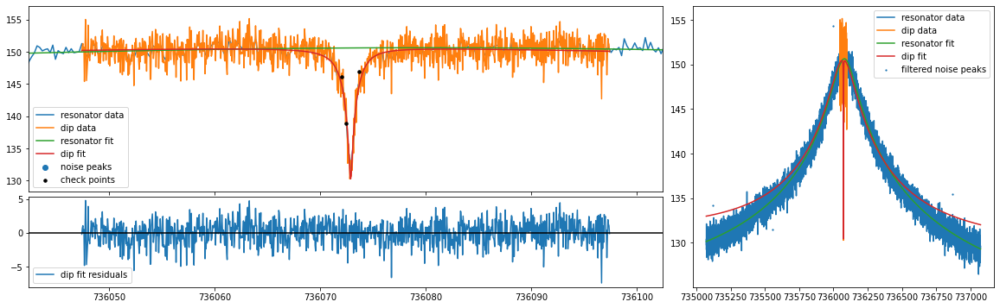

mean fit residuals = 1.3e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.755034335486223 0.1102862909066626
736070.2438526681 736070.2438526681 736070.2438526681 736070.2438526681 736070.2438526681
mcycle                               1
cycle                                9
position                    position_2
trap                                 2
acc_time                         20.05
time            20211129_001731.053295
nu_z               736072.897837729543
dnu_z                   0.015522145813
dip_width               2.755034335486
ddip_width              0.110286290907
fit_err                 3.130551150979
fit_success                       True
average_idx                          0
nu_res             736070.243852668093
dnu_res                 0.409967390969
Q                    4569.639998917956
dQ                     32.514659801332
th                     -0.000476926043
dth                     0.000017736525
off            10694269753917.42578125
doff            2213997098706.4804687

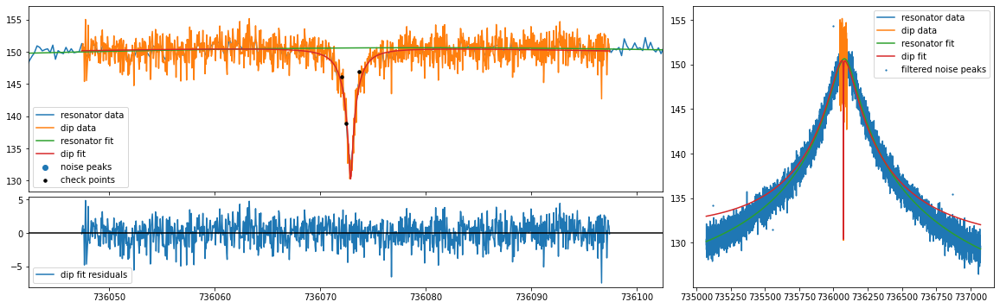

mean fit residuals = 3.1e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.757433366378282 0.11005412982256935
736072.2438526681 736072.2438526681 736072.2438526681 736072.2438526681 736072.2438526681
mcycle                                 1
cycle                                  9
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_001731.053295
nu_z                 736072.894204914686
dnu_z                     0.015490292041
dip_width                 2.757433366378
ddip_width                0.110054129823
fit_err                   3.114923485607
fit_success                         True
average_idx                            0
nu_res               736072.243852668093
dnu_res                   0.409967390969
Q                      4569.639998917956
dQ                       32.514659801332
th                       -0.000476926043
dth                       0.000017736525
off                10691153047674.359

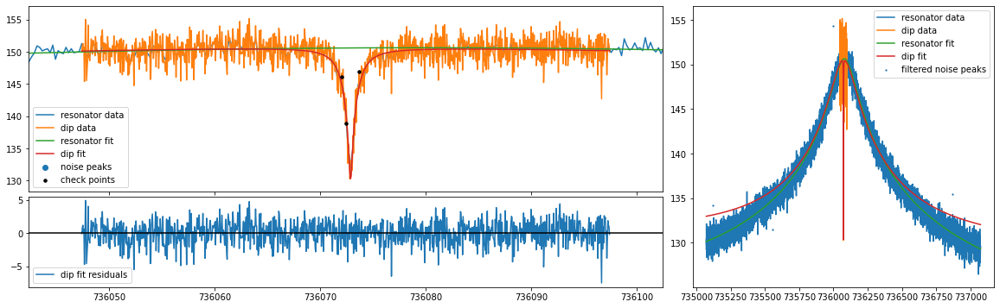

mean fit residuals = 1.7e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7615373216575736 0.109913811230759
736074.2438526681 736074.2438526681 736074.2438526681 736074.2438526681 736074.2438526681
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_001731.053295
nu_z                736072.890574677149
dnu_z                    0.015471185311
dip_width                2.761537321658
ddip_width               0.109913811231
fit_err                  3.102757042496
fit_success                        True
average_idx                           0
nu_res              736074.243852668093
dnu_res                  0.409967390969
Q                     4569.639998917956
dQ                      32.514659801332
th                      -0.000476926043
dth                      0.000017736525
off            10698137848284.986328125
doff           22

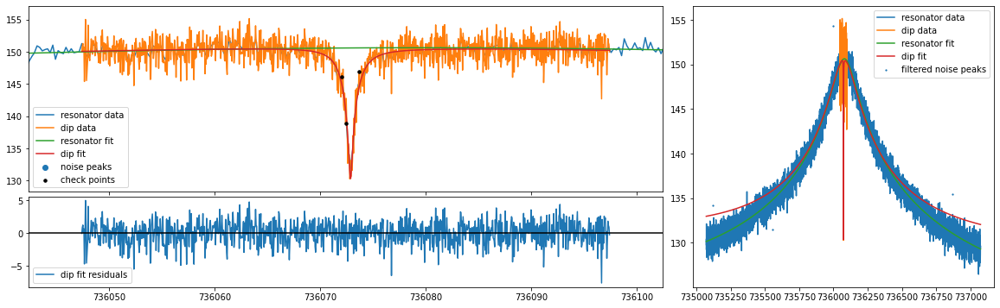

mean fit residuals = -1.1e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7670183423600525 0.10985054531458499
736076.2438526681 736076.2438526681 736076.2438526681 736076.2438526681 736076.2438526681
mcycle                                 1
cycle                                  9
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_001731.053295
nu_z                 736072.886939461809
dnu_z                     0.015460196088
dip_width                  2.76701834236
ddip_width                0.109850545315
fit_err                   3.094071002682
fit_success                         True
average_idx                            0
nu_res               736076.243852668093
dnu_res                   0.409967390969
Q                      4569.639998917956
dQ                       32.514659801332
th                       -0.000476926043
dth                       0.000017736525
off               10707068209573.63

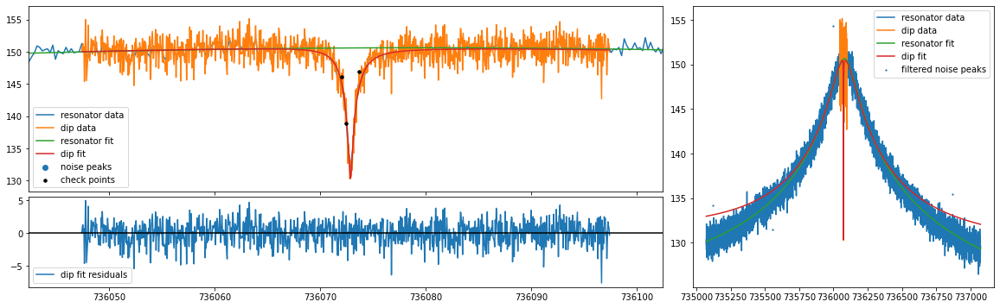

mean fit residuals = -1.7e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.774476694244407 0.10989283304288847
736078.2438526681 736078.2438526681 736078.2438526681 736078.2438526681 736078.2438526681
mcycle                                 1
cycle                                  9
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_001731.053295
nu_z                 736072.883275708184
dnu_z                      0.01546606762
dip_width                 2.774476694244
ddip_width                0.109892833043
fit_err                    3.08885871784
fit_success                         True
average_idx                            0
nu_res               736078.243852668093
dnu_res                   0.409967390969
Q                      4569.639998917956
dQ                       32.514659801332
th                       -0.000476926043
dth                       0.000017736525
off              10733063005521.1757

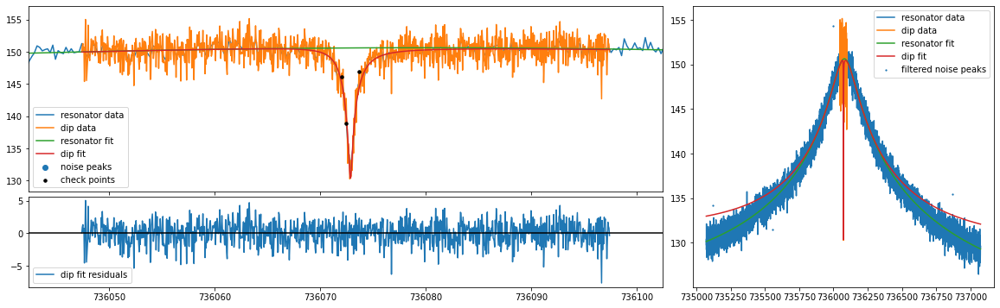

mean fit residuals = -2.5e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7836644695370047 0.11002916283334148
736080.2438526681 736080.2438526681 736080.2438526681 736080.2438526681 736080.2438526681
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_001731.053295
nu_z                736072.879610086093
dnu_z                    0.015485358757
dip_width                2.783664469537
ddip_width               0.110029162833
fit_err                  3.087089121716
fit_success                        True
average_idx                           0
nu_res              736080.243852668093
dnu_res                  0.409967390969
Q                     4569.639998917956
dQ                      32.514659801332
th                      -0.000476926043
dth                      0.000017736525
off            10770338460315.314453125
doff          

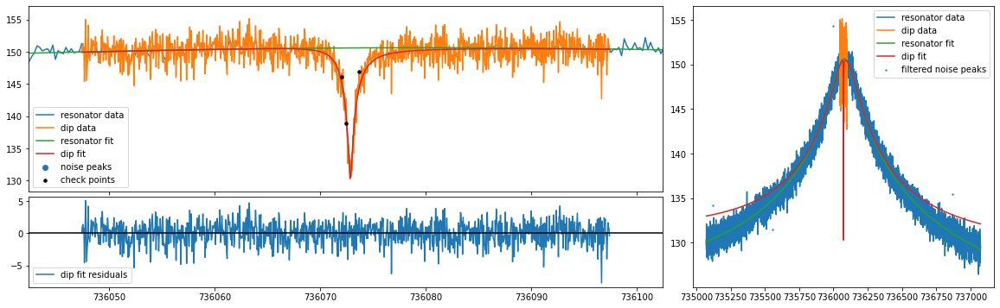

mean fit residuals = -3.7e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7945668969797293 0.1102586584554542
736082.2438526681 736082.2438526681 736082.2438526681 736082.2438526681 736082.2438526681
mcycle                                 1
cycle                                  9
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_001731.053295
nu_z                 736072.875940258382
dnu_z                     0.015517992984
dip_width                  2.79456689698
ddip_width                0.110258658455
fit_err                   3.088706967282
fit_success                         True
average_idx                            0
nu_res               736082.243852668093
dnu_res                   0.409967390969
Q                      4569.639998917956
dQ                       32.514659801332
th                       -0.000476926043
dth                       0.000017736525
off              10819060918757.6132

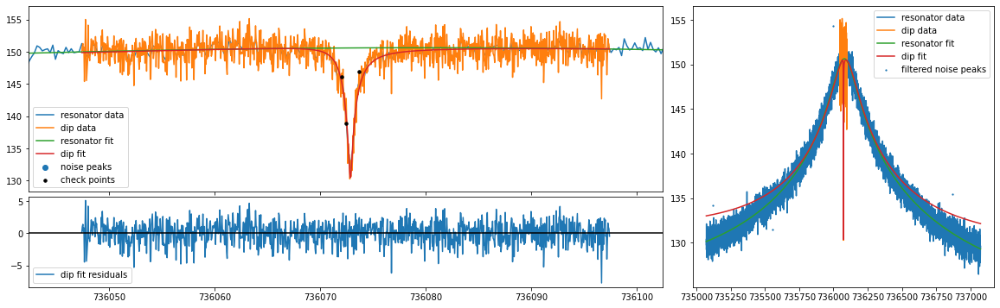

mean fit residuals = -5.5e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8071640883526636 0.11057998940071274
736084.2438526681 736084.2438526681 736084.2438526681 736084.2438526681 736084.2438526681
mcycle                                 1
cycle                                  9
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_001731.053295
nu_z                 736072.872263866942
dnu_z                     0.015563812128
dip_width                 2.807164088353
ddip_width                0.110579989401
fit_err                   3.093634749979
fit_success                         True
average_idx                            0
nu_res               736084.243852668093
dnu_res                   0.409967390969
Q                      4569.639998917956
dQ                       32.514659801332
th                       -0.000476926043
dth                       0.000017736525
off             10879378792471.1308

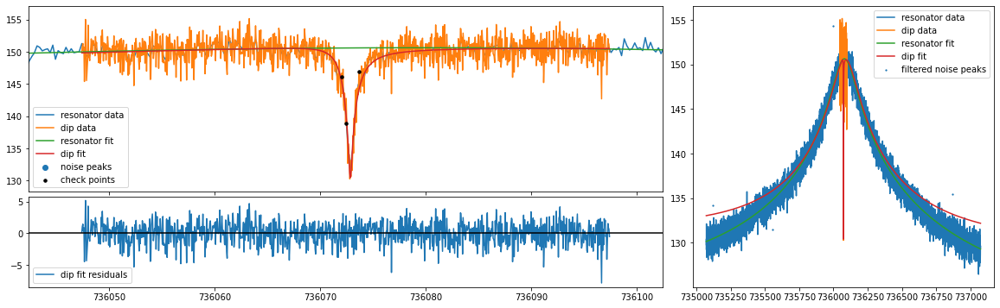

mean fit residuals = -7.8e-06 +/- 5.6e-02
[0.5, 3.0] 3.0 2.821429810419088 0.11099133980349106
736086.2438526681 736086.2438526681 736086.2438526681 736086.2438526681 736086.2438526681
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_001731.053295
nu_z                736072.868578595924
dnu_z                    0.015622590827
dip_width                2.821429810419
ddip_width               0.110991339803
fit_err                  3.101774745454
fit_success                        True
average_idx                           0
nu_res              736086.243852668093
dnu_res                  0.409967390969
Q                     4569.639998917956
dQ                      32.514659801332
th                      -0.000476926043
dth                      0.000017736525
off            10951449112208.568359375
doff           

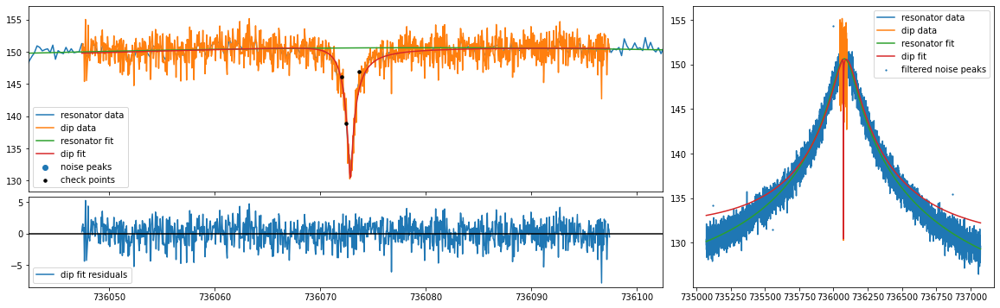

mean fit residuals = -1.1e-05 +/- 5.6e-02
[0.5, 3.0] 3.0 2.837332748087244 0.1114904557375759
736088.2438526681 736088.2438526681 736088.2438526681 736088.2438526681 736088.2438526681
mcycle                                 1
cycle                                  9
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_001731.053295
nu_z                 736072.864882216789
dnu_z                     0.015694029515
dip_width                 2.837332748087
ddip_width                0.111490455738
fit_err                   3.113011396648
fit_success                         True
average_idx                            0
nu_res               736088.243852668093
dnu_res                   0.409967390969
Q                      4569.639998917956
dQ                       32.514659801332
th                       -0.000476926043
dth                       0.000017736525
off              11035401842090.08203

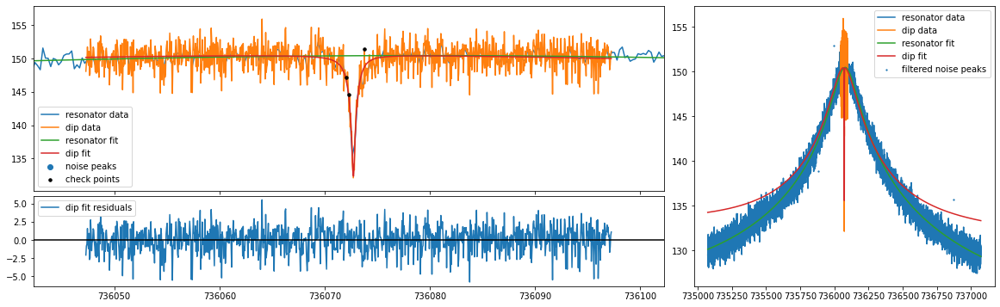

mean fit residuals = 2.0e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5550891389632102 0.08608639887390769
736069.55718339 736069.55718339 736069.55718339 736069.55718339 736069.55718339
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_004827.122115
nu_z                736072.729429818457
dnu_z                     0.01377688985
dip_width                1.555089138963
ddip_width               0.086086398874
fit_err                   3.23103246001
fit_success                        True
average_idx                           0
nu_res              736069.557183390018
dnu_res                  0.416354708159
Q                     4447.978368375184
dQ                      31.135898836088
th                       -0.00045547901
dth                      0.000017748459
off             165

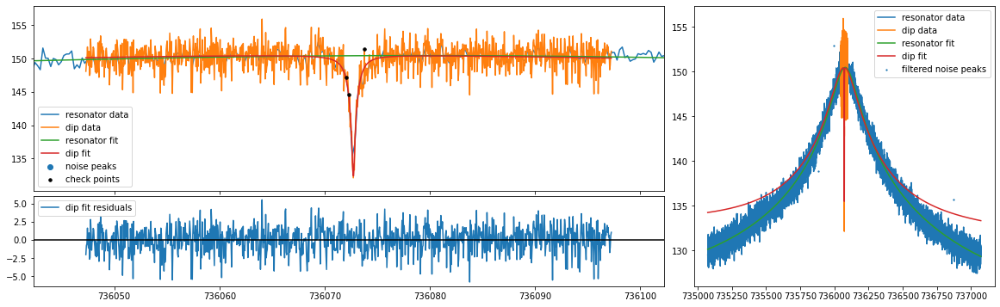

mean fit residuals = -8.6e-09 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5552742718026058 0.08588849310662176
736071.55718339 736071.55718339 736071.55718339 736071.55718339 736071.55718339
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_004827.122115
nu_z                736072.727169257705
dnu_z                    0.013741617431
dip_width                1.555274271803
ddip_width               0.085888493107
fit_err                  3.218604079643
fit_success                        True
average_idx                           0
nu_res              736071.557183390018
dnu_res                  0.416354708159
Q                     4447.978368375184
dQ                      31.135898836088
th                       -0.00045547901
dth                      0.000017748459
off             16

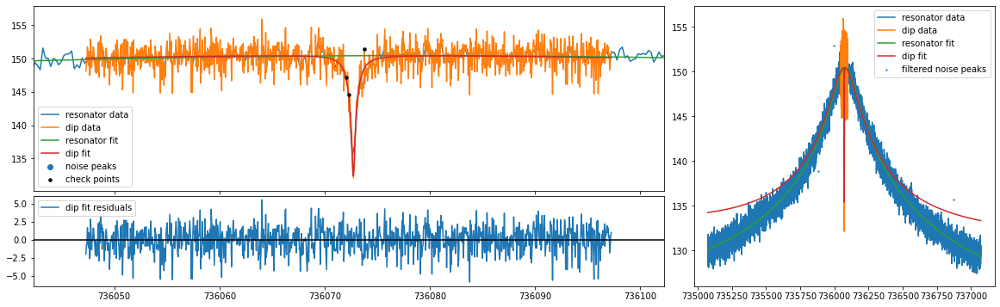

mean fit residuals = 3.7e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5564367302942068 0.08576116037996123
736073.55718339 736073.55718339 736073.55718339 736073.55718339 736073.55718339
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_004827.122115
nu_z                736072.724912151694
dnu_z                    0.013718118946
dip_width                1.556436730294
ddip_width                0.08576116038
fit_err                  3.209017715476
fit_success                        True
average_idx                           0
nu_res              736073.557183390018
dnu_res                  0.416354708159
Q                     4447.978368375184
dQ                      31.135898836088
th                       -0.00045547901
dth                      0.000017748459
off            1648

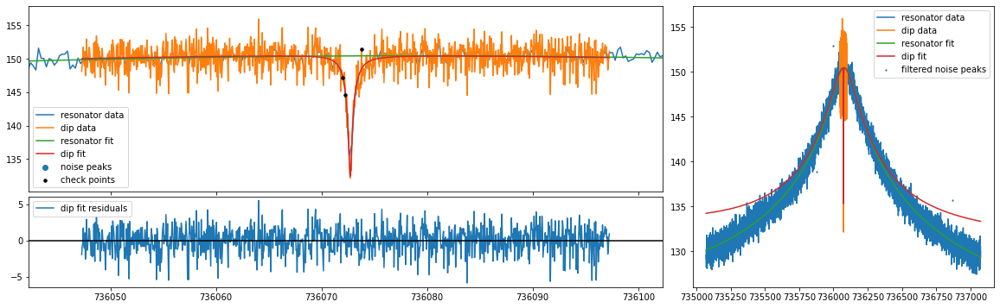

mean fit residuals = 2.7e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5585618940512063 0.08570390902176478
736075.55718339 736075.55718339 736075.55718339 736075.55718339 736075.55718339
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_004827.122115
nu_z                736072.722657237435
dnu_z                    0.013706165118
dip_width                1.558561894051
ddip_width               0.085703909022
fit_err                  3.202290276213
fit_success                        True
average_idx                           0
nu_res              736075.557183390018
dnu_res                  0.416354708159
Q                     4447.978368375184
dQ                      31.135898836088
th                       -0.00045547901
dth                      0.000017748459
off               1

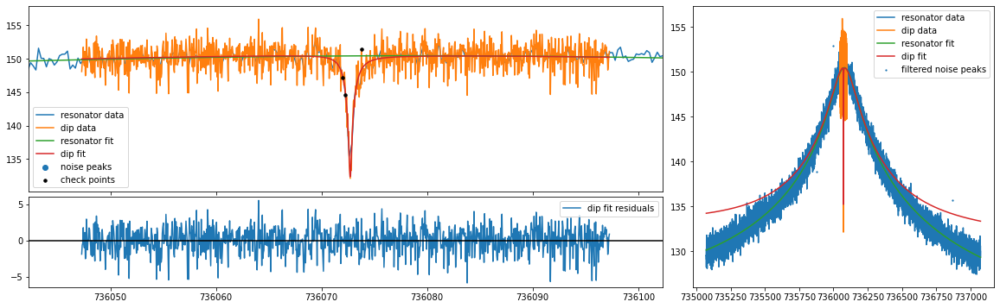

mean fit residuals = -1.5e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5616596595160475 0.08571727857652817
736077.55718339 736077.55718339 736077.55718339 736077.55718339 736077.55718339
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_004827.122115
nu_z                736072.720406132867
dnu_z                    0.013705907259
dip_width                1.561659659516
ddip_width               0.085717278577
fit_err                  3.198413814071
fit_success                        True
average_idx                           0
nu_res              736077.557183390018
dnu_res                  0.416354708159
Q                     4447.978368375184
dQ                      31.135898836088
th                       -0.00045547901
dth                      0.000017748459
off             16

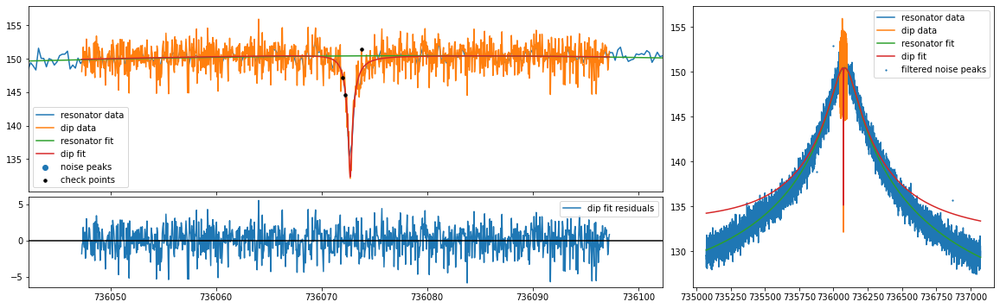

mean fit residuals = -6.4e-10 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.56572081516277 0.0858005062168809
736079.55718339 736079.55718339 736079.55718339 736079.55718339 736079.55718339
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_004827.122115
nu_z                736072.718158920063
dnu_z                      0.0137171597
dip_width                1.565720815163
ddip_width               0.085800506217
fit_err                  3.197355954393
fit_success                        True
average_idx                           0
nu_res              736079.557183390018
dnu_res                  0.416354708159
Q                     4447.978368375184
dQ                      31.135898836088
th                       -0.00045547901
dth                      0.000017748459
off              1655

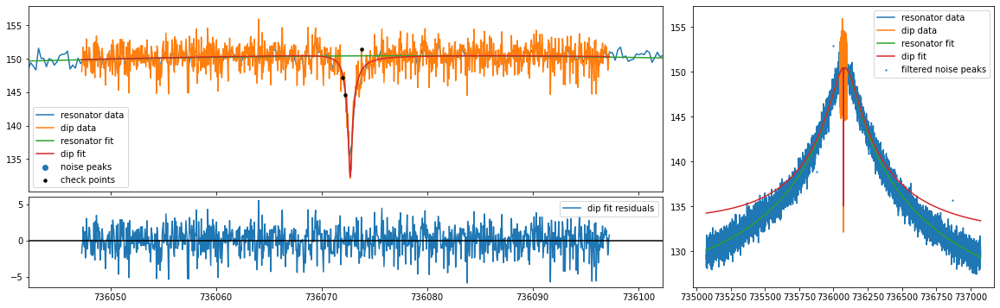

mean fit residuals = 8.1e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5707336281461386 0.0859524233006668
736081.55718339 736081.55718339 736081.55718339 736081.55718339 736081.55718339
mcycle                              1
cycle                              10
position                   position_1
trap                                2
acc_time                        20.05
time           20211129_004827.122115
nu_z              736072.715915571083
dnu_z                  0.013739727709
dip_width              1.570733628146
ddip_width             0.085952423301
fit_err                3.199060848539
fit_success                      True
average_idx                         0
nu_res            736081.557183390018
dnu_res                0.416354708159
Q                   4447.978368375184
dQ                    31.135898836088
th                     -0.00045547901
dth                    0.000017748459
off             16622108719036.546875
doff              41

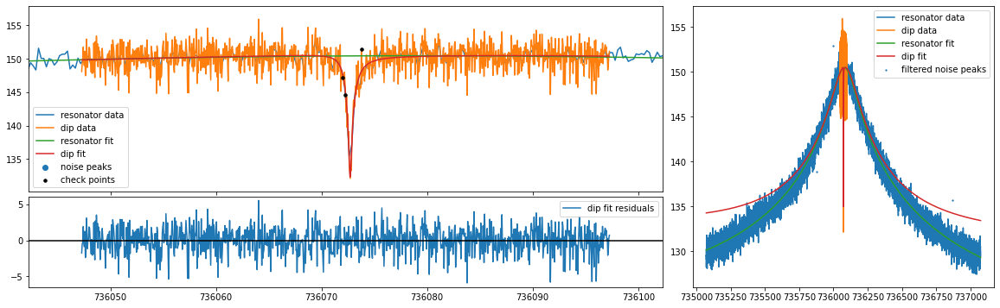

mean fit residuals = 2.5e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5766764317565418 0.08617109219973086
736083.55718339 736083.55718339 736083.55718339 736083.55718339 736083.55718339
mcycle                                 1
cycle                                 10
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_004827.122115
nu_z                 736072.713676784886
dnu_z                     0.013773258902
dip_width                 1.576676431757
ddip_width                  0.0861710922
fit_err                   3.203450605319
fit_success                         True
average_idx                            0
nu_res               736083.557183390018
dnu_res                   0.416354708159
Q                      4447.978368375184
dQ                       31.135898836088
th                        -0.00045547901
dth                       0.000017748459


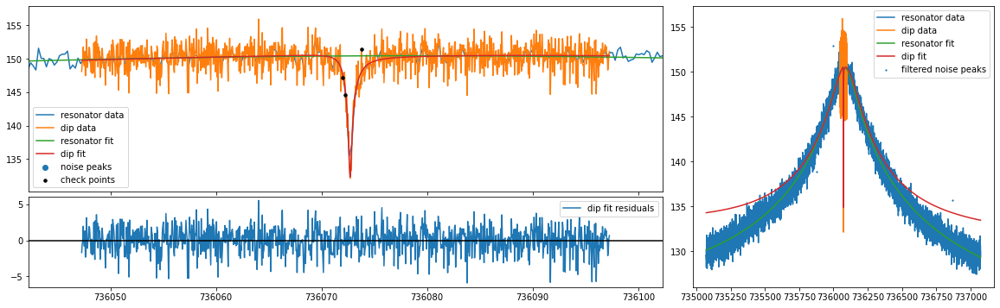

mean fit residuals = -6.0e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.58353199219139 0.08645457120047206
736085.55718339 736085.55718339 736085.55718339 736085.55718339 736085.55718339
mcycle                                 1
cycle                                 10
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_004827.122115
nu_z                 736072.711441689986
dnu_z                     0.013817403886
dip_width                 1.583531992191
ddip_width                  0.0864545712
fit_err                   3.210427153372
fit_success                         True
average_idx                            0
nu_res               736085.557183390018
dnu_res                   0.416354708159
Q                      4447.978368375184
dQ                       31.135898836088
th                        -0.00045547901
dth                       0.000017748459
o

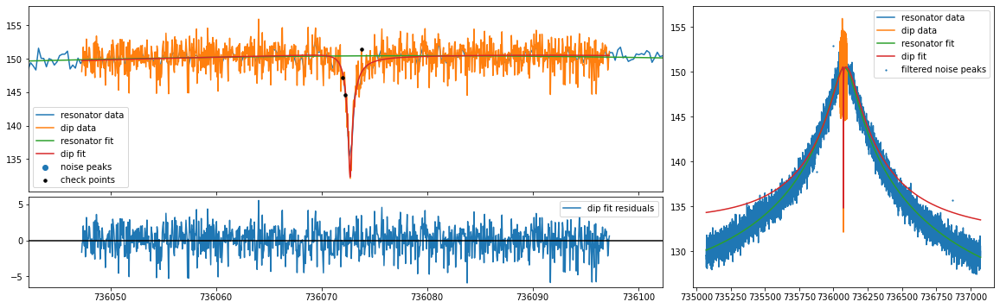

mean fit residuals = -3.1e-08 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.5912719857515898 0.08680027978583886
736087.55718339 736087.55718339 736087.55718339 736087.55718339 736087.55718339
mcycle                                 1
cycle                                 10
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_004827.122115
nu_z                 736072.709210550762
dnu_z                     0.013871695019
dip_width                 1.591271985752
ddip_width                0.086800279786
fit_err                   3.219874461158
fit_success                         True
average_idx                            0
nu_res               736087.557183390018
dnu_res                   0.416354708159
Q                      4447.978368375184
dQ                       31.135898836088
th                        -0.00045547901
dth                       0.000017748459

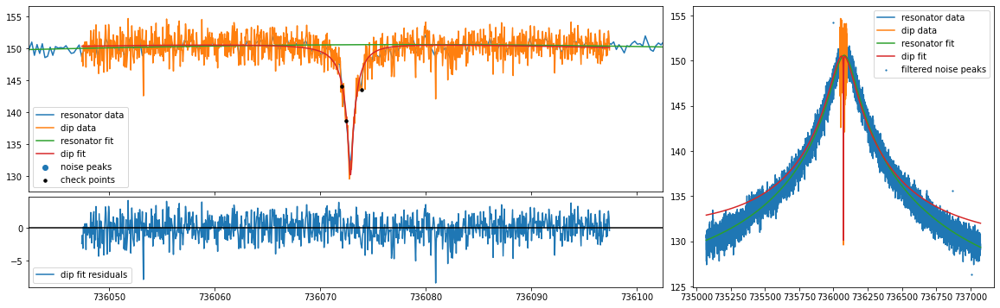

mean fit residuals = -3.7e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.812500088244943 0.10910290133490337
736068.7104325178 736068.7104325178 736068.7104325178 736068.7104325178 736068.7104325178
mcycle                                  1
cycle                                  10
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_003808.470386
nu_z                  736072.874373032711
dnu_z                       0.01513395583
dip_width                  2.812500088245
ddip_width                 0.109102901335
fit_err                    3.024921799079
fit_success                          True
average_idx                             0
nu_res                736068.710432517808
dnu_res                    0.410501936997
Q                       4544.130980183121
dQ                        32.172011235182
th                        -0.000439516181
dth                        0.000017697193
off              

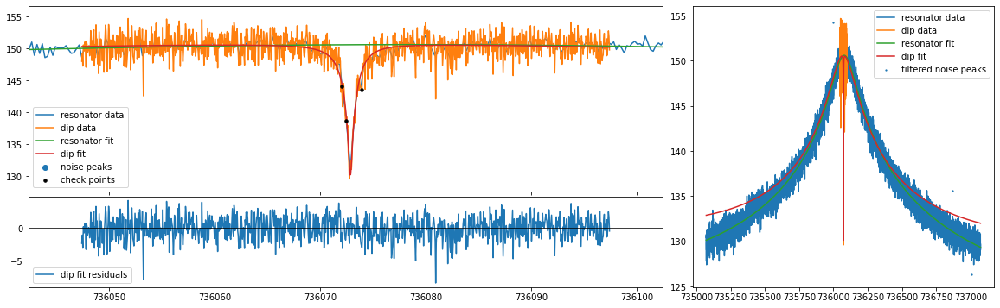

mean fit residuals = -2.5e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8135954475717284 0.10872228447398209
736070.7104325178 736070.7104325178 736070.7104325178 736070.7104325178 736070.7104325178
mcycle                                 1
cycle                                 10
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_003808.470386
nu_z                 736072.870856868569
dnu_z                     0.015074985246
dip_width                 2.813595447572
ddip_width                0.108722284474
fit_err                    3.00391887099
fit_success                         True
average_idx                            0
nu_res               736070.710432517808
dnu_res                   0.410501936997
Q                      4544.130980183121
dQ                       32.172011235182
th                       -0.000439516181
dth                       0.000017697193
off             10274089880868.9238

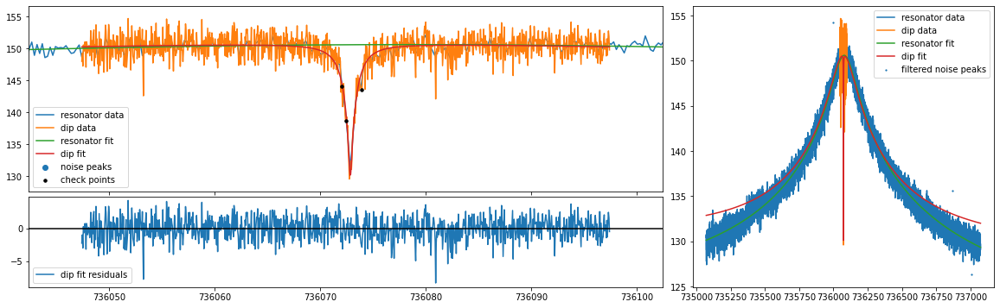

mean fit residuals = 6.1e-10 +/- 5.4e-02
[0.5, 3.0] 3.0 2.816333516326385 0.10842984053685824
736072.7104325178 736072.7104325178 736072.7104325178 736072.7104325178 736072.7104325178
mcycle                                  1
cycle                                  10
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_003808.470386
nu_z                  736072.867355452268
dnu_z                      0.015027769232
dip_width                  2.816333516326
ddip_width                 0.108429840537
fit_err                     2.98632223837
fit_success                          True
average_idx                             0
nu_res                736072.710432517808
dnu_res                    0.410501936997
Q                       4544.130980183121
dQ                        32.172011235182
th                        -0.000439516181
dth                        0.000017697193
off               

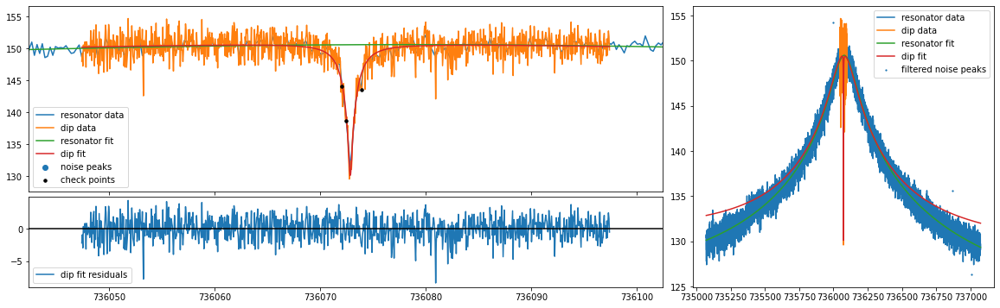

mean fit residuals = -2.1e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.820719375801942 0.10822665973694752
736074.7104325178 736074.7104325178 736074.7104325178 736074.7104325178 736074.7104325178
mcycle                                 1
cycle                                 10
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_003808.470386
nu_z                  736072.86387158127
dnu_z                     0.014992491705
dip_width                 2.820719375802
ddip_width                0.108226659737
fit_err                   2.972167711611
fit_success                         True
average_idx                            0
nu_res               736074.710432517808
dnu_res                   0.410501936997
Q                      4544.130980183121
dQ                       32.172011235182
th                       -0.000439516181
dth                       0.000017697193
off              10237959393205.3085

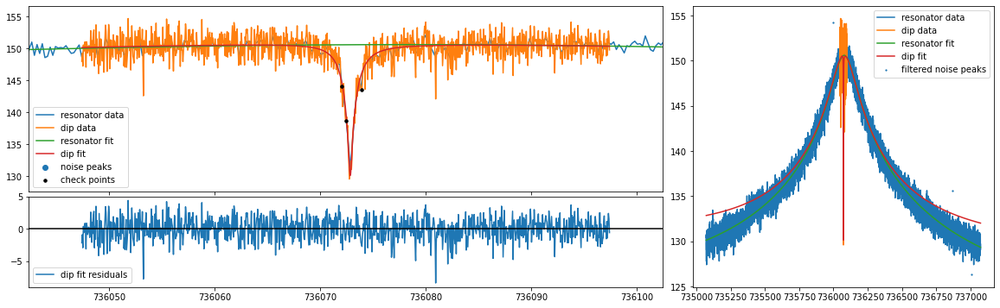

mean fit residuals = 1.2e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.8267455520353524 0.10811301475269729
736076.7104325178 736076.7104325178 736076.7104325178 736076.7104325178 736076.7104325178
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_003808.470386
nu_z                 736072.86040696851
dnu_z                    0.014969171354
dip_width                2.826745552035
ddip_width               0.108113014753
fit_err                  2.961466723155
fit_success                        True
average_idx                           0
nu_res              736076.710432517808
dnu_res                  0.410501936997
Q                     4544.130980183121
dQ                      32.172011235182
th                      -0.000439516181
dth                      0.000017697193
off            10232616222456.224609375
doff           

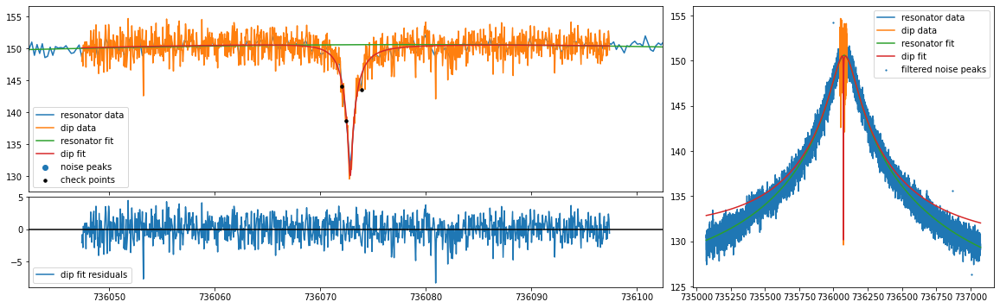

mean fit residuals = 1.8e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.834400616215105 0.10808875927026126
736078.7104325178 736078.7104325178 736078.7104325178 736078.7104325178 736078.7104325178
mcycle                                 1
cycle                                 10
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_003808.470386
nu_z                 736072.856964209466
dnu_z                     0.014957784082
dip_width                 2.834400616215
ddip_width                 0.10808875927
fit_err                    2.95420651876
fit_success                         True
average_idx                            0
nu_res               736078.710432517808
dnu_res                   0.410501936997
Q                      4544.130980183121
dQ                       32.172011235182
th                       -0.000439516181
dth                       0.000017697193
off             10235701360025.314453

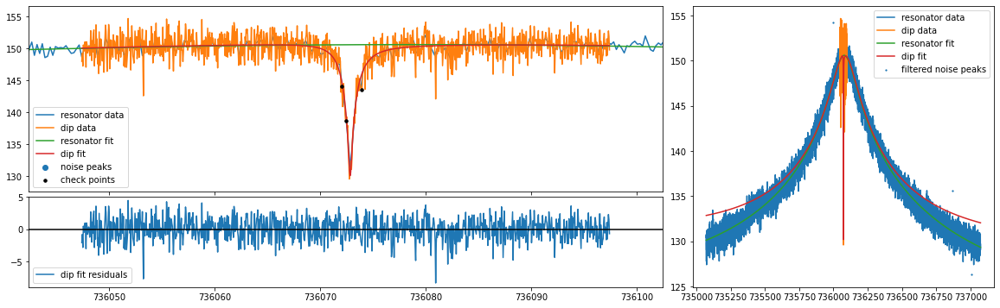

mean fit residuals = 4.0e-08 +/- 5.4e-02
[0.5, 3.0] 3.0 2.843662078867819 0.1081529450305992
736080.7104325178 736080.7104325178 736080.7104325178 736080.7104325178 736080.7104325178
mcycle                                  1
cycle                                  10
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_003808.470386
nu_z                  736072.853545266553
dnu_z                      0.014958159515
dip_width                  2.843662078868
ddip_width                 0.108152945031
fit_err                    2.950350841867
fit_success                          True
average_idx                             0
nu_res                736080.710432517808
dnu_res                    0.410501936997
Q                       4544.130980183121
dQ                        32.172011235182
th                        -0.000439516181
dth                        0.000017697193
off               1

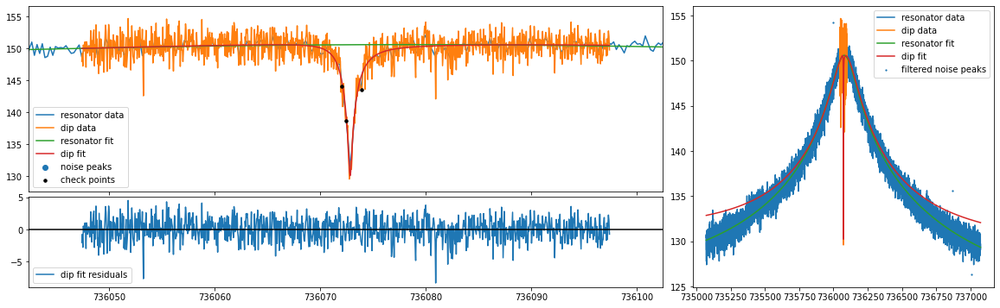

mean fit residuals = -4.6e-09 +/- 5.4e-02
[0.5, 3.0] 3.0 2.854501010727396 0.10830417373158428
736082.7104325178 736082.7104325178 736082.7104325178 736082.7104325178 736082.7104325178
mcycle                                  1
cycle                                  10
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_003808.470386
nu_z                  736072.850151953637
dnu_z                      0.014970073768
dip_width                  2.854501010727
ddip_width                 0.108304173732
fit_err                    2.949841122556
fit_success                          True
average_idx                             0
nu_res                736082.710432517808
dnu_res                    0.410501936997
Q                       4544.130980183121
dQ                        32.172011235182
th                        -0.000439516181
dth                        0.000017697193
off              

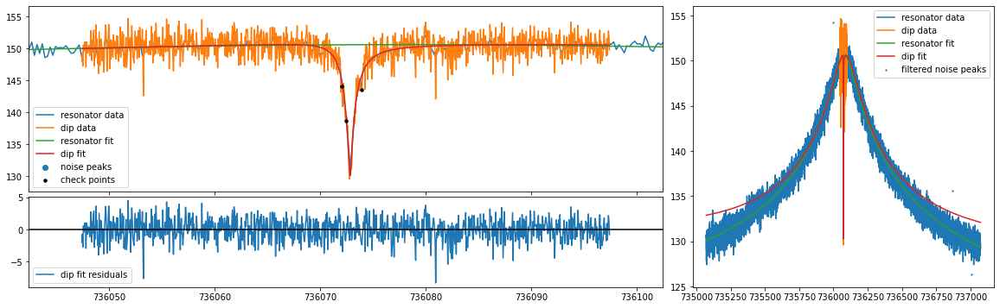

mean fit residuals = -8.0e-05 +/- 5.4e-02
[0.5, 3.0] 3.0 2.8669589622711364 0.10855829364655749
736084.7104325178 736084.7104325178 736084.7104325178 736084.7104325178 736084.7104325178
mcycle                                  1
cycle                                  10
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_003808.470386
nu_z                   736072.84672082006
dnu_z                      0.015001093439
dip_width                  2.866958962271
ddip_width                 0.108558293647
fit_err                     2.95259802217
fit_success                          True
average_idx                             0
nu_res                736084.710432517808
dnu_res                    0.410501936997
Q                       4544.130980183121
dQ                        32.172011235182
th                        -0.000439516181
dth                        0.000017697193
off             

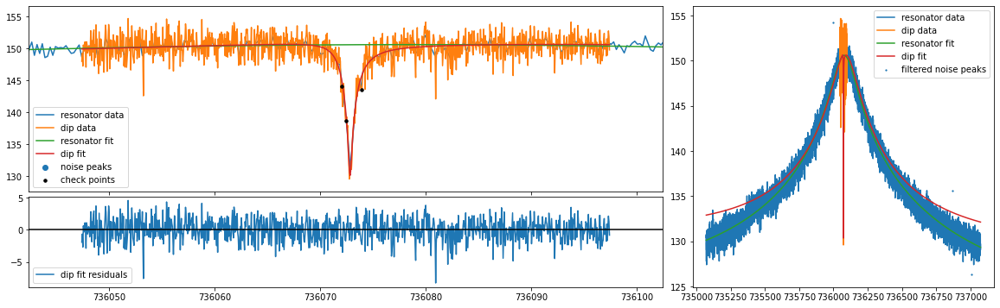

mean fit residuals = -8.9e-05 +/- 5.4e-02
[0.5, 3.0] 3.0 2.881017439594766 0.10888524174643115
736086.7104325178 736086.7104325178 736086.7104325178 736086.7104325178 736086.7104325178
mcycle                                 1
cycle                                 10
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_003808.470386
nu_z                 736072.843259949004
dnu_z                     0.015037494907
dip_width                 2.881017439595
ddip_width                0.108885241746
fit_err                   2.958523702413
fit_success                         True
average_idx                            0
nu_res               736086.710432517808
dnu_res                   0.410501936997
Q                      4544.130980183121
dQ                       32.172011235182
th                       -0.000439516181
dth                       0.000017697193
off               10350441715887.382

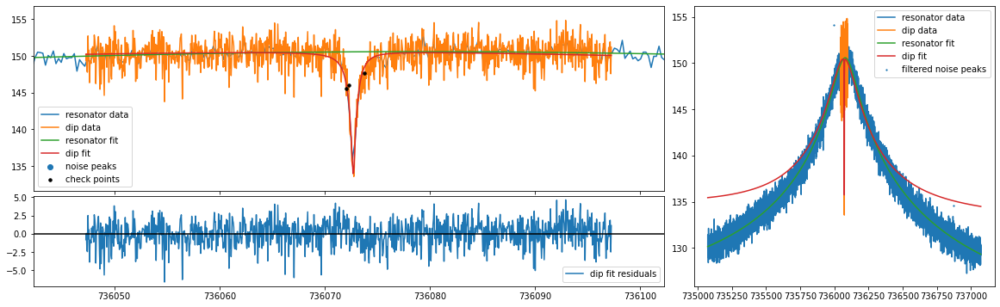

mean fit residuals = 6.3e-09 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7392870948693293 0.0922699027404873
736069.604552147 736069.604552147 736069.604552147 736069.604552147 736069.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.720784366713
dnu_z                     0.01598185269
dip_width                1.739287094869
ddip_width                0.09226990274
fit_err                  2.975152708366
fit_success                        True
average_idx                           0
nu_res              736069.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off            

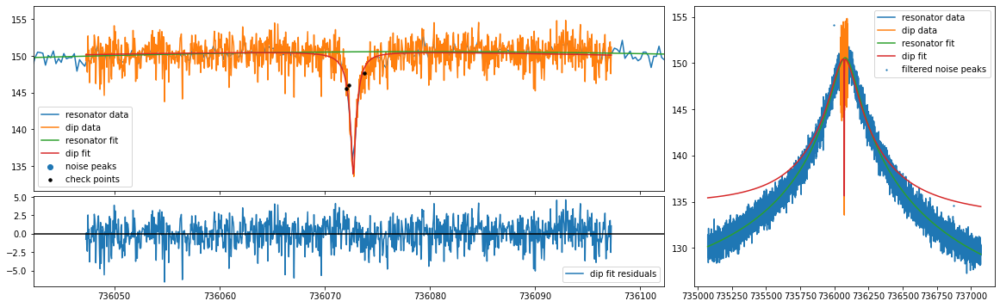

mean fit residuals = -3.1e-08 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7394685713975335 0.09188293094756131
736071.604552147 736071.604552147 736071.604552147 736071.604552147 736071.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.717716940329
dnu_z                    0.015903544789
dip_width                1.739468571398
ddip_width               0.091882930948
fit_err                  2.954343525103
fit_success                        True
average_idx                           0
nu_res              736071.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off          

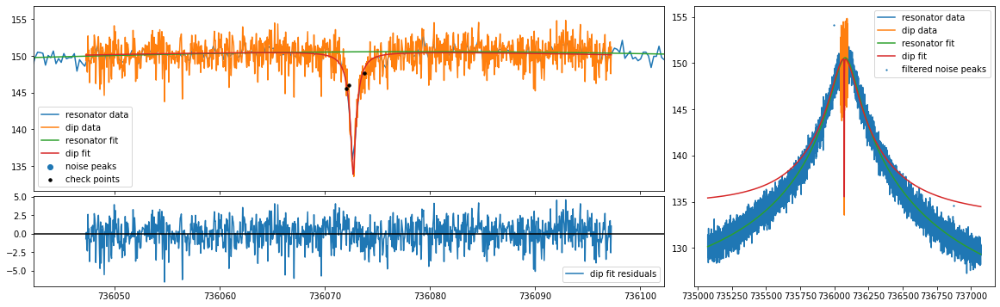

mean fit residuals = 2.8e-08 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7407765498676577 0.09157832574032586
736073.604552147 736073.604552147 736073.604552147 736073.604552147 736073.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                 736072.71464384417
dnu_z                    0.015840409204
dip_width                1.740776549868
ddip_width                0.09157832574
fit_err                  2.936448492565
fit_success                        True
average_idx                           0
nu_res              736073.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off           

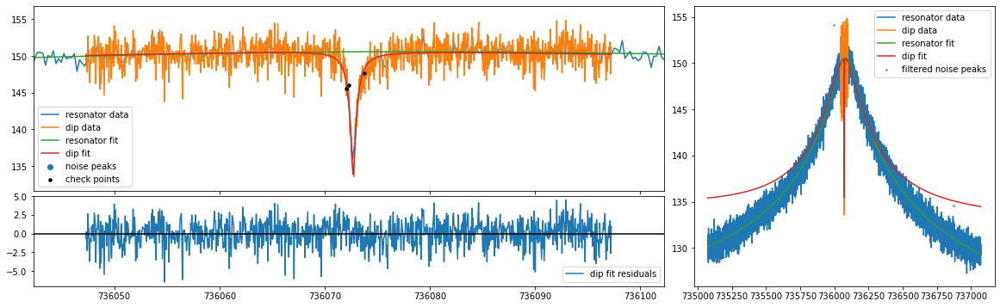

mean fit residuals = 1.5e-08 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.743200194584858 0.09135583927410151
736075.604552147 736075.604552147 736075.604552147 736075.604552147 736075.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                 736072.71156554413
dnu_z                    0.015792280477
dip_width                1.743200194585
ddip_width               0.091355839274
fit_err                  2.921500428266
fit_success                        True
average_idx                           0
nu_res              736075.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off            

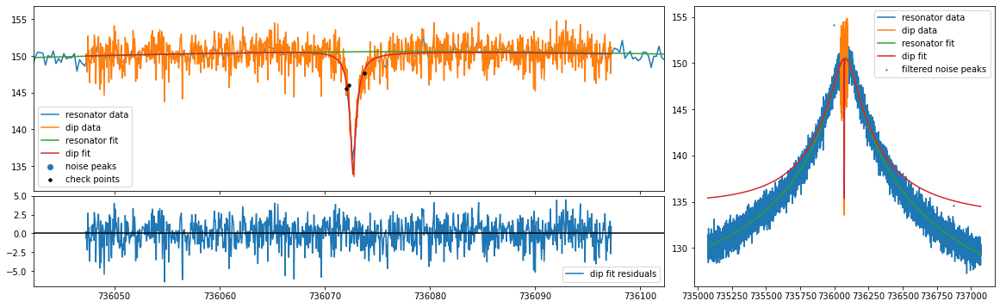

mean fit residuals = 3.1e-08 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7467265460596766 0.09121478972689008
736077.604552147 736077.604552147 736077.604552147 736077.604552147 736077.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.708483488415
dnu_z                    0.015758893309
dip_width                 1.74672654606
ddip_width               0.091214789727
fit_err                  2.909506246409
fit_success                        True
average_idx                           0
nu_res              736077.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off           

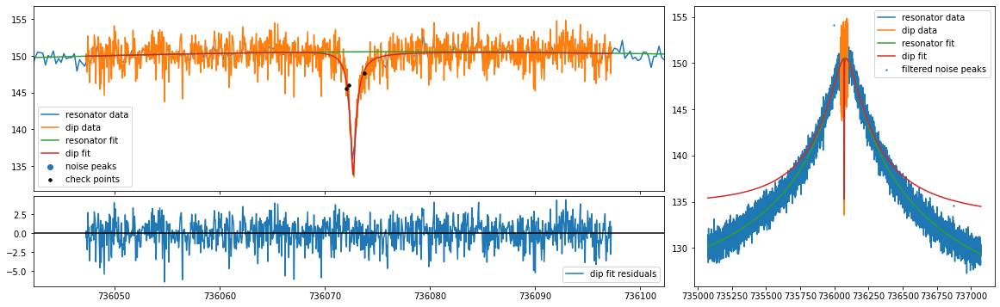

mean fit residuals = 2.6e-08 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.751326878988489 0.0911534790613628
736079.604552147 736079.604552147 736079.604552147 736079.604552147 736079.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.705397624639
dnu_z                    0.015739773488
dip_width                1.751326878988
ddip_width               0.091153479061
fit_err                  2.900447335518
fit_success                        True
average_idx                           0
nu_res              736079.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off             

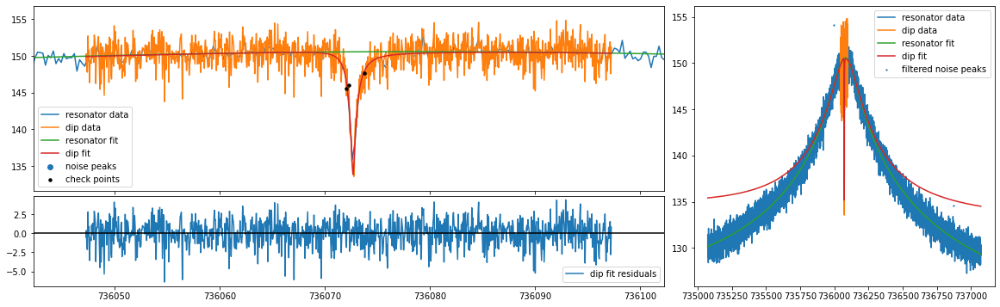

mean fit residuals = -4.5e-09 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7569824806082386 0.09117044676011256
736081.604552147 736081.604552147 736081.604552147 736081.604552147 736081.604552147
mcycle                               1
cycle                               11
position                    position_1
trap                                 2
acc_time                         20.05
time            20211129_010905.099869
nu_z               736072.702310589841
dnu_z                    0.01573451875
dip_width               1.756982480608
ddip_width               0.09117044676
fit_err                 2.894280495469
fit_success                       True
average_idx                          0
nu_res             736081.604552146979
dnu_res                 0.405586058821
Q                    4508.332448936657
dQ                      31.23511318581
th                     -0.000473084266
dth                     0.000017416898
off              24123520200818.

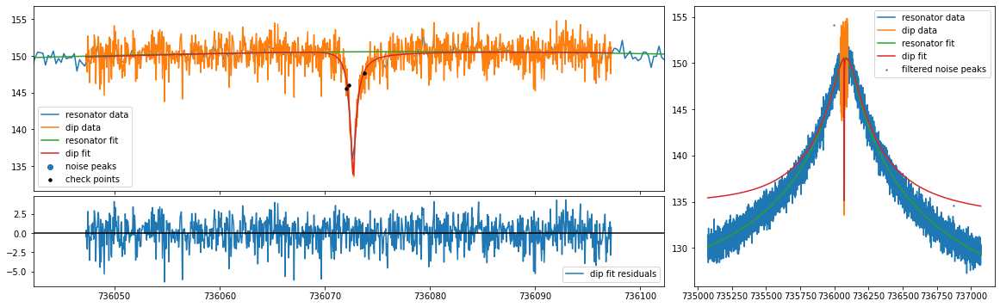

mean fit residuals = -5.8e-09 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7636553091227487 0.09126275852227649
736083.604552147 736083.604552147 736083.604552147 736083.604552147 736083.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.699223167496
dnu_z                    0.015742345521
dip_width                1.763655309123
ddip_width               0.091262758522
fit_err                  2.890939370537
fit_success                        True
average_idx                           0
nu_res              736083.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off          

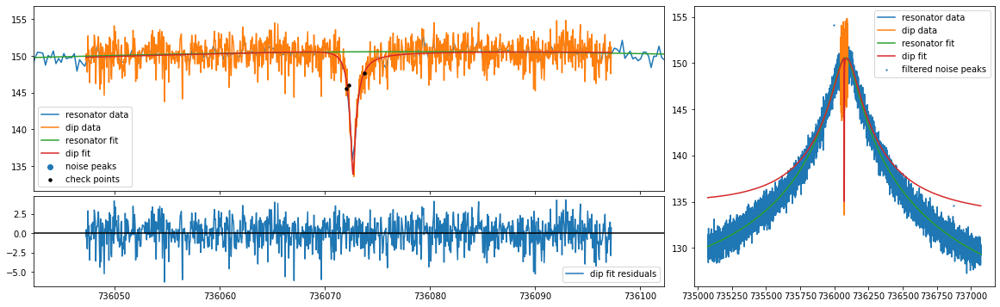

mean fit residuals = -3.6e-05 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7716659472314036 0.09144742455601633
736085.604552147 736085.604552147 736085.604552147 736085.604552147 736085.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.696043354692
dnu_z                    0.015768368581
dip_width                1.771665947231
ddip_width               0.091447424556
fit_err                  2.890336285116
fit_success                        True
average_idx                           0
nu_res              736085.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off          

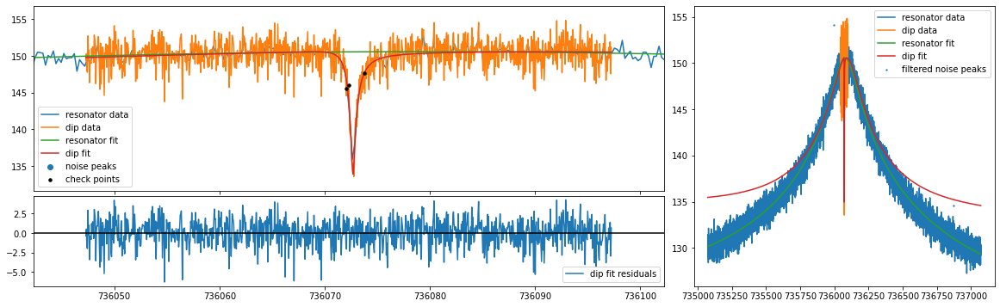

mean fit residuals = -3.6e-05 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7803137329973597 0.09168603391889928
736087.604552147 736087.604552147 736087.604552147 736087.604552147 736087.604552147
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_010905.099869
nu_z                736072.692896605702
dnu_z                    0.015801661496
dip_width                1.780313732997
ddip_width               0.091686033919
fit_err                  2.892364789402
fit_success                        True
average_idx                           0
nu_res              736087.604552146979
dnu_res                  0.405586058821
Q                     4508.332448936657
dQ                       31.23511318581
th                      -0.000473084266
dth                      0.000017416898
off          

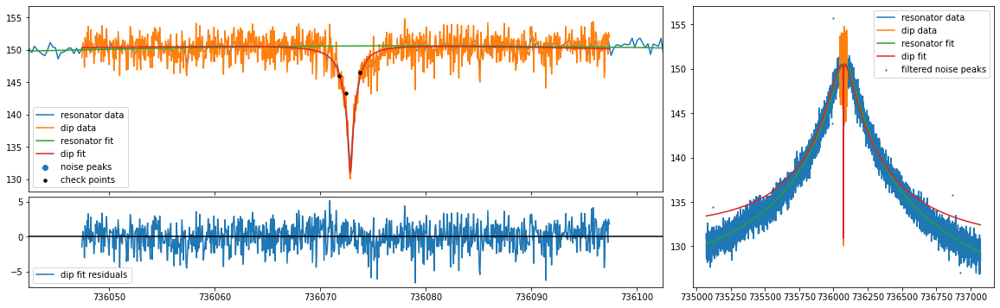

mean fit residuals = -2.1e-07 +/- 5.6e-02
[0.5, 3.0] 3.0 2.693310396669789 0.11043335927386866
736069.7265513208 736069.7265513208 736069.7265513208 736069.7265513208 736069.7265513208
mcycle                                 1
cycle                                 11
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_005845.887419
nu_z                 736072.873859872809
dnu_z                     0.016033725816
dip_width                  2.69331039667
ddip_width                0.110433359274
fit_err                   3.135527758249
fit_success                         True
average_idx                            0
nu_res               736069.726551320753
dnu_res                   0.408891233305
Q                       4546.04932949776
dQ                       32.088985034992
th                        -0.00049446705
dth                       0.000017615522
off             12344923489570.61132

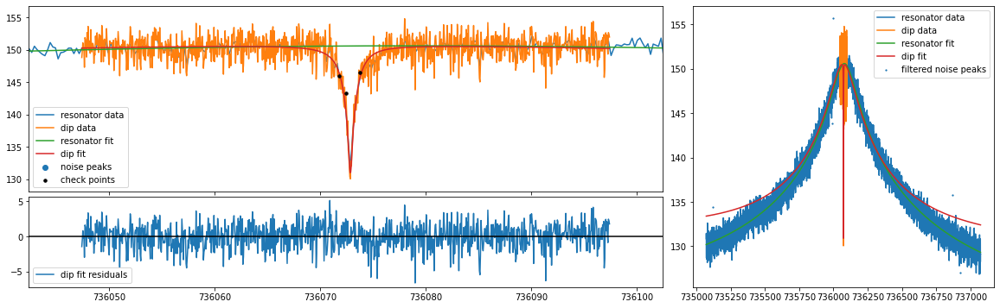

mean fit residuals = -1.9e-07 +/- 5.6e-02
[0.5, 3.0] 3.0 2.6934818467627437 0.11008316871845777
736071.7265513208 736071.7265513208 736071.7265513208 736071.7265513208 736071.7265513208
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_005845.887419
nu_z                736072.870684509282
dnu_z                    0.015973122747
dip_width                2.693481846763
ddip_width               0.110083168718
fit_err                  3.117983572694
fit_success                        True
average_idx                           0
nu_res              736071.726551320753
dnu_res                  0.408891233305
Q                      4546.04932949776
dQ                      32.088985034992
th                       -0.00049446705
dth                      0.000017615522
off               12299217074547.890625
doff          

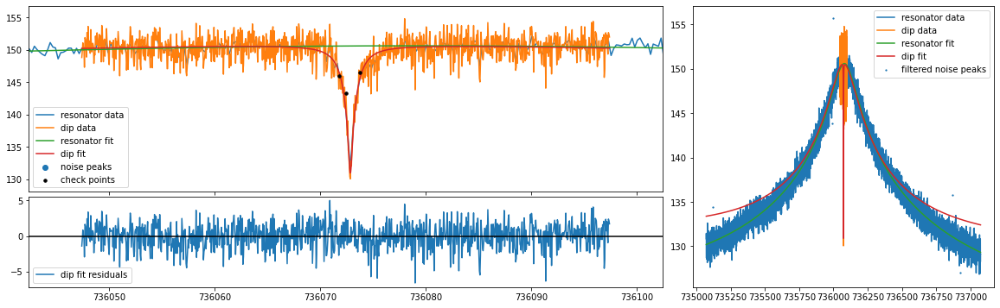

mean fit residuals = -1.8e-07 +/- 5.6e-02
[0.5, 3.0] 3.0 2.695418882934611 0.10983033874793505
736073.7265513208 736073.7265513208 736073.7265513208 736073.7265513208 736073.7265513208
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_005845.887419
nu_z                736072.867529516574
dnu_z                    0.015927420299
dip_width                2.695418882935
ddip_width               0.109830338748
fit_err                  3.103869178467
fit_success                        True
average_idx                           0
nu_res              736073.726551320753
dnu_res                  0.408891233305
Q                      4546.04932949776
dQ                      32.088985034992
th                       -0.00049446705
dth                      0.000017615522
off             12268502896525.89453125
doff           

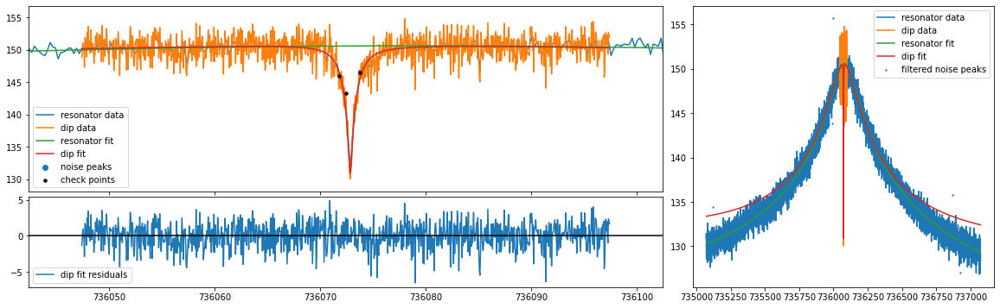

mean fit residuals = -1.4e-07 +/- 5.5e-02
[0.5, 3.0] 3.0 2.6991206095413824 0.10967538591289222
736075.7265513208 736075.7265513208 736075.7265513208 736075.7265513208 736075.7265513208
mcycle                                 1
cycle                                 11
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_005845.887419
nu_z                 736072.864393517375
dnu_z                     0.015896647815
dip_width                 2.699120609541
ddip_width                0.109675385913
fit_err                   3.093212050646
fit_success                         True
average_idx                            0
nu_res               736075.726551320753
dnu_res                   0.408891233305
Q                       4546.04932949776
dQ                       32.088985034992
th                        -0.00049446705
dth                       0.000017615522
off             12252614447589.8457

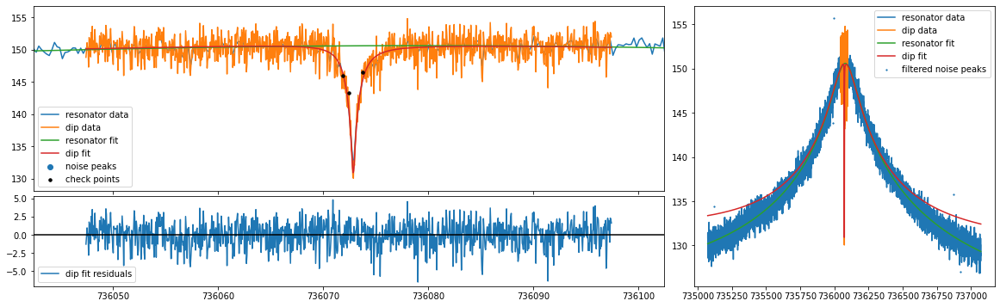

mean fit residuals = -3.1e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7044258858976313 0.10961052393640527
736077.7265513208 736077.7265513208 736077.7265513208 736077.7265513208 736077.7265513208
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_005845.887419
nu_z                736072.861274007359
dnu_z                    0.015878346677
dip_width                2.704425885898
ddip_width               0.109610523936
fit_err                  3.086014882239
fit_success                        True
average_idx                           0
nu_res              736077.726551320753
dnu_res                  0.408891233305
Q                      4546.04932949776
dQ                      32.088985034992
th                       -0.00049446705
dth                      0.000017615522
off            12246791068671.158203125
doff          

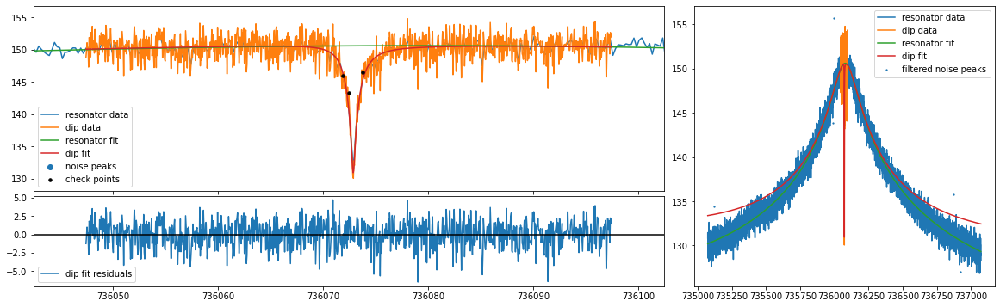

mean fit residuals = -2.9e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7116364643702227 0.10965096875360648
736079.7265513208 736079.7265513208 736079.7265513208 736079.7265513208 736079.7265513208
mcycle                                 1
cycle                                 11
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_005845.887419
nu_z                 736072.858174211578
dnu_z                     0.015877309035
dip_width                  2.71163646437
ddip_width                0.109650968754
fit_err                   3.082255930823
fit_success                         True
average_idx                            0
nu_res               736079.726551320753
dnu_res                   0.408891233305
Q                       4546.04932949776
dQ                       32.088985034992
th                        -0.00049446705
dth                       0.000017615522
off             12260279153582.5917

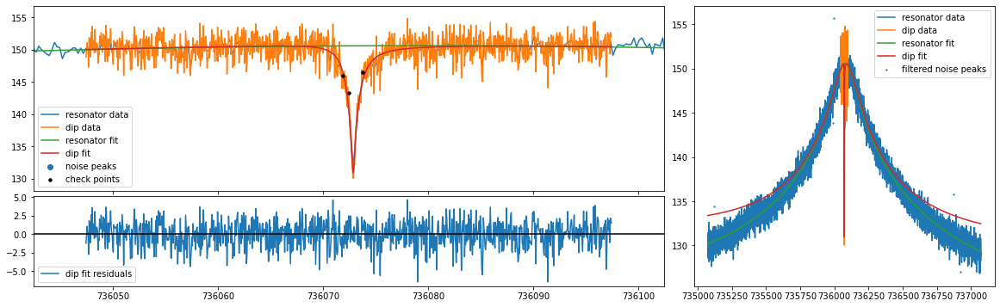

mean fit residuals = 1.3e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.720550920040655 0.10978657865973579
736081.7265513208 736081.7265513208 736081.7265513208 736081.7265513208 736081.7265513208
mcycle                                 1
cycle                                 11
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_005845.887419
nu_z                  736072.85508914513
dnu_z                     0.015890516753
dip_width                 2.720550920041
ddip_width                 0.10978657866
fit_err                   3.081889929374
fit_success                         True
average_idx                            0
nu_res               736081.726551320753
dnu_res                   0.408891233305
Q                       4546.04932949776
dQ                       32.088985034992
th                        -0.00049446705
dth                       0.000017615522
off              12287582733778.51171

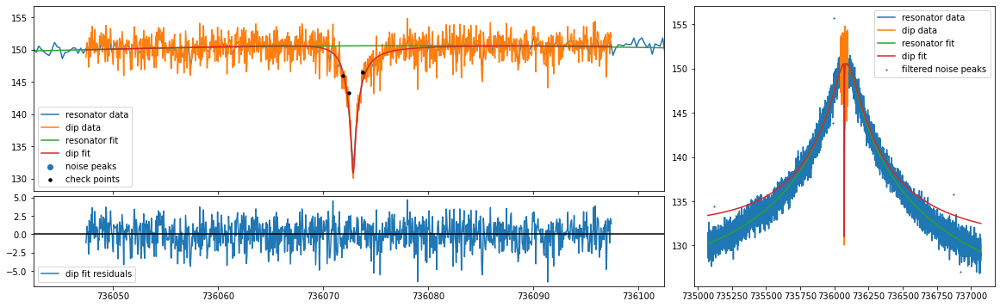

mean fit residuals = -8.5e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.73113876638537 0.11001553077065772
736083.7265513208 736083.7265513208 736083.7265513208 736083.7265513208 736083.7265513208
mcycle                                 1
cycle                                 11
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_005845.887419
nu_z                 736072.852017722325
dnu_z                     0.015917625226
dip_width                 2.731138766385
ddip_width                0.110015530771
fit_err                   3.084849416409
fit_success                         True
average_idx                            0
nu_res               736083.726551320753
dnu_res                   0.408891233305
Q                       4546.04932949776
dQ                       32.088985034992
th                        -0.00049446705
dth                       0.000017615522
off              12328446056322.58203

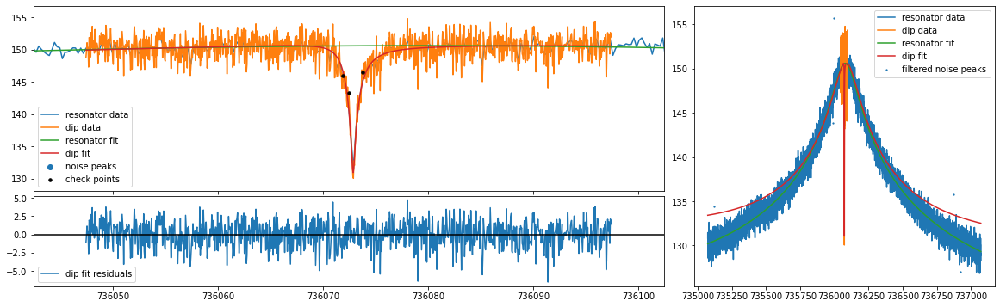

mean fit residuals = 8.8e-10 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7433391448019355 0.11033443577392593
736085.7265513208 736085.7265513208 736085.7265513208 736085.7265513208 736085.7265513208
mcycle                               1
cycle                               11
position                    position_2
trap                                 2
acc_time                         20.05
time            20211129_005845.887419
nu_z               736072.848959152238
dnu_z                   0.015957875263
dip_width               2.743339144802
ddip_width              0.110334435774
fit_err                 3.091046549779
fit_success                       True
average_idx                          0
nu_res             736085.726551320753
dnu_res                 0.408891233305
Q                     4546.04932949776
dQ                     32.088985034992
th                      -0.00049446705
dth                     0.000017615522
off            12381967695637.57421875
doff           2486424492945.275390

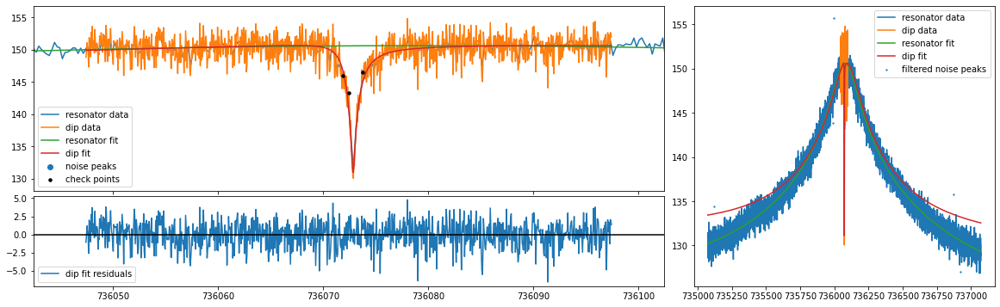

mean fit residuals = -2.1e-08 +/- 5.6e-02
[0.5, 3.0] 3.0 2.757139175871047 0.11074194768505488
736087.7265513208 736087.7265513208 736087.7265513208 736087.7265513208 736087.7265513208
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_005845.887419
nu_z                 736072.84591226757
dnu_z                    0.016011196524
dip_width                2.757139175871
ddip_width               0.110741947685
fit_err                  3.100375276869
fit_success                        True
average_idx                           0
nu_res              736087.726551320753
dnu_res                  0.408891233305
Q                      4546.04932949776
dQ                      32.088985034992
th                       -0.00049446705
dth                      0.000017615522
off            12448661815698.669921875
doff           

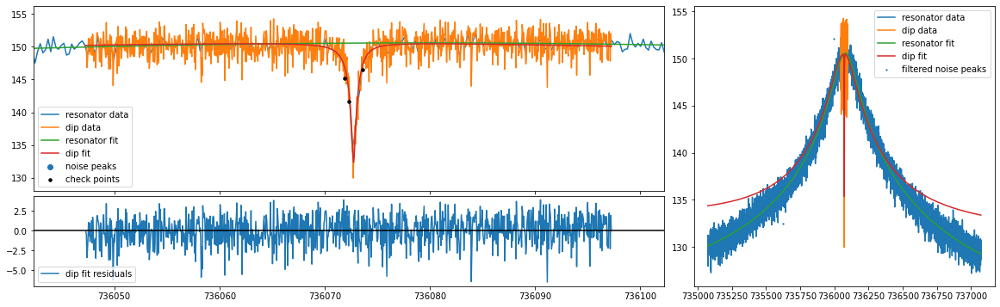

mean fit residuals = -2.7e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9152826764348179 0.09535844253678558
736070.0651035295 736070.0651035295 736070.0651035295 736070.0651035295 736070.0651035295
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_012943.440355
nu_z                736072.752018895117
dnu_z                    0.015254872215
dip_width                1.915282676435
ddip_width               0.095358442537
fit_err                  3.142919012573
fit_success                        True
average_idx                           0
nu_res              736070.065103529487
dnu_res                  0.413254841374
Q                     4519.615201137003
dQ                      31.973796019971
th                      -0.000490398945
dth                      0.000017787298
off     

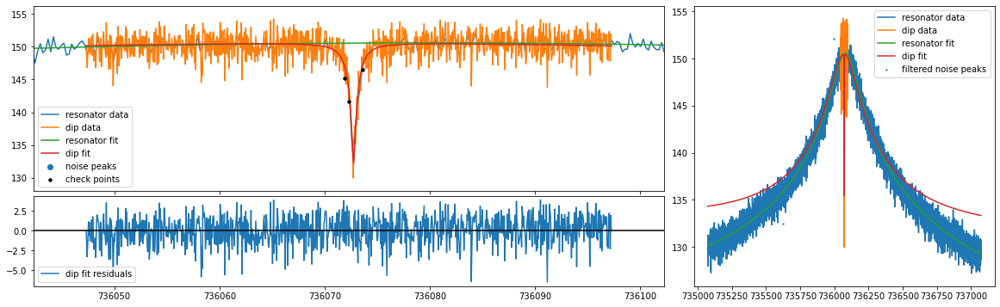

mean fit residuals = 2.8e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9081985746689778 0.09472060486625944
736072.0651035295 736072.0651035295 736072.0651035295 736072.0651035295 736072.0651035295
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_012943.440355
nu_z                 736072.74864757515
dnu_z                    0.015107826182
dip_width                1.908198574669
ddip_width               0.094720604866
fit_err                  3.125817487225
fit_success                        True
average_idx                           0
nu_res              736072.065103529487
dnu_res                  0.413254841374
Q                     4519.615201137003
dQ                      31.973796019971
th                      -0.000490398945
dth                      0.000017787298
off      

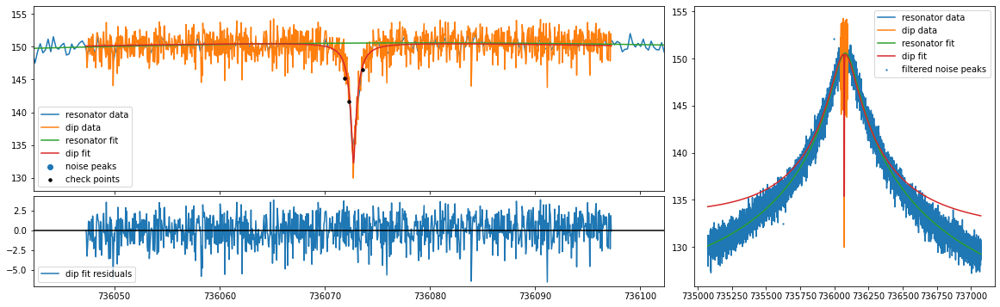

mean fit residuals = 2.2e-08 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9025264937397608 0.0941741911871065
736074.0651035295 736074.0651035295 736074.0651035295 736074.0651035295 736074.0651035295
mcycle                                 1
cycle                                 12
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_012943.440355
nu_z                 736072.745378687163
dnu_z                     0.014977611786
dip_width                  1.90252649374
ddip_width                0.094174191187
fit_err                   3.111643089867
fit_success                         True
average_idx                            0
nu_res               736074.065103529487
dnu_res                   0.413254841374
Q                      4519.615201137003
dQ                       31.973796019971
th                       -0.000490398945
dth                       0.0000

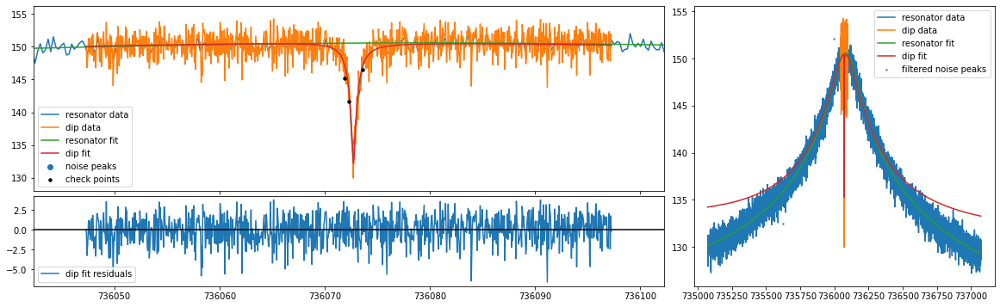

mean fit residuals = -3.2e-09 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8982512911329639 0.09371869695588976
736076.0651035295 736076.0651035295 736076.0651035295 736076.0651035295 736076.0651035295
mcycle                                 1
cycle                                 12
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_012943.440355
nu_z                 736072.742204861133
dnu_z                     0.014863957922
dip_width                 1.898251291133
ddip_width                0.093718696956
fit_err                   3.100445771241
fit_success                         True
average_idx                            0
nu_res               736076.065103529487
dnu_res                   0.413254841374
Q                      4519.615201137003
dQ                       31.973796019971
th                       -0.000490398945
dth                       0.00

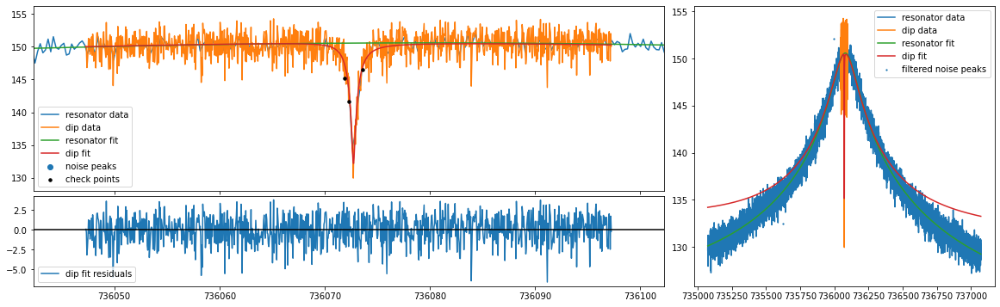

mean fit residuals = -2.3e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8953719540906533 0.09335444150864015
736078.0651035295 736078.0651035295 736078.0651035295 736078.0651035295 736078.0651035295
mcycle                                 1
cycle                                 12
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_012943.440355
nu_z                 736072.739124032203
dnu_z                     0.014766943959
dip_width                 1.895371954091
ddip_width                0.093354441509
fit_err                   3.092249026848
fit_success                         True
average_idx                            0
nu_res               736078.065103529487
dnu_res                   0.413254841374
Q                      4519.615201137003
dQ                       31.973796019971
th                       -0.000490398945
dth                       0.00

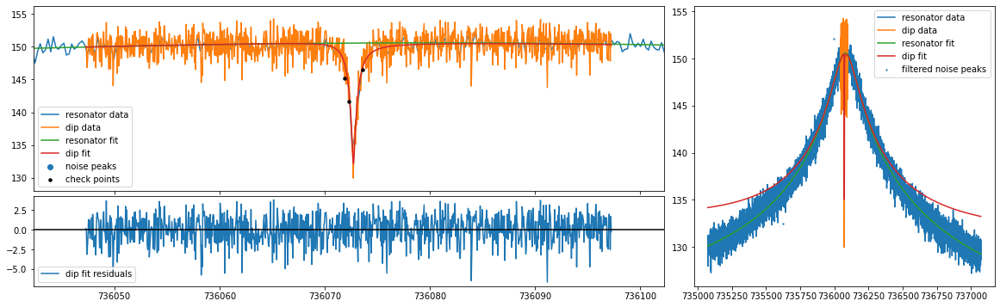

mean fit residuals = 3.7e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8938489077133756 0.09307895073306528
736080.0651035295 736080.0651035295 736080.0651035295 736080.0651035295 736080.0651035295
mcycle                                 1
cycle                                 12
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_012943.440355
nu_z                 736072.736125615425
dnu_z                     0.014685799551
dip_width                 1.893848907713
ddip_width                0.093078950733
fit_err                   3.087049937827
fit_success                         True
average_idx                            0
nu_res               736080.065103529487
dnu_res                   0.413254841374
Q                      4519.615201137003
dQ                       31.973796019971
th                       -0.000490398945
dth                       0.000

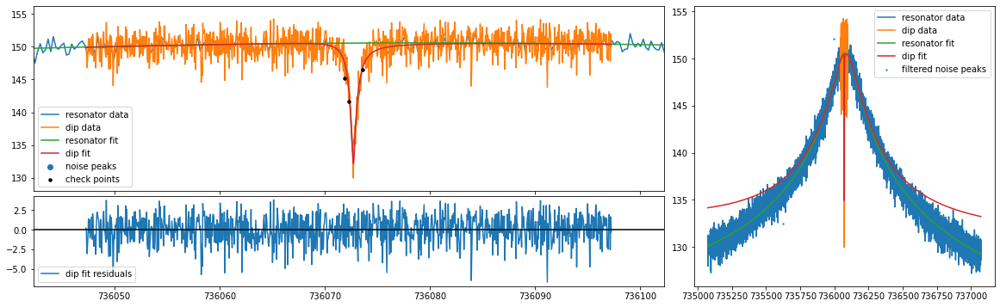

mean fit residuals = 5.6e-10 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8936653729349155 0.0928913234237316
736082.0651035295 736082.0651035295 736082.0651035295 736082.0651035295 736082.0651035295
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_012943.440355
nu_z                736072.733206349891
dnu_z                    0.014620330354
dip_width                1.893665372935
ddip_width               0.092891323424
fit_err                  3.084819911562
fit_success                        True
average_idx                           0
nu_res              736082.065103529487
dnu_res                  0.413254841374
Q                     4519.615201137003
dQ                      31.973796019971
th                      -0.000490398945
dth                      0.000017787298
off       

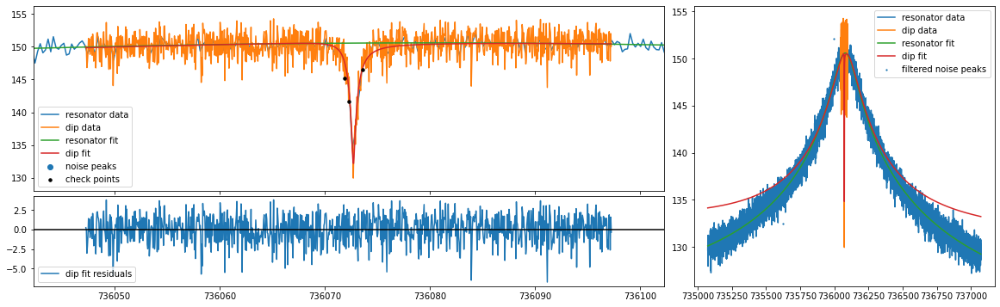

mean fit residuals = -2.1e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8947925856670875 0.09278965895250396
736084.0651035295 736084.0651035295 736084.0651035295 736084.0651035295 736084.0651035295
mcycle                                 1
cycle                                 12
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_012943.440355
nu_z                 736072.730362515082
dnu_z                     0.014570100055
dip_width                 1.894792585667
ddip_width                0.092789658953
fit_err                   3.085505899374
fit_success                         True
average_idx                            0
nu_res               736084.065103529487
dnu_res                   0.413254841374
Q                      4519.615201137003
dQ                       31.973796019971
th                       -0.000490398945
dth                       0.00

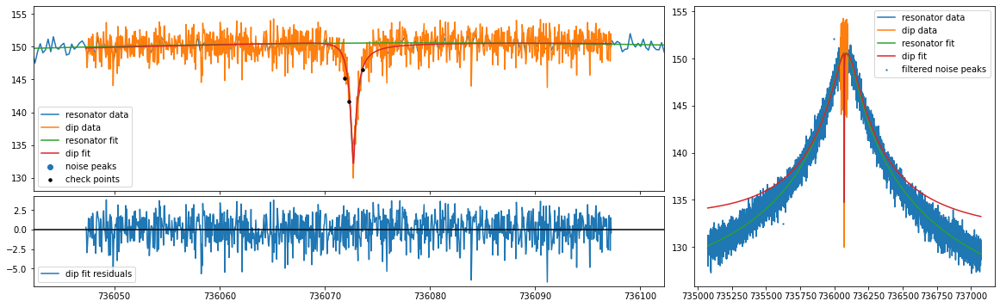

mean fit residuals = -1.3e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8971650816282828 0.09276941021687707
736086.0651035295 736086.0651035295 736086.0651035295 736086.0651035295 736086.0651035295
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211129_012943.440355
nu_z                736072.727581396932
dnu_z                    0.014533838385
dip_width                1.897165081628
ddip_width               0.092769410217
fit_err                  3.089032154854
fit_success                        True
average_idx                           0
nu_res              736086.065103529487
dnu_res                  0.413254841374
Q                     4519.615201137003
dQ                      31.973796019971
th                      -0.000490398945
dth                      0.000017787298
off     

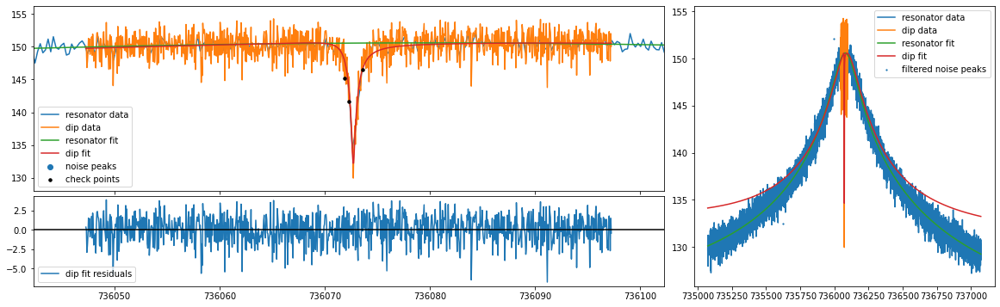

mean fit residuals = -2.6e-08 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9007923737598524 0.09283145099545383
736088.0651035295 736088.0651035295 736088.0651035295 736088.0651035295 736088.0651035295
mcycle                                 1
cycle                                 12
position                      position_1
trap                                   2
acc_time                           20.05
time              20211129_012943.440355
nu_z                 736072.724868658697
dnu_z                     0.014512206736
dip_width                  1.90079237376
ddip_width                0.092831450995
fit_err                   3.095302408191
fit_success                         True
average_idx                            0
nu_res               736088.065103529487
dnu_res                   0.413254841374
Q                      4519.615201137003
dQ                       31.973796019971
th                       -0.000490398945
dth                       0.00

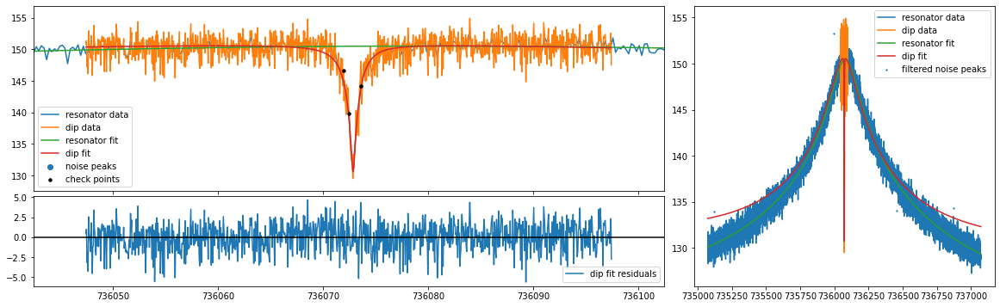

mean fit residuals = -2.4e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.977831027474518 0.11483260119763801
736070.087942218 736070.087942218 736070.087942218 736070.087942218 736070.087942218
mcycle                               1
cycle                               12
position                    position_2
trap                                 2
acc_time                         20.05
time            20211129_011924.227889
nu_z               736072.842260650359
dnu_z                   0.016198042431
dip_width               2.977831027475
ddip_width              0.114832601198
fit_err                 3.083214596075
fit_success                       True
average_idx                          0
nu_res             736070.087942217942
dnu_res                  0.41344959159
Q                    4478.617920188635
dQ                     31.382278519665
th                     -0.000436664429
dth                     0.000017698259
off            11360303870013.26953125
doff            2227318524266.73828125
A

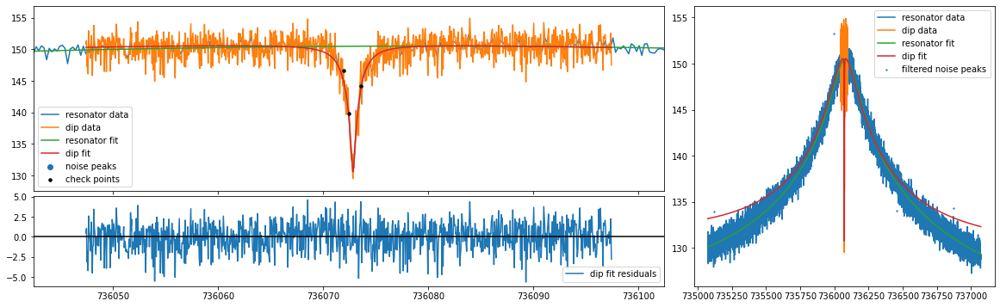

mean fit residuals = -2.9e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.977016036974337 0.11441581281180115
736072.087942218 736072.087942218 736072.087942218 736072.087942218 736072.087942218
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_011924.227889
nu_z                736072.838371780817
dnu_z                     0.01612805097
dip_width                2.977016036974
ddip_width               0.114415812812
fit_err                   3.06441611008
fit_success                        True
average_idx                           0
nu_res              736072.087942217942
dnu_res                   0.41344959159
Q                     4478.617920188635
dQ                      31.382278519665
th                      -0.000436664429
dth                      0.000017698259
off            11315252806215.919921875
doff               2

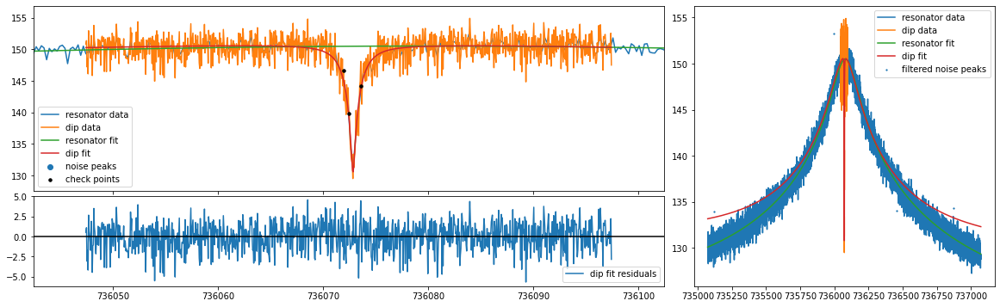

mean fit residuals = -2.5e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9779896126450454 0.11409177183999733
736074.087942218 736074.087942218 736074.087942218 736074.087942218 736074.087942218
mcycle                                 1
cycle                                 12
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_011924.227889
nu_z                 736072.834503080463
dnu_z                     0.016071124823
dip_width                 2.977989612645
ddip_width                 0.11409177184
fit_err                   3.048943114763
fit_success                         True
average_idx                            0
nu_res               736074.087942217942
dnu_res                    0.41344959159
Q                      4478.617920188635
dQ                       31.382278519665
th                       -0.000436664429
dth                       0.000017698259
off             11280578315816.076171875

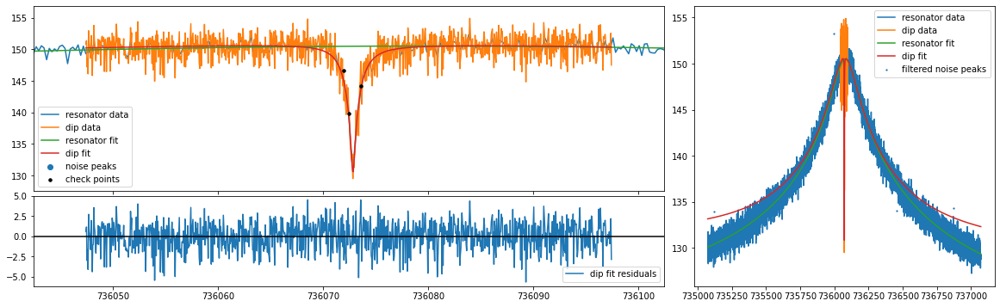

mean fit residuals = 1.0e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9807549189321816 0.11386136702485715
736076.087942218 736076.087942218 736076.087942218 736076.087942218 736076.087942218
mcycle                                 1
cycle                                 12
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_011924.227889
nu_z                 736072.830655916594
dnu_z                     0.016027379575
dip_width                 2.980754918932
ddip_width                0.113861367025
fit_err                   3.036828964223
fit_success                         True
average_idx                            0
nu_res               736076.087942217942
dnu_res                    0.41344959159
Q                      4478.617920188635
dQ                       31.382278519665
th                       -0.000436664429
dth                       0.000017698259
off             11256236143659.318359375


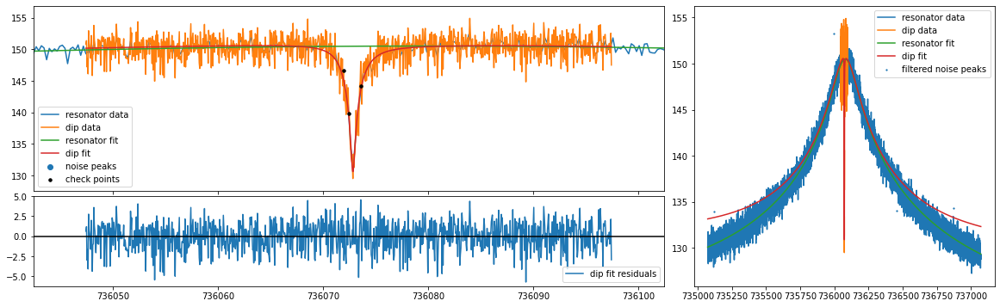

mean fit residuals = -5.3e-09 +/- 5.5e-02
[0.5, 3.0] 3.0 2.985307533862755 0.113724984978696
736078.087942218 736078.087942218 736078.087942218 736078.087942218 736078.087942218
mcycle                                 1
cycle                                 12
position                      position_2
trap                                   2
acc_time                           20.05
time              20211129_011924.227889
nu_z                 736072.826831532409
dnu_z                     0.015996871566
dip_width                 2.985307533863
ddip_width                0.113724984979
fit_err                   3.028084588076
fit_success                         True
average_idx                            0
nu_res               736078.087942217942
dnu_res                    0.41344959159
Q                      4478.617920188635
dQ                       31.382278519665
th                       -0.000436664429
dth                       0.000017698259
off                11242226764790.890625
do

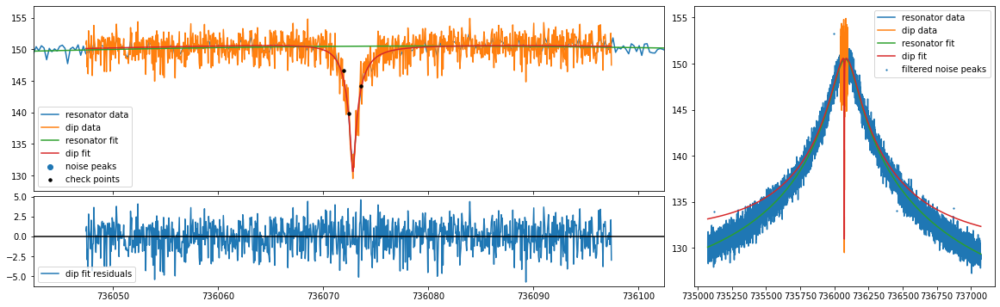

mean fit residuals = 3.6e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9916302943715722 0.11368216423663667
736080.087942218 736080.087942218 736080.087942218 736080.087942218 736080.087942218
mcycle                                  1
cycle                                  12
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_011924.227889
nu_z                  736072.823030173196
dnu_z                      0.015979470341
dip_width                  2.991630294372
ddip_width                 0.113682164237
fit_err                    3.022698704212
fit_success                          True
average_idx                             0
nu_res                736080.087942217942
dnu_res                     0.41344959159
Q                       4478.617920188635
dQ                        31.382278519665
th                        -0.000436664429
dth                        0.000017698259
off                 11

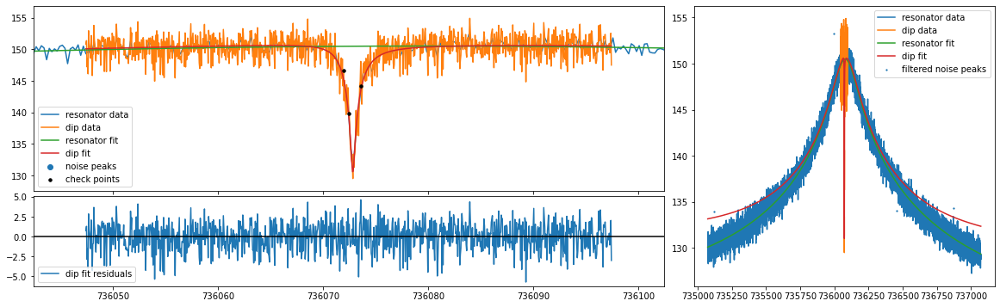

mean fit residuals = 4.3e-08 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9997012636053633 0.11373208108832741
736082.087942218 736082.087942218 736082.087942218 736082.087942218 736082.087942218
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211129_011924.227889
nu_z                736072.819252726506
dnu_z                    0.015975014415
dip_width                2.999701263605
ddip_width               0.113732081088
fit_err                  3.020638516904
fit_success                        True
average_idx                           0
nu_res              736082.087942217942
dnu_res                   0.41344959159
Q                     4478.617920188635
dQ                      31.382278519665
th                      -0.000436664429
dth                      0.000017698259
off            11244495037513.193359375
doff            2183

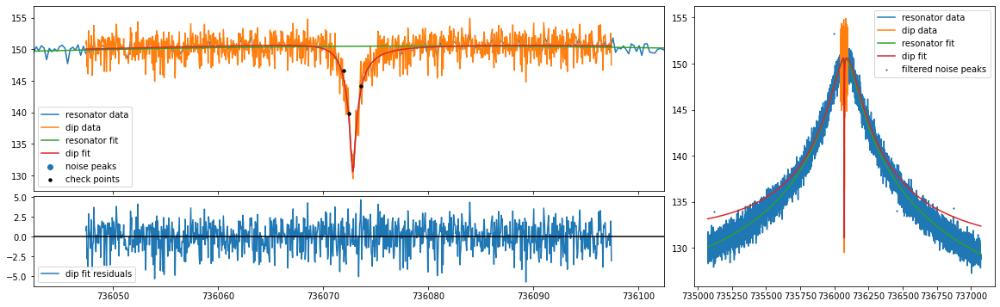

mean fit residuals = -7.0e-07 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0092926508964384 0.11386461299867702
736084.087942218 736084.087942218 736084.087942218 736084.087942218 736084.087942218
mcycle                                  1
cycle                                  12
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_011924.227889
nu_z                  736072.815486495034
dnu_z                      0.015980647901
dip_width                  3.009292650896
ddip_width                 0.113864612999
fit_err                    3.021850774058
fit_success                          True
average_idx                             0
nu_res                736084.087942217942
dnu_res                     0.41344959159
Q                       4478.617920188635
dQ                        31.382278519665
th                        -0.000436664429
dth                        0.000017698259
off              1125

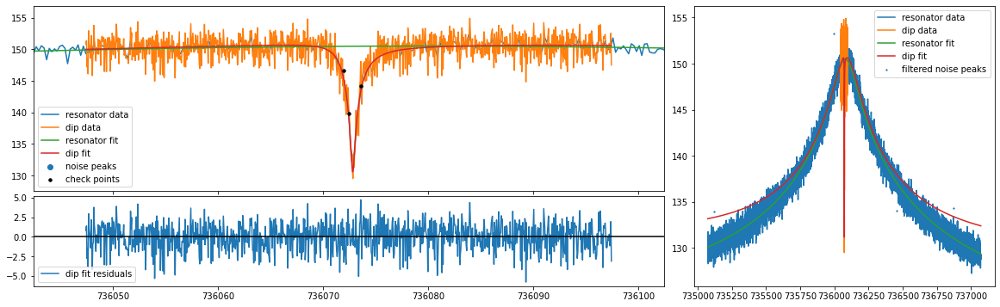

mean fit residuals = -1.1e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0207349162280357 0.11409338116847242
736086.087942218 736086.087942218 736086.087942218 736086.087942218 736086.087942218
mcycle                                  1
cycle                                  12
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_011924.227889
nu_z                  736072.811728500878
dnu_z                      0.016000591582
dip_width                  3.020734916228
ddip_width                 0.114093381168
fit_err                     3.02626336959
fit_success                          True
average_idx                             0
nu_res                736086.087942217942
dnu_res                     0.41344959159
Q                       4478.617920188635
dQ                        31.382278519665
th                        -0.000436664429
dth                        0.000017698259
off              1128

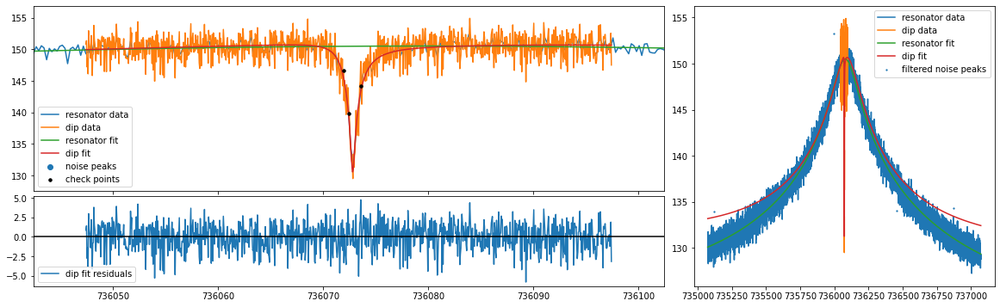

mean fit residuals = -1.7e-06 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0338558503925155 0.1144108015255953
736088.087942218 736088.087942218 736088.087942218 736088.087942218 736088.087942218
mcycle                                  1
cycle                                  12
position                       position_2
trap                                    2
acc_time                            20.05
time               20211129_011924.227889
nu_z                  736072.807987336419
dnu_z                      0.016032944154
dip_width                  3.033855850393
ddip_width                 0.114410801526
fit_err                    3.033787246331
fit_success                          True
average_idx                             0
nu_res                736088.087942217942
dnu_res                     0.41344959159
Q                       4478.617920188635
dQ                        31.382278519665
th                        -0.000436664429
dth                        0.000017698259
off               1131

,mcycle,cycle,position,trap,acc_time,time,nu_z,dnu_z,dip_width,ddip_width,...,Q,dQ,th,dth,off,doff,A,dA,scan_par,scan_val
0,1,2,position_1,2,20.05,20211128_220337.581016,736072.684219220188,0.014816539773,1.869471035317,0.089431527284,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,2.007948570821e+13,4.083890827481e+12,1.082507891448e+15,1.429424882876e+13,nu_res,-10
1,1,2,position_1,2,20.05,20211128_220337.581016,736072.681120993802,0.014729116716,1.869168266704,0.089010844873,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.994129656080e+13,4.045934421478e+12,1.081149289960e+15,1.421697385050e+13,nu_res,-8
2,1,2,position_1,2,20.05,20211128_220337.581016,736072.678056770121,0.014656469085,1.870080782135,0.088672505955,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.983175626178e+13,4.014229091221e+12,1.080904168286e+15,1.416315031641e+13,nu_res,-6
3,1,2,position_1,2,20.05,20211128_220337.581016,736072.675026548677,0.014598708734,1.872213648890,0.088417281766,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.975069469013e+13,3.988749936189e+12,1.081772633847e+15,1.413273935233e+13,nu_res,-4
4,1,2,position_1,2,20.05,20211128_220337.581016,736072.672030343092,0.014555720954,1.875559991641,0.088245042411,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.969751227582e+13,3.969395343557e+12,1.083754893249e+15,1.412567021122e+13,nu_res,-2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
215,1,12,position_2,2,20.05,20211129_011924.227889,736072.823030173196,0.015979470341,2.991630294372,0.113682164237,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.123835107912e+13,2.184149674734e+12,1.130692726820e+15,1.552257715772e+13,nu_res,0
216,1,12,position_2,2,20.05,20211129_011924.227889,736072.819252726506,0.015975014415,2.999701263605,0.113732081088,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.124449503751e+13,2.183282973975e+12,1.135633861755e+15,1.558188958967e+13,nu_res,2
217,1,12,position_2,2,20.05,20211129_011924.227889,736072.815486495034,0.015980647901,3.009292650896,0.113864612999,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.125597733860e+13,2.184331004584e+12,1.141748101027e+15,1.566505195817e+13,nu_res,4
218,1,12,position_2,2,20.05,20211129_011924.227889,736072.811728500878,0.016000591582,3.020734916228,0.114093381168,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.128044579261e+13,2.188295896255e+12,1.149036967423e+15,1.577237468603e+13,nu_res,6


In [25]:
## NOW FITTING THE DATA
grouping = settings["grouping"]
fit_func = settings["fit_func"]
plot = settings.get("plot", False)
#fit_func = "daniel"

scan_par = "nu_res"
scan_range = np.arange(-10, 10, 2)
min_cycle = 2
max_cycle = 12
max_mc = 1
this_trap = "trap2"

axial_avg_all_filename = Path(output_folder, "axial_avg_all.hdf5")

avg_axial_fitdata = pd.DataFrame( columns=["mcycle", "cycle", "position", "trap", "acc_time", "time", 
                                           "nu_z", "dnu_z", "dip_width", "ddip_width", "fit_err", "fit_success", "average_idx", 
                                           "nu_res", "dnu_res", "Q", "dQ", "th", "dth", "off", "doff", "A", "dA", "scan_par", "scan_val" ] )

from fticr_toolkit.fit_dip import fit_dip as fit_dip_alex
from fticr_toolkit.fit_dip import dip_func as dip_func_alex
import copy
import fticr_toolkit.fitaxialClass_Pavel as fitaxialClass_Pavel

if not settings["reuse_fitdata"]:
    for mc in mcycles:
        for subcycle in pnp_subcycles[mc]:
            if int(subcycle[5:]) < min_cycle or int(subcycle[5:]) > max_cycle  or int(mc[5:]) > max_mc:
                continue
                
            for pos in positions:
                for trap in traps:
                    #print(trap)
                    if trap != this_trap:
                        continue
                    avg_indexes = list(set(grouping))
                    #for idx, avg_len in enumerate(grouping):
                    for idx in avg_indexes:
                        path = "/m"+str(mc)+"/s"+str(subcycle)+"/"+str(pos)+"/"+str(trap)+"/avggrp"+str(idx)
                        print(path)
                        if idx==-1:
                            continue

                        try:
                            try:
                                with h5py.File(axial_avg_all_filename, 'r') as fobj:
                                    #fobj.visit(print)
                                    dset = fobj[path]
                                    data = dset[:]
                                    spec = data_conversion.Spectrum(dset)
                                    attrs = data_conversion.attrs_to_dict(dset)
                                    #for key, val in dset.attrs.items():
                                    #    #print(key, val)
                            except:
                                #raise
                                print(path, "not available, continue with other data")
                                dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), 0, '19700101_000000.000',
                                                       0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 ] , index=avg_axial_fitdata.columns)
                                avg_axial_fitdata = avg_axial_fitdata.append(dset, ignore_index=True)
                                continue
                            
                            nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
                            LO = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["LO"]
                            ion = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["ion"]
                            A, el, q = ideal_trap_physics.re_ionstr(ion)

                            if len(spec.freqs) < 10000:
                                # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                                raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")
    
                            x = spec.freqs
                            y = spec.amps
    
                            # trap 2
                            config = {
                                "center" : nu_z,
                                "nu_z" : nu_z,
                                "dip_center": nu_z,
                                "res_span" : 2000,
                                "resonator_span" : 2000, # same same
                                "span" : 10,
                                "dip_span": 50,
                                "q_guess" : 4000, 
                                "dip_range" : 10, 
                                "width_range" : [0.05*q, 0.3*q],
                                "dip_width_guess": 0.3*q,
                                "min_dip_width": 0.01,
                                "plot": True,
                                "print_fit_report": False,
                                "plot_results": True,
                                "fancy_plot": True,
                                "equal_widths": False,
                                "vary_off": True,
                                "vary_offset": True,
                                "vary_slope": False,
                                "vary_A": True,
                                "vary_nu_res": False,
                                "vary_Q": False,
                                "vary_nu_z_jitter": False,
                                "nu_z_jitter": 0.0,
                                "slope": 0.0,
                                "min_dip_depth": 2.0,
                                "double_dips": False,
                                "save_plot": False,
                            }
            
                            if trap == 'trap3':
                                config['dip_span'] = 80
                                config['q_quess'] = 11000
                                config['res_span'] = 3000
                                config['resonator_span'] = 3000
                                config["width_range"] = [0.05*q, 0.3*q]
                                config["dip_width_guess"] = 0.9*q
                                config['vary_A'] = True
                                config['vary_nu_res'] = True
                                config['vary_Q'] = True
                        
                            
                            if scan_par is not None:
                                config["vary_"+scan_par] = False
                            else:
                                scan_range = [0]
                                
                            for scan_val in scan_range:
                                if scan_par is not None:
                                    config["change_"+scan_par] = scan_val

                                try:

                                    if fit_func == 'menno':
                                        #popt, perr, data = fitaxial.mennofit(x, y, nu_z, beta0 = [None, 5e3, None, 1e-6, None, None, 0.1], 
                                        #                                        res_span=config['res_span'], dip_span=config['dip_span'], fixed_res='varA',
                                        #                                        rough_resonator=0, auto_better_guess=True)
                                        #popt, perr, data = fitaxial.mennofit(x, y, nu_z, tight_fit_bounds=[0,1,0,1,1,0,0])
                                        popt, perr, data = fitaxial.mennofit(x, y, nu_z, dip_span=config['dip_span'], dip_odr=False, tight_fit_bounds=[0,1,0,1,1,0,0])
                                        #popt, perr, data = fitaxial.mennofit(x, y, nu_z, res_span=2200, dip_span=dip_span, fixed_res=False)   
                                        #data, popt, pcov = fit_dip_alex(x, y, **fit_config)
                                        #data["fit_success"] = True
                                        data["fit_err_chi**2_red"] = data['fit_err']
                                        #plt.plot(x,y,label = 'data')
                                        #plt.plot(x, dip_func_alex(x,*popt)+ data['amp_offset'], label = "dip_fit")
                                        #plt.xlim(data["nu_z"] - 20, data["nu_z"] + 20)
                                        #plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z config')
                                        #plt.legend()
                                        #plt.show()

                                    elif fit_func == 'pavel':
                                        #pprint(config)
                                        fitPavel = fitaxialClass_Pavel.AXIAl_FIT(config)
                                        data = fitPavel.fit_axial_dip(x, y, settings["downsample"])
                                        data['fit_err_chi**2_red'] = data['redchi']
                                        data['th'] = data['slope']
                                        data['dth'] = data['dslope']
                                        data['off'] = data['offset']
                                        data['doff'] = data['doffset']

                                    elif fit_func == 'daniel':

                                        #fit_obj = fitaxial.AXIAl_FIT()
                                        fit_obj = fitaxialClass_old.AXIAl_FIT(config)
                                        #popt, perr, data = fit_obj.fit_axial_dip_test_new(x, y)
                                        popt, perr, data = fit_obj.fit_axial_dip(x, y, sigma=settings["sigma"], conv_func="sampling_average")

                                    print( config["width_range"], config["dip_width_guess"], data["dip_width"], data["ddip_width"] )

                                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), attrs["acc_time"], attrs["time"], 
                                                           data["nu_z"], data["dnu_z"], data["dip_width"], data["ddip_width"], data["fit_err_chi**2_red"],
                                                           data["fit_success"], idx, data["nu_res"], data["dnu_res"],
                                                           data["Q"], data["dQ"], data["th"], data["dth"], data["off"], data["doff"], 
                                                           data["A"], data["dA"], scan_par, scan_val ], index=avg_axial_fitdata.columns)
                                    print(data["nu_res"], data["nu_res"], data["nu_res"], data["nu_res"], data["nu_res"])
                                except:
                                    spec.cut(nu_z, 60)
                                    x, y = spec.freqs, spec.amps
                                    plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z guess')
                                    plt.plot(x, y)
                                    plt.show()
                                    #raise
                                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), attrs["acc_time"], attrs["time"], 
                                                           0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 , 0, 0] , index=avg_axial_fitdata.columns)
                                    print("\n FIT FAILED \n DATA MISSING? \nTRY raise to see what really happenig...", e, "\n")
                                    raise ValueError('bad fit')

                                print(dset)
                                avg_axial_fitdata = avg_axial_fitdata.append(dset, ignore_index=True)

                        except Exception as e:
                            raise
                            spec.cut(nu_z, 60)
                            x, y = spec.freqs, spec.amps
                            plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z guess')
                            plt.plot(x, y)
                            plt.show()
                            #raise
                            dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), attrs["acc_time"], attrs["time"], 
                                                   0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 , 0, 0] , index=avg_axial_fitdata.columns)
                            avg_axial_fitdata = avg_axial_fitdata.append(dset, ignore_index=True)
                            print("\n FIT FAILED \n DATA MISSING? \nTRY raise to see what really happenig...", e, "\n")
                            
display(avg_axial_fitdata)

In [26]:
if not settings["reuse_fitdata"]:
    avg_axial_fitdata["time"] = pd.to_datetime(avg_axial_fitdata['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(avg_axial_fitdata[avg_axial_fitdata["fit_success"]==True ])

    avg_axial_fitdata.to_csv(output_folder + "/axial_data_scan.csv", index=False)
else:
    avg_axial_fitdata = pd.read_csv(output_folder + "/axial_data_scan.csv")

,mcycle,cycle,position,trap,acc_time,time,nu_z,dnu_z,dip_width,ddip_width,...,Q,dQ,th,dth,off,doff,A,dA,scan_par,scan_val
0,1,2,position_1,2,20.05,2021-11-28 22:03:37.581016,736072.684219220188,0.014816539773,1.869471035317,0.089431527284,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,2.007948570821e+13,4.083890827481e+12,1.082507891448e+15,1.429424882876e+13,nu_res,-10
1,1,2,position_1,2,20.05,2021-11-28 22:03:37.581016,736072.681120993802,0.014729116716,1.869168266704,0.089010844873,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.994129656080e+13,4.045934421478e+12,1.081149289960e+15,1.421697385050e+13,nu_res,-8
2,1,2,position_1,2,20.05,2021-11-28 22:03:37.581016,736072.678056770121,0.014656469085,1.870080782135,0.088672505955,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.983175626178e+13,4.014229091221e+12,1.080904168286e+15,1.416315031641e+13,nu_res,-6
3,1,2,position_1,2,20.05,2021-11-28 22:03:37.581016,736072.675026548677,0.014598708734,1.872213648890,0.088417281766,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.975069469013e+13,3.988749936189e+12,1.081772633847e+15,1.413273935233e+13,nu_res,-4
4,1,2,position_1,2,20.05,2021-11-28 22:03:37.581016,736072.672030343092,0.014555720954,1.875559991641,0.088245042411,...,4458.548996210428,31.730568669151,-0.000468191718,0.000018006920,1.969751227582e+13,3.969395343557e+12,1.083754893249e+15,1.412567021122e+13,nu_res,-2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
215,1,12,position_2,2,20.05,2021-11-29 01:19:24.227889,736072.823030173196,0.015979470341,2.991630294372,0.113682164237,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.123835107912e+13,2.184149674734e+12,1.130692726820e+15,1.552257715772e+13,nu_res,0
216,1,12,position_2,2,20.05,2021-11-29 01:19:24.227889,736072.819252726506,0.015975014415,2.999701263605,0.113732081088,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.124449503751e+13,2.183282973975e+12,1.135633861755e+15,1.558188958967e+13,nu_res,2
217,1,12,position_2,2,20.05,2021-11-29 01:19:24.227889,736072.815486495034,0.015980647901,3.009292650896,0.113864612999,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.125597733860e+13,2.184331004584e+12,1.141748101027e+15,1.566505195817e+13,nu_res,4
218,1,12,position_2,2,20.05,2021-11-29 01:19:24.227889,736072.811728500878,0.016000591582,3.020734916228,0.114093381168,...,4478.617920188635,31.382278519665,-0.000436664429,0.000017698259,1.128044579261e+13,2.188295896255e+12,1.149036967423e+15,1.577237468603e+13,nu_res,6


[-10  -8  -6  -4  -2   2   4   6   8]
[-10  -8  -6  -4  -2   2   4   6   8]
2 position_1 12C6+


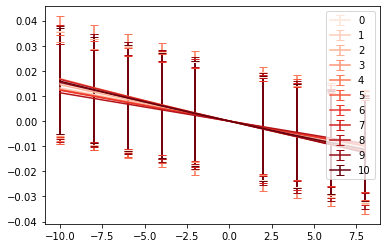

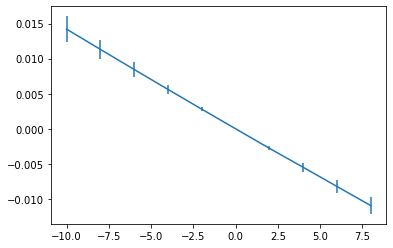

slope -0.00139032397535136 5.9068083603810485e-06
dnuc -0.0003786906599998474
dnuc/nuc -7.041779314262827e-12
2 position_2 20Ne10+


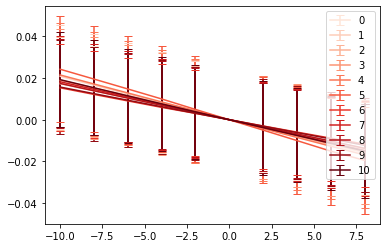

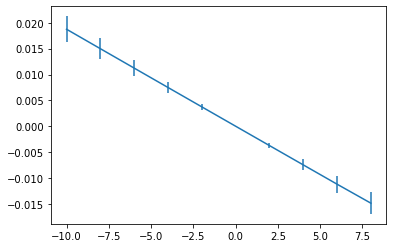

slope -0.0018699497616585668 1.4438433921525256e-06
dnuc -0.0005091354250907898
dnuc/nuc -9.463830176206914e-12
ratio change -2.421063349800079e-12


In [30]:
# check the scan:
par_look = "nu_z"
scan_val_uncertainty = 20
ion_diff = -0.1
print(scan_range)
scan_range = np.delete(scan_range, np.where(scan_range == 0)[0])
print(scan_range)
colors = plt.cm.Reds(np.linspace(0.1,1.0,len(scan_range)+2))

nucs = []
newnucs = []

for grpn, grpd in avg_axial_fitdata.groupby(["trap", "position"]):
    
    trap = grpn[0]
    posi = grpn[1]
    ion = meas_config[posi]['configuration']['traps'][trap]['ion']
    nup = meas_config[posi]['configuration']['traps'][trap]['nu_p']
    nuz = meas_config[posi]['configuration']['traps'][trap]['nu_z']
    num = meas_config[posi]['configuration']['traps'][trap]['nu_m']
    nuc = np.sqrt(nup**2 + nuz**2 + num**2)
    nucs.append(nuc)

    print(trap, posi, ion)
    
    vals_list = []
    dvals_list = []
    
    for cyc, grpc in grpd.groupby("cycle"):
        
        ref = grpc[grpc.scan_val == 0.0]
        #print(ref)
        ref_val = float(ref[par_look])
        dref_val = float(ref["d"+par_look])
        
        grpc = grpc.drop(ref.index)
        #print(grpc)
        look_vals = grpc[par_look].to_numpy() - ref_val
        dlook_vals = np.sqrt( grpc["d"+par_look].to_numpy()**2 + dref_val**2)
        
        if np.mean(dlook_vals) > 0.1:
            continue
        
        vals_list.append(look_vals)
        dvals_list.append(dlook_vals)
        
    vals_list = np.asarray(vals_list)
    dvals_list = np.asarray(dvals_list)
    
    for idx, vlist, dvlist in zip(range(len(vals_list)), vals_list, dvals_list):
        plt.errorbar(scan_range, vlist, yerr=dvlist, capsize=4, label=idx, color=colors[idx])
    
    plt.legend()
    plt.show()
    
    mean_vals = np.mean(vals_list, axis=0)
    dmean_vals = np.std(vals_list, axis=0)
    
    plt.errorbar(scan_range, mean_vals, yerr=dmean_vals)
    plt.show()
    
    popt, pcov = np.polyfit(scan_range, mean_vals, 1, w=1/dmean_vals, cov=True)
    perr = np.sqrt(np.diag(pcov))
    m = popt[0]
    dm = perr[0]
    print("slope", m, dm)
    m *= scan_val_uncertainty + (ion_diff if trap%2==0 else 0)
    
    newnuc = np.sqrt(nup**2 + (nuz+m)**2 + num**2)
    newnucs.append(newnuc)
    dnuc = newnuc - nuc
    
    print("dnuc", dnuc)
    print("dnuc/nuc", dnuc/nuc)
    
ratio = nucs[0]/nucs[1]
newratio = newnucs[0]/newnucs[1]
print("ratio change", ratio-newratio)

[-10  -8  -6  -4  -2   2   4   6   8]
[-10  -8  -6  -4  -2   2   4   6   8]
2 position_1 12C6+
slope -0.00139032397535136 5.9068083603810485e-06
dnuc -0.00018839538097381592
dnuc/nuc -3.5032252885366014e-12
2 position_2 20Ne10+


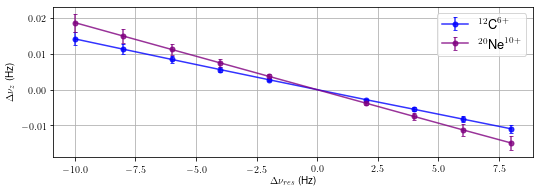

slope -0.0018699497616585668 1.4438433921525256e-06
dnuc -0.00025328993797302246
dnuc/nuc -4.708163761913078e-12
ratio change -1.2044809594158323e-12
ratio change 1.6448072232757436e-13


In [67]:

import matplotlib as mpl
from matplotlib import rc
mpl.rcParams['text.usetex'] = True
mpl.rcParams['text.latex.preamble'] = [r'\usepackage{amsmath}'] #for \text command
rc('font',**{'family':'sans-serif','sans-serif':['Helvetica']})
# check the scan:
par_look = "nu_z"
scan_val_uncertainty = 10
ion_diff = -0.1
print(scan_range)
scan_range = np.delete(scan_range, np.where(scan_range == 0)[0])
print(scan_range)
colors = plt.cm.Reds(np.linspace(0.1,1.0,len(scan_range)+2))

nucs = []
ms = []
newnucs = []


    
i = 0
for grpn, grpd in avg_axial_fitdata.groupby(["trap", "position"]):
    
    trap = grpn[0]
    posi = grpn[1]
    ion = meas_config[posi]['configuration']['traps'][trap]['ion']
    nup = meas_config[posi]['configuration']['traps'][trap]['nu_p']
    nuz = meas_config[posi]['configuration']['traps'][trap]['nu_z']
    num = meas_config[posi]['configuration']['traps'][trap]['nu_m']
    nuc = np.sqrt(nup**2 + nuz**2 + num**2)
    nucs.append(nuc)

    print(trap, posi, ion)
    
    vals_list = []
    dvals_list = []
    
    for cyc, grpc in grpd.groupby("cycle"):
        
        ref = grpc[grpc.scan_val == 0.0]
        #print(ref)
        ref_val = float(ref[par_look])
        dref_val = float(ref["d"+par_look])
        
        grpc = grpc.drop(ref.index)
        #print(grpc)
        look_vals = grpc[par_look].to_numpy() - ref_val
        dlook_vals = np.sqrt( grpc["d"+par_look].to_numpy()**2 + dref_val**2)
        
        if np.mean(dlook_vals) > 0.1:
            continue
        
        vals_list.append(look_vals)
        dvals_list.append(dlook_vals)
        
    vals_list = np.asarray(vals_list)
    dvals_list = np.asarray(dvals_list)
    
    mean_vals = np.mean(vals_list, axis=0)
    dmean_vals = np.std(vals_list, axis=0)
    
    c = [float(i)/float(2), 0.0, float(2-i)/float(2)]
    
    if i:
        ionlabel = r'$^{20}\text{Ne}^{10+}$'
    else:
        ionlabel = r'$^{12}\text{C}^{6+}$'

    plt.errorbar(scan_range, mean_vals, yerr=dmean_vals, fmt='o-', c=c,alpha=0.8, capsize=2, ms=5, label=ionlabel)
    if i:
        f = plt.gcf()
        f.set_figwidth(7.6)
        f.set_figheight(2.8)

        plt.ylabel(r'$\Delta \nu_z$ (Hz)')
        plt.xlabel(r'$\Delta \nu_{res}$ (Hz)')
        plt.tight_layout()
        plt.legend(loc='upper right',prop={'size': 13})
        plt.grid()
        plt.savefig("neon_trap2_nures_dipline.pdf", dpi=100, patch=0.5)
        plt.show()

        i = 0
    else:
        i = 1
    
    popt, pcov = np.polyfit(scan_range, mean_vals, 1, w=1/dmean_vals, cov=True)
    perr = np.sqrt(np.diag(pcov))
    m = popt[0]
    ms.append(m)
    dm = perr[0]
    print("slope", m, dm)
    m *= (scan_val_uncertainty + (ion_diff if trap%2==0 else 0))
    
    newnuc = np.sqrt(nup**2 + (nuz+m)**2 + num**2)
    newnucs.append(newnuc)
    dnuc = newnuc - nuc
    
    print("dnuc", dnuc)
    print("dnuc/nuc", dnuc/nuc)
    
ratio = nucs[0]/nucs[1]
newratio = newnucs[0]/newnucs[1]
print("ratio change", ratio-newratio)
print("ratio change", (ms[0]-ms[1])*2/500e3*(500e3/54e6)**2)

In [29]:
par_look = "nu_z"
scan_val_uncertainty = 20
ion_diff = -0.1
print(scan_range)
scan_range = np.delete(scan_range, np.where(scan_range == 0)[0])
print(scan_range)
colors = plt.cm.Reds(np.linspace(0.1,1.0,len(scan_range)+2))

nucs = []
newnucs = []

for grpn, grpd in avg_axial_fitdata.groupby(["trap"]):
    
    positions = ["position_1", "position_2"]
    trap = grpn[0]
    posi = grpn[1]
    pos1 = meas_config["position_1"]['configuration']['traps'][trap]['nu_z']
    pos2 = meas_config["position_2"]['configuration']['traps'][trap]['nu_z']

[-10  -8  -6  -4  -2   2   4   6   8]
[-10  -8  -6  -4  -2   2   4   6   8]


TypeError: 'int' object is not subscriptable

In [ ]:
# single spec fit.
avg_axial_fitdata_single = pd.DataFrame( columns=["mcycle", "cycle", "position", "trap", "acc_time", "time", 
                                           "nu_z", "dnu_z", "dip_width", "ddip_width", "fit_err", "fit_success", "average_idx", 
                                           "nu_res", "dnu_res", "Q", "dQ", "th", "dth", "off", "doff", "A", "dA" ] )


# you have to know your data structure here and loop over the correct parts of the paths to the actual datasets.
# for every for-loop a subgroup of the fhds/hdf5 datagroup is picked out.
if settings.get("single_axial_fits", False): #and not settings.get("reuse_fitdata", True):
    print("SINGLE FITS...")
    for mc in mcycles:
        pnp_measurement_grp = data_root[mc]["pnp_measurement"]
        for subcycle in pnp_subcycles[mc]:
            subcycle_grp = pnp_measurement_grp[subcycle]
            for pos in positions:
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    try:
                        trap_grp = position_grp[trap]
                        
                        fs = filter_settings[(filter_settings['mcycle']==int(mc[-1])) & (filter_settings['position']==pos) & (filter_settings['trap']==int(trap[-1]))]
                        #print(fs)
                        sc = int(subcycle[5:])
                        minc = int(fs.min_cycle)
                        maxc = int(fs.max_cycle)
                        if sc < minc or sc > (maxc + overhead):# or minc == maxc:
                            print('filtered out', mc, pos, trap, subcycle)
                            continue
                        
                        print("maincycle", mc, "subcycle", subcycle, "pos", pos, "trap", trap)

                        keys = []
                        for name, dset in trap_grp.items():
                            use = False
                            only_attr = {"type": "amplitude"}
                            for attr, val in only_attr.items():
                                if dset.attrs[attr] == val:
                                    use = True
                            if use:
                                keys.append(name)

                        print('specs', len(keys))
                        # loop over datasets and try to fit
                        for idx, name in enumerate(keys):
                            print(name)
                            spec = data_conversion.Spectrum(trap_grp[name])
                            attrs = data_conversion.attrs_to_dict(trap_grp[name])
                            pos = attrs["position"]
                            trap = attrs["trap"][-1]
                            acc_time = attrs["acc_time"]
                            time = attrs["time"]
                            nu_z = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
                            
                            if len(spec.freqs) < 10000:
                                # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                                raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")
    
                            x = spec.freqs
                            y = spec.amps
    
                            # trap 2
                            config = {
                                "center" : nu_z,
                                "nu_z" : nu_z,
                                "dip_center": nu_z,
                                "res_span" : 5000,
                                "resonator_span" : 5000, # same same
                                "span" : 10,
                                "dip_span": 20,
                                "q_guess" : 4000, 
                                "dip_range" : 5, 
                                "width_range" : [0.1, 3],
                                "min_dip_width": 0.01,
                                "plot": False,
                                "print_fit_report": False,
                                "plot_results": True,
                                "fancy_plot": False,
                                "equal_widths": False,
                                "vary_off": False,
                                "vary_slope": False,
                                "vary_A": False,
                                "vary_nu_res": False,
                                "vary_Q": False,
                                "vary_nu_z_jitter": False,
                                "nu_z_jitter": 0.0,
                                "slope": 0.0,
                                "min_dip_depth": 4.0,
                                "double_dips": False,
                            }
            
                            if trap == '3':
                                config['dip_span'] = 40
                                config['q_quess'] = 10000
                                config['vary_A'] = True
                                config['vary_nu_res'] = True
                                config['vary_Q'] = True
                        
                            
                            try:
                                
                                if fit_func == 'menno':
                                    #popt, perr, data = fitaxial.mennofit(x, y, nu_z, beta0 = [None, 5e3, None, 1e-6, None, None, 0.1], 
                                    #                                        res_span=config['res_span'], dip_span=config['dip_span'], fixed_res='varA',
                                    #                                        rough_resonator=0, auto_better_guess=True)
                                    #popt, perr, data = fitaxial.mennofit(x, y, nu_z, tight_fit_bounds=[0,1,0,1,1,0,0])
                                    popt, perr, data = fitaxial.mennofit(x, y, nu_z, dip_span=config['dip_span'], dip_odr=False, tight_fit_bounds=[0,1,0,1,1,0,0])
                                    #popt, perr, data = fitaxial.mennofit(x, y, nu_z, res_span=2200, dip_span=dip_span, fixed_res=False)   
                                    #data, popt, pcov = fit_dip_alex(x, y, **fit_config)
                                    #data["fit_success"] = True
                                    data["fit_err_chi**2_red"] = data['fit_err']
                                    #plt.plot(x,y,label = 'data')
                                    #plt.plot(x, dip_func_alex(x,*popt)+ data['amp_offset'], label = "dip_fit")
                                    #plt.xlim(data["nu_z"] - 20, data["nu_z"] + 20)
                                    #plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z config')
                                    #plt.legend()
                                    #plt.show()

                                elif fit_func == 'pavel':
                                    
                                    fitPavel = fitaxialClass_Pavel.AXIAl_FIT(config)
                                    data = fitPavel.fit_axial_dip(x, y, settings["downsample"])
                                    data['fit_err_chi**2_red'] = data['redchi']
                                    data['th'] = data['slope']
                                    data['dth'] = data['dslope']
                                    data['off'] = data['offset']
                                    data['doff'] = data['doffset']

                                elif fit_func == 'daniel':
                                    
                                    fit_obj = fitaxial.AXIAl_FIT()
                                    fit_obj = fitaxialClass_old.AXIAl_FIT(fit_opt)
                                    popt, perr, data = fit_obj.fit_axial_dip_test_new(x, y)
                                    #popt, perr, data = fit_obj.fit_axial_dip(x, y)
            
                                dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap), attrs["acc_time"], time, 
                                                       data["nu_z"], data["dnu_z"], data["dip_width"], data["ddip_width"], data["fit_err_chi**2_red"],
                                                       data["fit_success"], idx, data["nu_res"], data["dnu_res"],
                                                       data["Q"], data["dQ"], data["th"], data["dth"], data["off"], data["doff"], 
                                                       data["A"], data["dA"] ], index=avg_axial_fitdata_single.columns)
                        
                            except Exception as e:
                                #raise
                                data = {"fit_success": False}
                                dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap), attrs["acc_time"], attrs["time"], 
                                                    0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 ] , index=avg_axial_fitdata_single.columns)
                            
                                #raise
                                spec.cut(nu_z, 200)
                                x, y = spec.freqs, spec.amps
                                plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z guess')
                                plt.plot(x, y)
                                plt.show()
                                #raise

                                print("\n FIT FAILED \n DATA MISSING? \nTRY raise to see what really happenig...", e, "\n")

                            avg_axial_fitdata_single = avg_axial_fitdata_single.append(dset, ignore_index=True)
                            
                    except Exception as e:
                        #raise
                        print(e)
                        print('done?', mc, subcycle, trap)

In [ ]:
if True:# not settings["reuse_fitdata"]:
    avg_axial_fitdata_single["time"] = pd.to_datetime(avg_axial_fitdata_single['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(avg_axial_fitdata_single)

    avg_axial_fitdata_single.to_csv(output_folder + "/axial_data_single.csv", index=False)
else:
    avg_axial_fitdata_single = pd.read_csv(output_folder + "/axial_data_single.csv")

### Step 3: Phase readout

Each phase is read out at the position given by the axial fit done before. This also means the same grouping is applied to the phase data. This applies to the normal pnp cycle, unwrap phase readout is done in the next next cell.

In [ ]:

phase_data = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "average_idx", "amp" ] )

for mc in mcycles:
    pnp_measurement_grp = data_root[mc]["pnp_measurement"]
    for subcycle in pnp_subcycles[mc]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        for pos in positions:
            position_grp = subcycle_grp[pos]
            for trap in traps:
                try:
                    trap_grp = position_grp[trap]
                except:
                    continue
                if trap_grp is None:
                    continue

                axial_data = avg_axial_fitdata[ (avg_axial_fitdata["mcycle"] == int(mc[5:])) & (avg_axial_fitdata["cycle"] == int(subcycle[5:])) & (avg_axial_fitdata["position"] == pos) & (avg_axial_fitdata["trap"] == int(trap[4:])) ]
                #display(axial_data)
    
                #trap_grp.sort_values(by="time", inplace=True)
                only_attr = {"type": "phase"}
            
                counter = 0
                last_nu_z = 0
                for name, dset in trap_grp.items():
                    
                    # check if this is the correct type of data to average
                    skip = False
                    for attr, val in only_attr.items():
                        if dset.attrs[attr] != val:
                            skip = True
                    if skip:
                        continue

                    #print(counter, grouping[counter])

                    try:
                        nu_z = float(axial_data[ axial_data["average_idx"] == grouping[counter] ]["nu_z"])
                        nu_z_time = axial_data[ axial_data["average_idx"] == grouping[counter] ]["time"]
                        last_nu_z = nu_z
                    except Exception as e:
                        nu_z = last_nu_z
                        #print(e)
                        print("NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...")
                        #raise
                        #counter += 1
                        #continue
                        #nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                    #print(nu_z)
                    
                    # NOTE: this here is sadly very important: the dset[:] has to come before
                    #       getting the attributes, due to some automated update in fhds
                    dset_data = dset[:]
                    dset_attrs = {}
                    for key, val in dset.attrs.items():
                        dset_attrs[key] = val
                        
                    #print(dset_attrs)
                    freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])
                    #print(freqs)
                    if nu_z == 0 or settings["fixed_phase_readout"]:
                    #if True:
                        print("ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...")
                        # take it from the config
                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
                    
                    idx = (np.abs(freqs - nu_z)).argmin()
                    #print(dset_data)
                    phase = dset_data[1][idx]
                    amp = dset_data[0][idx]
                    grp_index = grouping[counter]
                    if grp_index == -1:
                        grp_index = grp_index_before
                    grp_index_before = grp_index
                        
                    #print(idx, phase, dset_attrs["time"], nu_z_time)
                    
                    counter += 1
                    counter = counter%len(grouping)
                    
                    print(".", end="")
                    #print("subcycle", subcycle, "pos", pos, "trap", trap, "name", name, "\tnu_z", nu_z, "\tphase", phase, "\tamp", amp, end="\n")
                    
                    # add they data
                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, grouping[counter], amp ] , index=phase_data.columns)
                    phase_data = phase_data.append(dset, ignore_index=True)
                                    

In [ ]:

phase2_data = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "average_idx", "amp" ] )

for mc in mcycles:
    pnp_measurement_grp = data_root[mc]["pnp_measurement"]
    for subcycle in pnp_subcycles[mc]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        for pos in positions:
            position_grp = subcycle_grp[pos]
            for trap in traps:
                try:
                    trap_grp = position_grp[trap]
                except:
                    continue
                if trap_grp is None:
                    continue

                axial_data = avg_axial_fitdata[ (avg_axial_fitdata["mcycle"] == int(mc[5:])) & (avg_axial_fitdata["cycle"] == int(subcycle[5:])) & (avg_axial_fitdata["position"] == pos) & (avg_axial_fitdata["trap"] == int(trap[4:])) ]
                #display(axial_data)
    
                #trap_grp.sort_values(by="time", inplace=True)
                only_attr = {"type": "phase2"}
            
                counter = 0
                last_nu_z = 0
                for name, dset in trap_grp.items():
                    
                    # check if this is the correct type of data to average
                    skip = False
                    for attr, val in only_attr.items():
                        if dset.attrs[attr] != val:
                            skip = True
                    if skip:
                        continue

                    print(counter, grouping[counter])

                    try:
                        nu_z = float(axial_data[ axial_data["average_idx"] == grouping[counter] ]["nu_z"])
                        nu_z_time = axial_data[ axial_data["average_idx"] == grouping[counter] ]["time"]
                        last_nu_z = nu_z
                    except Exception as e:
                        nu_z = last_nu_z
                        #print(e)
                        print("NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...")
                        #raise
                        #counter += 1
                        #continue
                        #nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                    #print(nu_z)
                    
                    # NOTE: this here is sadly very important: the dset[:] has to come before
                    #       getting the attributes, due to some automated update in fhds
                    dset_data = dset[:]
                    dset_attrs = {}
                    for key, val in dset.attrs.items():
                        dset_attrs[key] = val
                        
                    #print(dset_attrs)
                    freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])
                    #print(freqs)
                    if nu_z == 0 or settings["fixed_phase_readout"]:
                    #if True:
                        print("ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...")
                        # take it from the config
                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
                    
                    idx = (np.abs(freqs - nu_z)).argmin()
                    #print(dset_data)
                    phase = dset_data[1][idx]
                    amp = dset_data[0][idx]
                    grp_index = grouping[counter]
                    if grp_index == -1:
                        grp_index = grp_index_before
                    grp_index_before = grp_index
                        
                    #print(idx, phase, dset_attrs["time"], nu_z_time)
                    
                    counter += 1
                    counter = counter%len(grouping)
                    
                    print("subcycle", subcycle, "pos", pos, "trap", trap, "name", name, "\tnu_z", nu_z, "\tphase", phase, "\tamp", amp, end="\n")
                    
                    # add they data
                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, grouping[counter], amp ] , index=phase_data.columns)
                    phase2_data = phase2_data.append(dset, ignore_index=True)
                                    

In [ ]:
phase_data["time"] = pd.to_datetime(phase_data['time'], format='%Y%m%d_%H%M%S.%f')
display(phase_data)
phase_data.to_csv(output_folder + "/phase_data.csv", index=False)


### now unwrap data...

In [ ]:

pre_unwrap_phase = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "amp" ] )
#positions=["position_1", "position_2"]
#traps=[1, 2]
for mc in mcycles:
    unwrap_type = "pre_unwrap"
    print(meas_config["freq"])
    if meas_config["freq"] == "nu_m":
        unwrap_type = "num_unwrap"
    pnp_measurement_grp = data_root[mc][unwrap_type]

    for subcycle in ["cycle1"]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        for pos in positions:
            print(pos)
    
            try:
                #if pos == "position_2": continue
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    trap_grp = position_grp[trap]
                    print("\nsubcycle", subcycle, "pos", pos, "trap", trap)#, end="\r")
                    if trap_grp is None:
                        continue
                    #trap_grp.sort_values(by="time", inplace=True)
                    only_attr = {"type": "phase"}
                    for name, dset in trap_grp.items():
                        # check if this is the correct type of data to average
                        skip = False
                        for attr, val in only_attr.items():
                            if dset.attrs[attr] != val:
                                skip = True
                        if skip:
                            continue

                        # NOTE: this here is sadly very important: the dset[:] hhas to come before
                        #       getting the attributes, due to some automated update in fhds
                        dset_data = dset[:]
                        dset_attrs = {}
                        for key, val in dset.attrs.items():
                            dset_attrs[key] = val

                        freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])

                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                        idx = (np.abs(freqs - nu_z)).argmin()
                        phase = dset_data[1][idx]
                        amp = dset_data[0][idx]

                        # add they data
                        dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, amp ] , index=pre_unwrap_phase.columns)
                        pre_unwrap_phase = pre_unwrap_phase.append(dset, ignore_index=True)

                        print('.', end='')
            except Exception as e:
                print("something is missing", pos, e)

In [ ]:
pre_unwrap_phase["time"] = pd.to_datetime(pre_unwrap_phase['time'], format='%Y%m%d_%H%M%S.%f')
display(pre_unwrap_phase)
pre_unwrap_phase.to_csv(output_folder + "/pre_unwrap_phase.csv", index=False)

In [ ]:

num_unwrap_phase = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "amp" ] )
#positions=["position_1", "position_2"]
#traps=[1, 2]
for mc in mcycles:
    try:
        pnp_measurement_grp = data_root[mc]["num_unwrap"]
        for subcycle in ["cycle1"]:
            subcycle_grp = pnp_measurement_grp[subcycle]
            for pos in positions:
                print(pos)
                #if pos == "position_2": continue
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    trap_grp = position_grp[trap]
                    print("\nsubcycle", subcycle, "pos", pos, "trap", trap)#, end="\r")
                    if trap_grp is None:
                        continue
                    #trap_grp.sort_values(by="time", inplace=True)
                    only_attr = {"type": "phase"}
                    for name, dset in trap_grp.items():
                        # check if this is the correct type of data to average
                        skip = False
                        for attr, val in only_attr.items():
                            if dset.attrs[attr] != val:
                                skip = True
                        if skip:
                            continue

                        # NOTE: this here is sadly very important: the dset[:] hhas to come before
                        #       getting the attributes, due to some automated update in fhds
                        dset_data = dset[:]
                        dset_attrs = {}
                        for key, val in dset.attrs.items():
                            dset_attrs[key] = val

                        freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])

                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                        idx = (np.abs(freqs - nu_z)).argmin()
                        phase = dset_data[1][idx]
                        amp = dset_data[0][idx]

                        # add they data
                        dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, amp ] , index=num_unwrap_phase.columns)
                        num_unwrap_phase = num_unwrap_phase.append(dset, ignore_index=True)

                        print('.', end='')
    except:
        pass

In [ ]:
try:
    num_unwrap_phase["time"] = pd.to_datetime(num_unwrap_phase['time'], format='%Y%m%d_%H%M%S.%f')
    display(num_unwrap_phase)
    num_unwrap_phase.to_csv(output_folder + "/num_unwrap_phase.csv", index=False)
except:
    pass

## Check data

In [ ]:
import numpy as np
off_res = avg_axial_fitdata.nu_z - avg_axial_fitdata.nu_res
doff_res = np.sqrt((avg_axial_fitdata.dnu_z.to_numpy()**2 + avg_axial_fitdata.dnu_res.to_numpy()**2).astype(float))
avg_axial_fitdata['off_res'] = off_res
avg_axial_fitdata['doff_res'] = doff_res

print(" >>> AXIAL DATA >>> ")
plot_axial_fitdata = avg_axial_fitdata[avg_axial_fitdata["nu_z"] != 0]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dnu_z"] > 0.0005]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dip_width"] > 0.1]
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="nu_z", error_y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL UNCERTAINTY >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL DIP WIDTH >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dip_width", error_y="ddip_width", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

try:
    print(" >>> Resonator nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nu_res", error_y="dnu_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
    
    print(" >>> off_resonance nu_z - nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off_res", error_y="doff_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator A >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="A", error_y="dA", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator Q >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="Q", error_y="dQ", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator offset >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off", error_y="doff", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator threshold amplifier >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="th", error_y="dth", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
except:
    pass
    
for gname, grp in plot_axial_fitdata.groupby(['trap', 'position']):
    dipwidth = grp.dip_width.mean()
    tau = 1/(2*np.pi*dipwidth)
    print(gname, 'dipwidth mHz', int(dipwidth*1e3), 'cooling time constant ms', int(tau*1e3))

try:
    print(" >>> AXIAL DATA SINGLE >>> ")
    plot_axial_fitdata_single = avg_axial_fitdata_single[avg_axial_fitdata_single["nu_z"] != 0]
    #plot_axial_fitdata_single = plot_axial_fitdata_single[plot_axial_fitdata_single["dnu_z"] > 0.08]
    plot_axial_fitdata_single['masked'] = False
    #print(plot_axial_fitdata_single)
    #for trap, grp in plot_axial_fitdata_single.groupby('trap'):
    #    plot_axial_fitdata_single.loc[grp.index] = filtering.sigma_size(grp, 'dnu_z')
    #    plot_axial_fitdata_single.loc[grp.index] = filtering.three_sigma(grp, 'nu_z', 'dnu_z', manual_std=3)
    plot_axial_fitdata_single = plot_axial_fitdata_single[ plot_axial_fitdata_single['masked']==False ]
    
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata_single, x="time", y="nu_z", error_y="dnu_z", facet_col="trap", facet_row="position", hover_data=['mcycle', 'cycle'])
    fig.update_yaxes(matches=None)
    fig.show()
    
    print(" >>> INVERTED PHASE DATA >>> ")
    phase_data["acc_time"] = phase_data["acc_time"].astype(str)
    phase_data["phase"] = -phase_data["phase"]
    print(phase_data["acc_time"].unique())
    #fig = px.scatter(phase_data[phase_data["acc_time"]=='40.05'], x="time", y="phase", facet_col="trap", color="position", hover_data=['mcycle', 'cycle', 'position'])
    fig = px.scatter(phase_data, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    #fig = px.scatter(phase_data, x="time", y="phase", facet_col="position", facet_row="trap", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    #fig.update_yaxes(matches=None)
    fig.show()
    fig = px.scatter(phase_data, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    fig.show()
    phase_data["acc_time"] = phase_data["acc_time"].astype(float)
    phase_data["phase"] = -phase_data["phase"]

    plot_axial_fitdata_single_avg = pd.DataFrame()
    for grpname, grp in plot_axial_fitdata_single.groupby(["mcycle", "trap", "position"]):
        avg = statistics.average_subsets(grp, groupby=["cycle"], errortype="weighted",
                                              columns=["nu_z", "dip_width", "nu_res", "time"], 
                                              dcolumns=["dnu_z", "ddip_width", "dnu_res", None],
                                              masked=True)
        plot_axial_fitdata_single_avg = plot_axial_fitdata_single_avg.append(avg, ignore_index=True)
        
    plot_axial_fitdata_single_avg["type"] = "avg(single)"
    plot_axial_fitdata["type"] = "average"
    plot_axial_fitdata_single["type"] = "single"
    #merged_data = plot_axial_fitdata.append(plot_axial_fitdata_single_avg, ignore_index=True)
    merged_data = plot_axial_fitdata.append(plot_axial_fitdata_single, ignore_index=True)
    #merged_data = merged_data.append(plot_axial_fitdata_single, ignore_index=True)
    #print(merged_data.columns, merged_data.dnu_z)
    for trap, grp in merged_data.groupby("trap"):
        print(trap)
        fig = px.scatter(grp, x="time", y="nu_z", error_y="dnu_z", color="type", facet_row="position", hover_data=['mcycle', 'cycle', 'position'])
        fig.update_yaxes(matches=None, showticklabels=True)
        fig.show()

    print(" >>> Resonator >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nu_res", error_y="dnu_res", facet_col="trap", facet_row="position", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator - nu_z >>> ")
    plot_axial_fitdata["nuzres"] = plot_axial_fitdata["nu_z"] - plot_axial_fitdata["nu_res"]
    plot_axial_fitdata["dnuzres"] = np.sqrt((plot_axial_fitdata["dnu_z"].to_numpy()**2 + plot_axial_fitdata["dnu_res"].to_numpy()**2).astype(float))
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nuzres", error_y="dnuzres", facet_col="trap", facet_row="position", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
        
except Exception as e:
    #raise
    print( "\n\n SOMETHING WENT WRONG HERE \n", e, "\n\n")



print(" >>> PHASE DATA >>> ")
phase_data["acc_time"] = phase_data["acc_time"].astype(str)
print(phase_data["acc_time"].unique())
#fig = px.scatter(phase_data[phase_data["acc_time"]=='40.05'], x="time", y="phase", facet_col="trap", color="position", hover_data=['mcycle', 'cycle', 'position'])
fig = px.scatter(phase_data, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
#fig = px.scatter(phase_data, x="time", y="phase", facet_col="position", facet_row="trap", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
#fig.update_yaxes(matches=None)
fig.show()
fig = px.scatter(phase_data, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
fig.show()
phase_data["acc_time"] = phase_data["acc_time"].astype(float)

for gname, grp in phase_data.groupby(['trap', 'position']):
    means = []
    stds = []
    print(gname)
    for ggname, ggrp in grp.groupby('cycle'):
        meanamp = ggrp.amp.mean()
        stdamp = ggrp.amp.std()
        means.append(meanamp)
        stds.append(stdamp)
        print(ggname, 'mean/std amp', meanamp, stdamp, 'error of mean', statistics.mean_and_error(ggrp.amp) )
    print('mean and error of whole measurment:', statistics.mean_and_error(grp.amp))
    plt.errorbar(np.arange(len(means)), means, stds)
    plt.show()


print(" >>> UNWRAP DATA >>> ")
pre_unwrap_phase["acc_time"] = pre_unwrap_phase["acc_time"].astype(str)
fig = px.scatter(pre_unwrap_phase, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
#fig.update_yaxes(matches=None)
fig.show()
fig = px.scatter(pre_unwrap_phase, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
fig.show()
pre_unwrap_phase["acc_time"] = pre_unwrap_phase["acc_time"].astype(float)


print(" >>> NUM UNWRAP DATA >>> ")
try:
    num_unwrap_phase["acc_time"] = num_unwrap_phase["acc_time"].astype(str)
    fig = px.scatter(num_unwrap_phase, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    #fig.update_yaxes(matches=None)
    fig.show()
    fig = px.scatter(num_unwrap_phase, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    fig.show()
    num_unwrap_phase["acc_time"] = num_unwrap_phase["acc_time"].astype(float)
except:
    pass

In [ ]:
avg_axial_fitdata_backup = avg_axial_fitdata.copy(deep=True)

print(" >>> AXIAL DATA >>> ")
plot_axial_fitdata = avg_axial_fitdata_backup[avg_axial_fitdata["nu_z"] != 0]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dnu_z"] > 0.0005]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dip_width"] > 0.1]
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="nu_z", error_y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL UNCERTAINTY >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL DIP WIDTH >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dip_width", error_y="ddip_width", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

try:
    print(" >>> Resonator nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nu_res", error_y="dnu_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
    
    print(" >>> off_resonance nu_z - nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off_res", error_y="doff_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator A >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="A", error_y="dA", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator Q >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="Q", error_y="dQ", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator offset >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off", error_y="doff", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator threshold amplifier >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="th", error_y="dth", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
except:
    pass
    
for gname, grp in plot_axial_fitdata.groupby(['trap', 'position']):
    dipwidth = grp.dip_width.mean()
    tau = 1/(2*np.pi*dipwidth)
    print(gname, 'dipwidth mHz', int(dipwidth*1e3), 'cooling time constant ms', int(tau*1e3))


In [ ]:
for gname, grp, in plot_axial_fitdata.groupby(["mcycle", "trap", "position"]):
    print("mc, trap, pos", gname)
    
    try:

        t = grp.time.astype('int64').to_numpy()//1e9
        t = t - t.min()
        z = grp.nu_z.to_numpy()
        z = z/z.mean()*2
        plt.plot(t, z)
        plt.show()
        visualization.allanvariance(z, t, plot=True)
    
    except:
        print('pass')